# Reinforced learning, työllistyminen ja Suomen sosiaaliturva

Tässä tehdään laskelmat artikkelia varten. Käytössä on gym-ympäristö _unemployment-v1_ , johon on toteutettu yksityiskohtaisesti sosiaaliturvaa eri tiloissa.

In [1]:
# for Colab, install fin_benefits and unemployment-gym from Github
#!pip install -q git+https://github.com/ajtanskanen/benefits.git  
#!pip install -q git+https://github.com/ajtanskanen/econogym.git
#!pip install -q git+https://github.com/ajtanskanen/lifecycle-rl.git

# and then restart kernel
  
  # For a specific version:
#!pip install tensorflow==1.15
#!pip install stable-baselines==2.8
  
# restart kernel after running pip's

In [2]:
#import sys
#print(sys.path)
#sys.path.append('/usr/local/python3.7/site-packages')

Then load all modules and set parameters for simulations.

In [3]:
import os
import numpy as np
import matplotlib.pyplot as plt
from lifecycle_rl import Lifecycle


%matplotlib inline
%pylab inline

# varoitukset piiloon (Stable baseline ei ole Tensorflow 2.0-yhteensopiva, ja Tensorflow 1.15 valittaa paljon)
# ei taida toimia piilottaminen
import warnings
warnings.filterwarnings('ignore')


/Users/anttitanskanen/opt/miniconda3/envs/py37/lib/python3.7/site-packages/ale_py/roms/utils.py:90: DeprecationWarning: SelectableGroups dict interface is deprecated. Use select.
  for external in metadata.entry_points().get(self.group, []):


Populating the interactive namespace from numpy and matplotlib


In [4]:
# parameters for the simulation
# episode = 51 / 205 timesteps (1y/3m timestep)
pop_size=1_000 #50_000 # size of the population to be simulated
size1=15_000_000 # number of timesteps in phase 1 training (callback not used)
size2=100_000_000 #0_000 # number of timesteps in phase 2 training (callback is used to save the best results)
size3=20_000_000 # number of timesteps in phase 1 training (callback not used) for policy changes
batch1=16 #8 # size of minibatch in phase 1 as number of episodes
batch2=9_00  # size of minibatch in phase 1 as number of episodes
callback_minsteps=batch2 # how many episodes callback needs 
deterministic=True # use deterministic prediction (True) or probabilitic prediction (False)
mortality=True # include mortality in computations
rlmodel='leaky_acktr' #'acktr' # use ACKTR algorithm # leaky_acktr?
#rlmodel='custom_acktr' #'acktr' # use ACKTR algorithm # leaky_acktr?
include_ove=True
include_emtr=False
library='stable-baselines-2' # "tianshou", "self-standing" # stable-baselines-3 does not contain acktr


def get_restext(include_ove,mortality):
    if include_ove:
        ove_text='_yesove'
    else:
        ove_text='_noove'

    if mortality:
        mort_text='_mort'
    else:
        mort_text='_nomort'

    return mort_text+ove_text
    
text=get_restext(include_ove,mortality)

twostage=False # ajataan kahdessa vaiheessa vai ei
    
tva_savefile='results/v5_tvaresults4'
    
rl_save='best/v5_malli_arch'
rl_results='results/v5_malli_arch'

malli2018='best/v5_malli_base'+text
results2018='results/v5_malli_res'+text
malli2019='best/v5_malli_2019'
results2019='results/v5_perus_2019'
malli2020='best/v5_malli_2020'
results2020='results/v5_perus_2020'
malli2021='best/v5_malli_2021'
results2021='results/v5_perus_2021'
malli2022='best/v5_malli_2022'
results2022='results/v5_perus_2022'
malli2023='best/v5_malli_2023'
results2023='results/v5_perus_2023'

all_results=[results2018,results2019,results2020,results2021,results2022,results2023]
    
unemp_limit_reemp=True

schedule='linear'
learning_rate=0.2 # 0.5
gae_lambda=0.91

model='unemployment-v5'

#size1=2_000_000
#schedule='constant'
#learning_rate=0.001

library=0


In [5]:
cont=True
run2018=False
run2019=False
run2020=False
run2021=False
run2022=False
run2023=False

In [6]:
debug=True # jos True, niin ajetaan vain yhdellä prosessilla. Nopeampi debugata.
plotdebug=False # tulostetaanko rivi riviltä mitä tapahtuu

# 2018

Lasketaan työllisyysasteet nykymallissa.

In [7]:
cc2018=Lifecycle(env=model,mortality=mortality,perustulo=False,include_putki=True,library=library,
              plotdebug=plotdebug,year=2018,include_ove=include_ove,unemp_limit_reemp=unemp_limit_reemp,
              silent=False,include_emtr=include_emtr,profile=True)

Mortality included, not stopped
disability rate from year 2018
student year 2018
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.5
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



In [8]:
if run2018:
    cc2018.run_results(debug=debug,steps1=size1,steps2=size2,pop=pop_size,deterministic=deterministic,
                    train=True,predict=False,batch1=batch1,batch2=batch2,
                    save=malli2018,cont=cont,start_from=malli2018,results=results2018,
                    callback_minsteps=callback_minsteps,rlmodel=rlmodel,twostage=twostage,gae_lambda=gae_lambda,
                    learning_rate=learning_rate,learning_schedule=schedule,log_interval=400)

In [9]:
#cc2018.env.test_swap()

In [10]:
if run2018:
    cc2018.run_results(debug=debug,steps1=size1,steps2=size2,pop=pop_size,deterministic=deterministic,
                    train=False,predict=True,batch1=batch1,batch2=batch2,gae_lambda=gae_lambda,
                    save=malli2018,cont=cont,start_from=malli2018,results=results2018,
                    callback_minsteps=callback_minsteps,rlmodel=rlmodel,twostage=twostage,
                    learning_rate=learning_rate,learning_schedule=schedule,log_interval=100)
del cc2018

Mortality included, not stopped
disability rate from year 2018
student year 2018
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.5
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_malli_res_mort_yesove version 5


Ave net income 20,183.15 Ave equivalent net income 16,209.37
Rahavirrat skaalattuna väestötasolle
+---------------------------+----------------------+--------------------+-------------------+
|                           |                  e/v |            toteuma |               ero |
|---------------------------+----------------------+--------------------+-------------------|
| tyotulosumma              | 83,534,490,607.64    |  89,134,200,000.00 | -5,599,709,392.36 |
| tyotulosumma eielakkeella | 83,276,516,011.33    |                nan |               nan |
| etuusmeno                 | 41,207,757,174.67    |  40,905,264,376.00 |    302,492,798.67 |
| verot+maksut              | 30,792,937,919.40    |  34,025,549,800.00 | -3,232,611,880.60 |
| verot+maksut+alv          | 46,590,916,184.71    |  52,045,549,800.00 | -5,454,633,615.29 |
| palkkaverot+maksut        | 24,403,979,489.99    |                nan |               nan |
| muut tulot                | -5,383,159,010.04    | -11


Sic! Työllisyysaste vastaa työvoimatilaston laskutapaa!
Työllisyysaste 18-64: 65.29%
Gini coefficient is 27.817 (havainto 28.100)

Sic! pienituloisuus lasketaan vain aikuisväestöstä!
Pienituloisuus 50%: 17.41%; 60%: 22.93%; abs 1000 e/kk 25.98%


Real discounted reward 13.478871985050107
Initial discounted reward 11.088790940307772


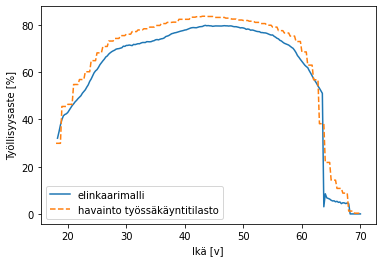

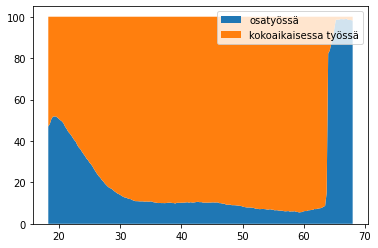

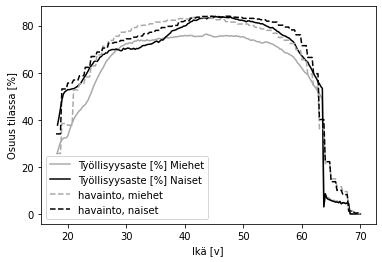

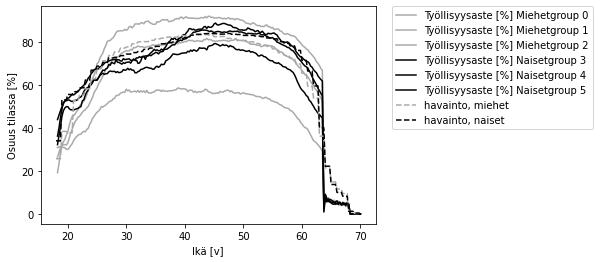

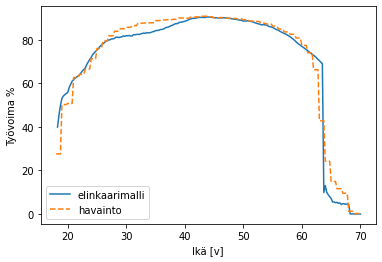

Tilaan 0 menetetty palkkasumma 3,456,105,538.51 ja työpanoksen arvo 7,257,821,630.88
Tilan 1 palkkasumma 78,086,040,101.29 ja työpanoksen arvo 163,980,684,212.71
Tilaan 2 menetetty palkkasumma 8,353,446,628.32 ja työpanoksen arvo 17,542,237,919.47
Tilaan 3 menetetty palkkasumma 3,416,414,382.22 ja työpanoksen arvo 7,174,470,202.67
Tilaan 4 menetetty palkkasumma 179,682,981.03 ja työpanoksen arvo 377,334,260.16
Tilaan 5 menetetty palkkasumma 1,148,421,144.11 ja työpanoksen arvo 2,411,684,402.64
Tilaan 6 menetetty palkkasumma 166,384,753.61 ja työpanoksen arvo 349,407,982.58
Tilaan 7 menetetty palkkasumma 1,162,978,786.61 ja työpanoksen arvo 2,442,255,451.87
Tilan 8 palkkasumma 249,668,100.16 ja työpanoksen arvo 524,303,010.33
Tilan 9 palkkasumma 8,306,496.14 ja työpanoksen arvo 17,443,641.90
Tilan 10 palkkasumma 5,190,475,910.04 ja työpanoksen arvo 10,899,999,411.09
Tilaan 11 menetetty palkkasumma 1,096,385,258.46 ja työpanoksen arvo 2,302,409,042.76
Tilaan 12 menetetty palkkasumma 4,97

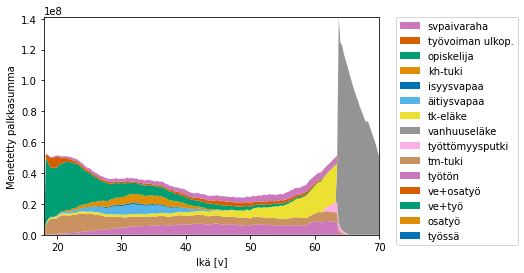

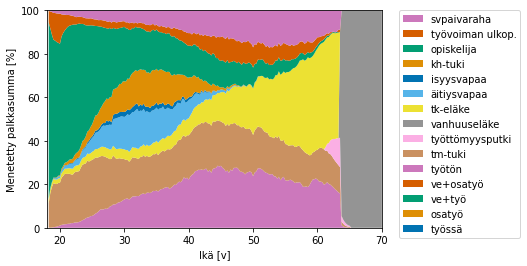

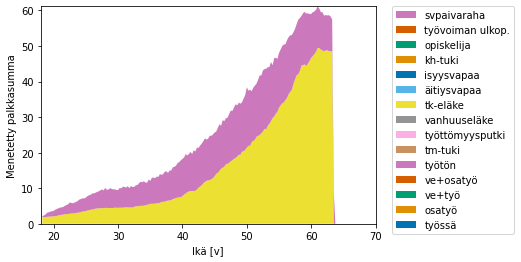

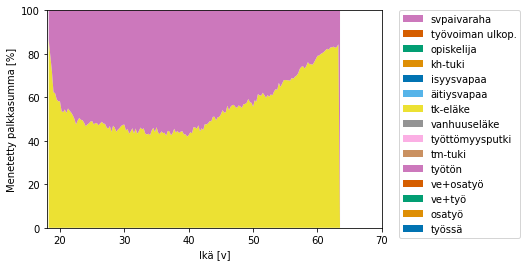

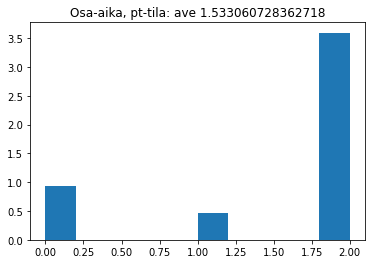

...

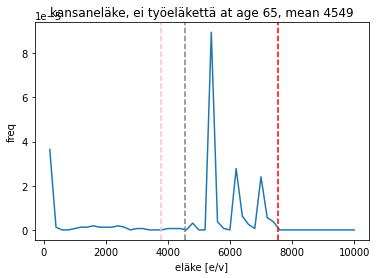

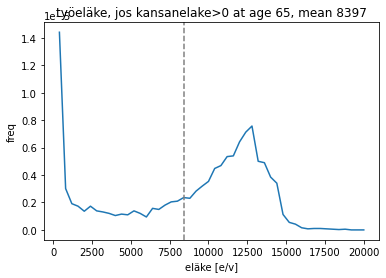

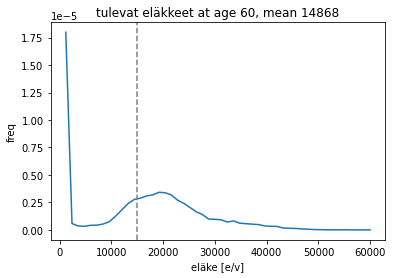

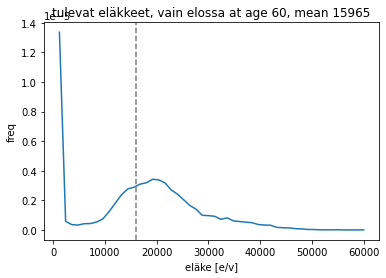

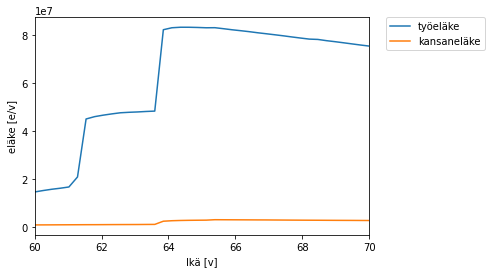

työeläkemeno alle 63: 2997256659.58 vs tilasto 1807.10
työeläkemeno yli 63: 24130052360.04 vs tilasto 24227.20
kansaneläkemeno alle 63: 384634492.01 vs tilasto 679.60
kansaneläkemeno yli 63: 841967935.65 vs tilasto 1419.90


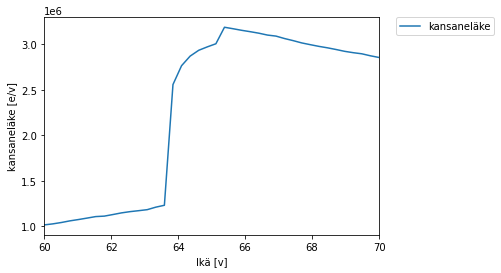

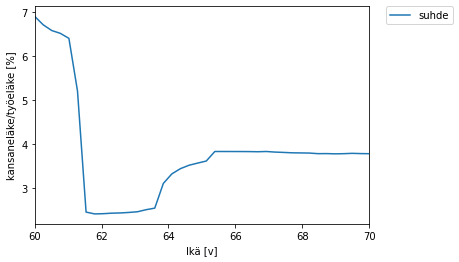

Työkyvyttömyyseläkkeisiin menetetty palkkasumma 3,416,414,382.22 ja työpanoksen arvo 7,276,962,634.13


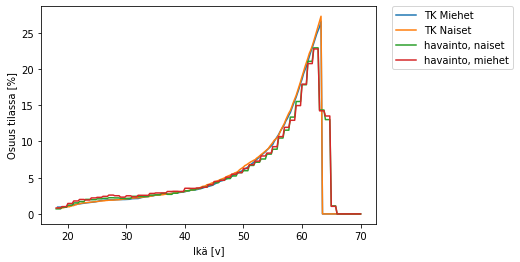

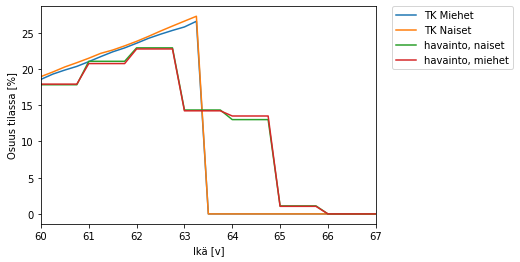

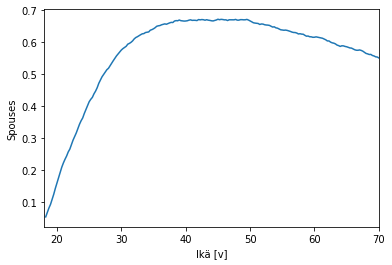

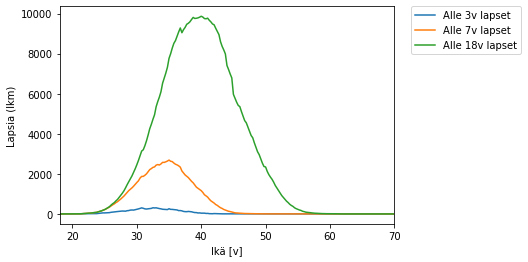

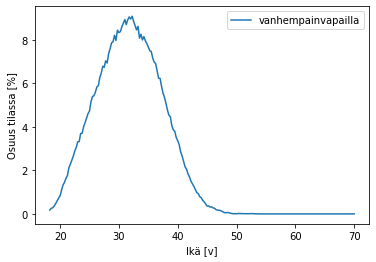

...

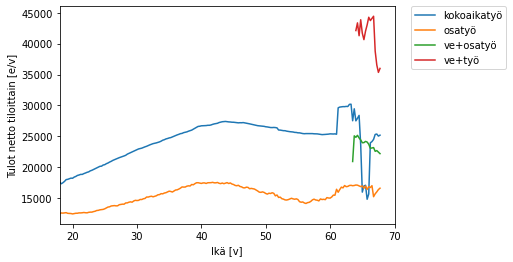

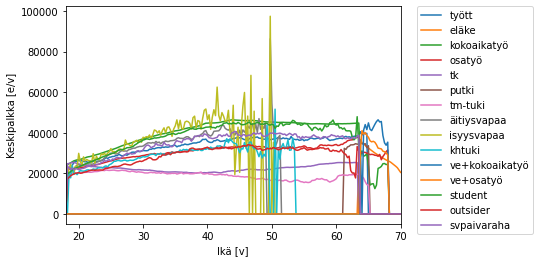

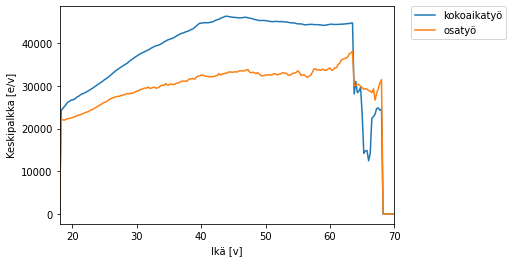

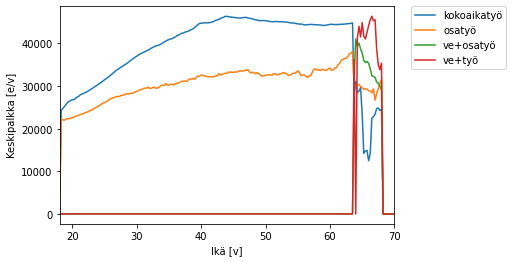

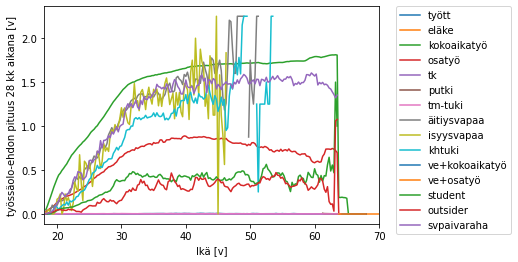

Keskikestot käytettyjen ansiosidonnaisten päivärahojen mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.50 |      0.33 |       0.17 |      0.00 |        0.00 |
| 30-39 |     0.48 |      0.32 |       0.20 |      0.00 |        0.00 |
| 40-49 |     0.49 |      0.31 |       0.20 |      0.00 |        0.00 |
| 50-59 |     0.50 |      0.31 |       0.19 |      0.00 |        0.00 |
| 60-65 |     0.21 |      0.20 |       0.19 |      0.16 |        0.25 |
+-------+----------+-----------+------------+-----------+-------------+
Keskikestot viimeisimmän työttömyysjakson mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.91 |     

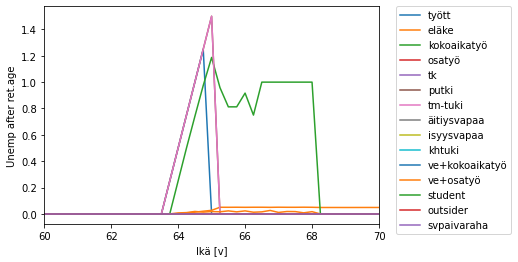

Lisäpäivillä on 6628 henkilöä


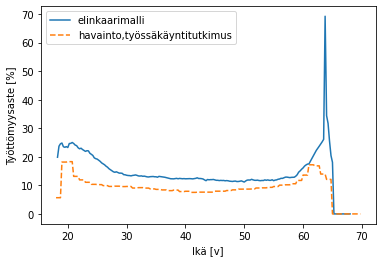

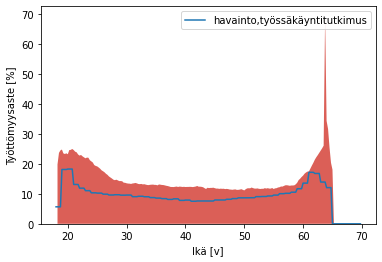

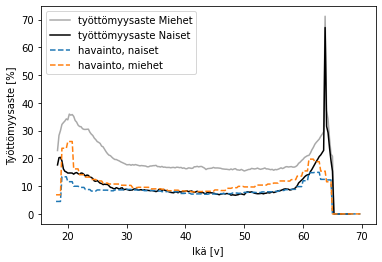

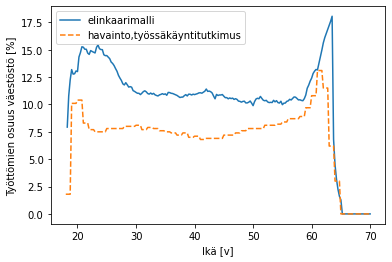

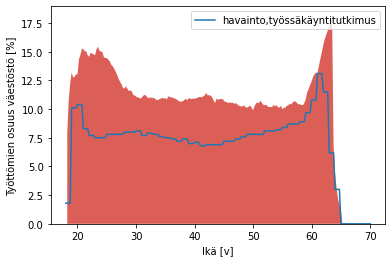

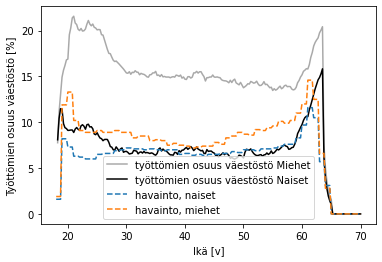

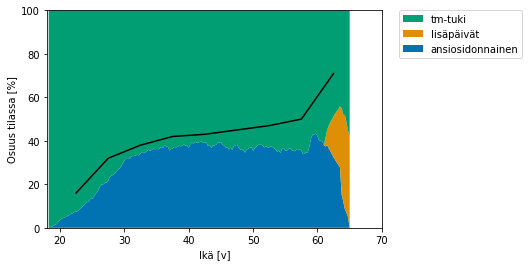

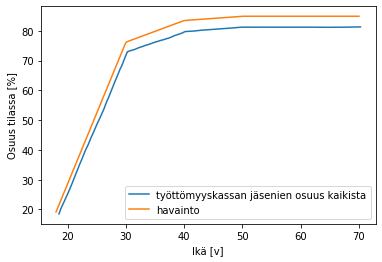

Kassanjäseniä min 18.511851 % max 81.285858 %


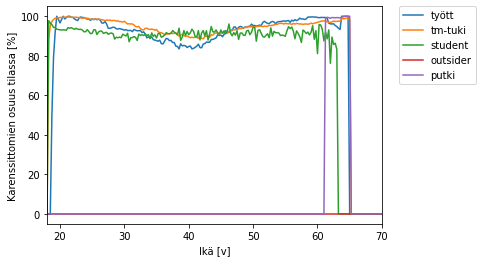

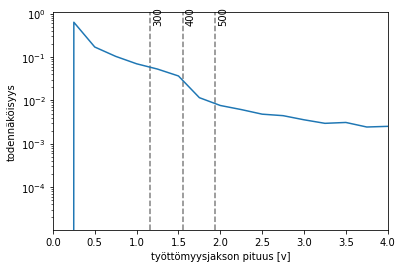

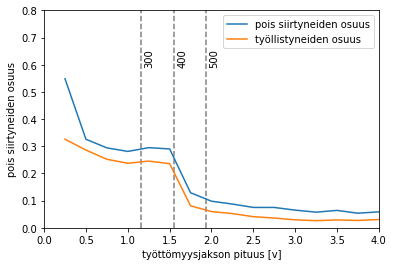

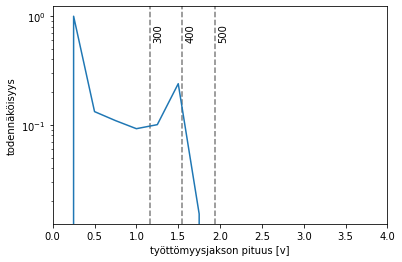

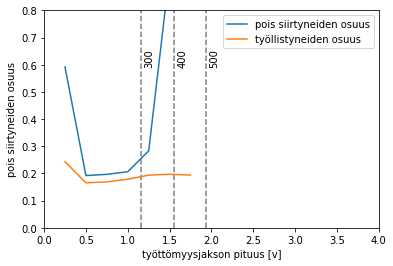

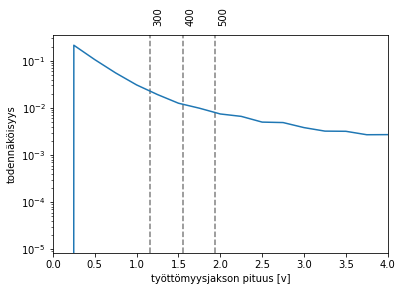

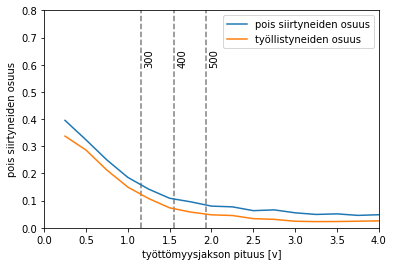

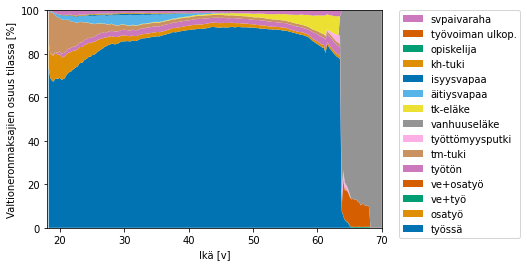

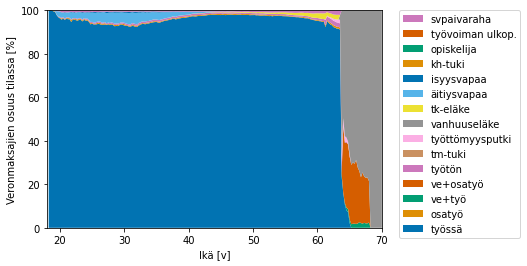

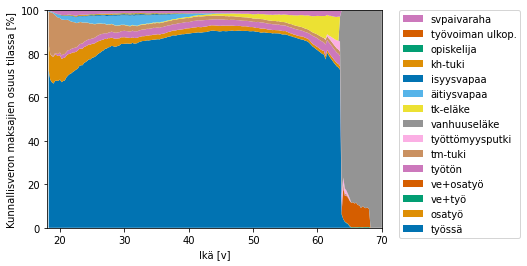

Valtionveron maksajien osuus
Etuudella olevat 2.37
Työssä 89.95
Eläkkeellä 7.48

Kunnallisveron maksajien osuus
Etuudella olevat 6.35
Työssä 71.73
Eläkkeellä 21.06

Veronmaksajien osuus
Etuudella olevat 5.65
Työssä 74.93
Eläkkeellä 18.67



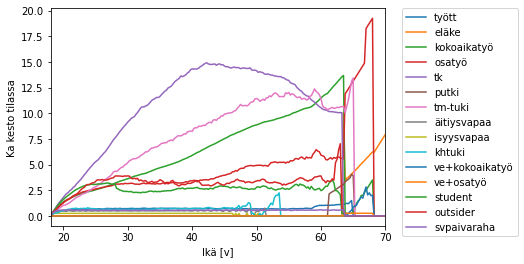

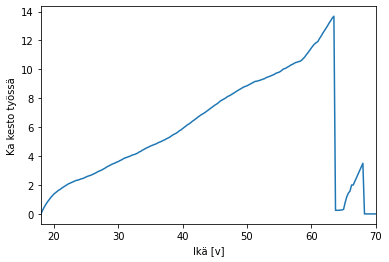

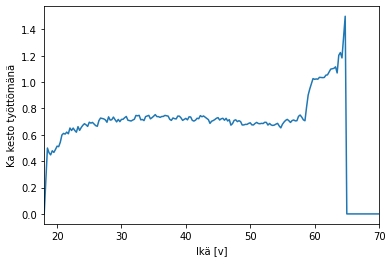

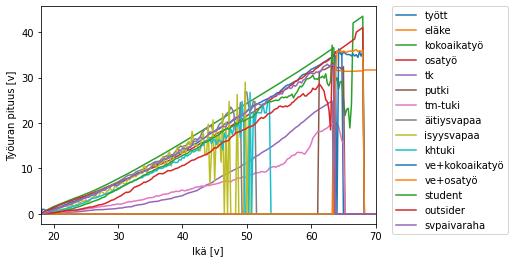

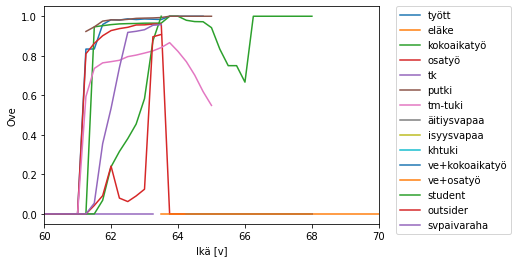

...

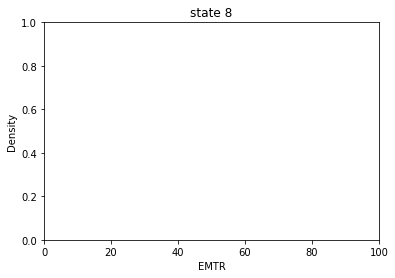

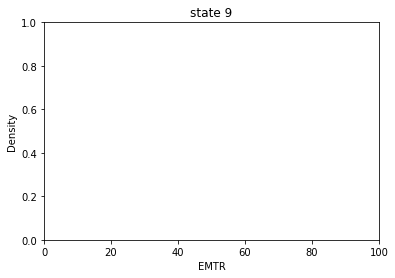

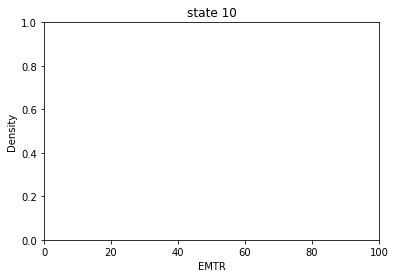

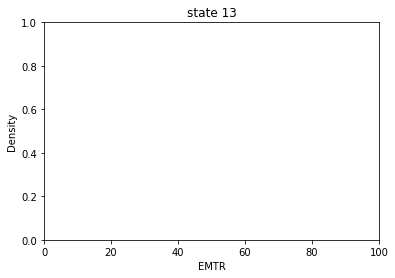

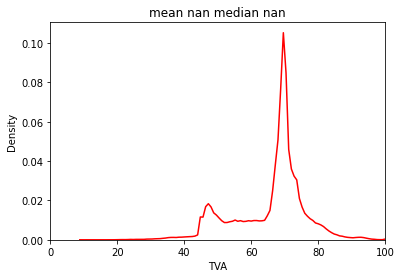

kaikki: työttömyysloukussa (80 %) 0.0


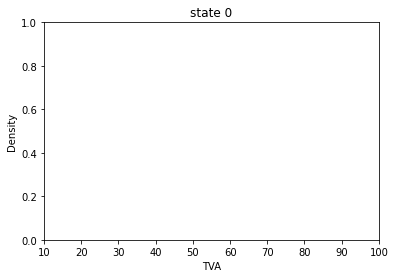

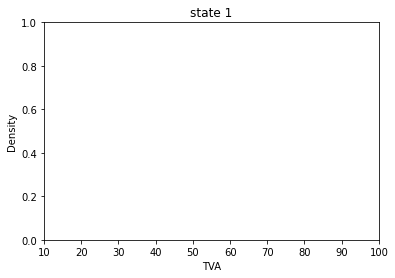

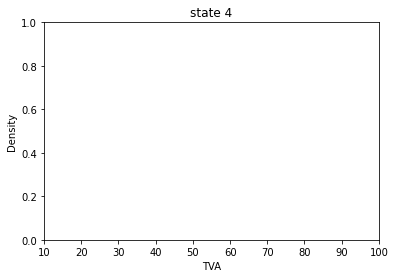

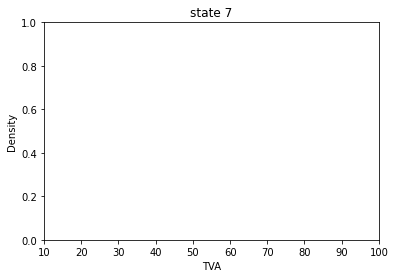

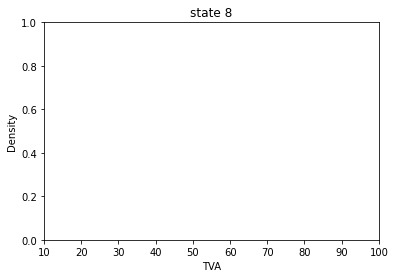

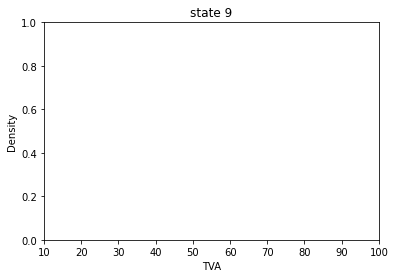

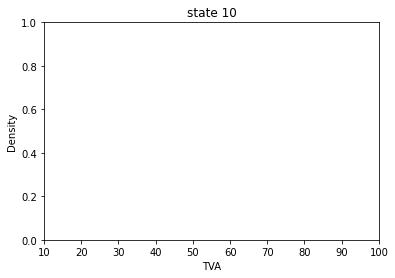

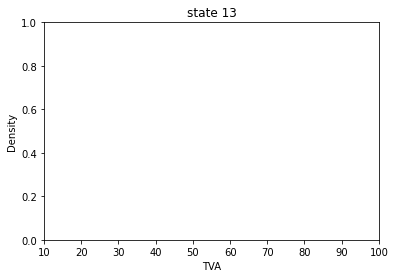

0: työttömyysloukussa (80 %) 0.0
1: työttömyysloukussa (80 %) 0.0
4: työttömyysloukussa (80 %) 0.0
7: työttömyysloukussa (80 %) 0.0
8: työttömyysloukussa (80 %) 0.0
9: työttömyysloukussa (80 %) 0.0
10: työttömyysloukussa (80 %) 0.0
13: työttömyysloukussa (80 %) 0.0


In [11]:
cc1=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,include_ove=True,
              plotdebug=plotdebug,year=2018)
cc1.load_sim(results2018)

cc1.render(figname='2018_',grayscale=False)

In [12]:
#cc1=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
#              plotdebug=plotdebug,year=2018)
#cc1.load_sim(results2018)
#cc1.plotstats.plot_emtr(figname='base')

Mortality included, not stopped
disability rate from year 2018
student year 2018
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.5
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_malli_res_mort_yesove version 5


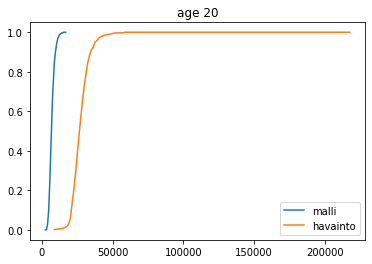

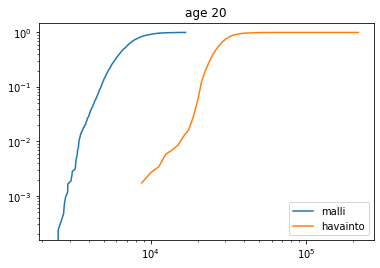

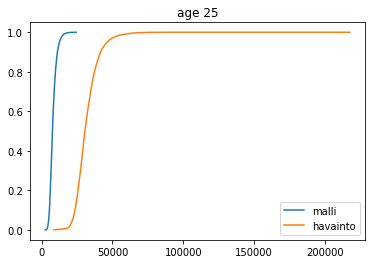

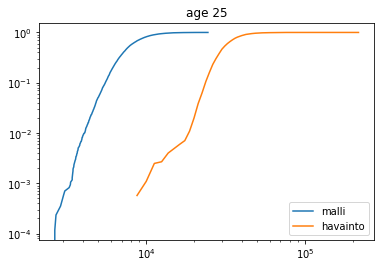

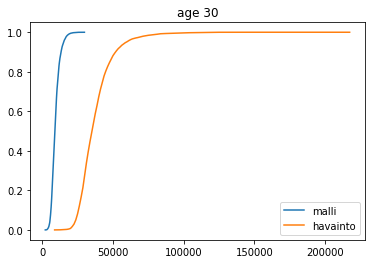

...

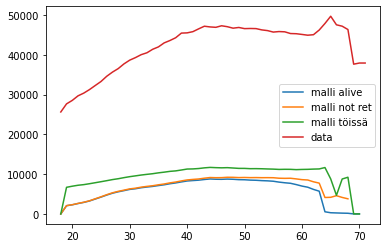

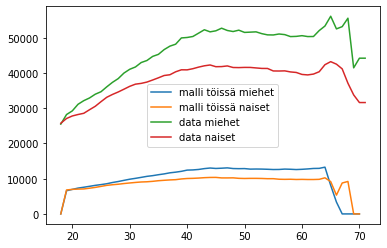

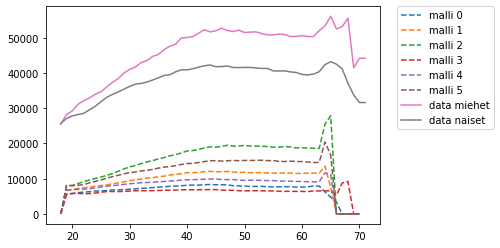

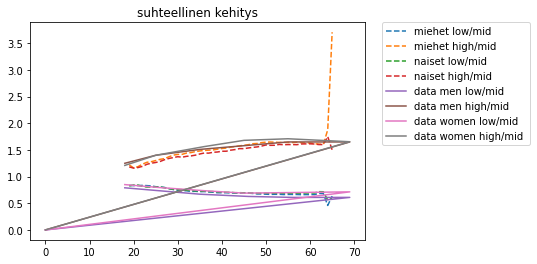

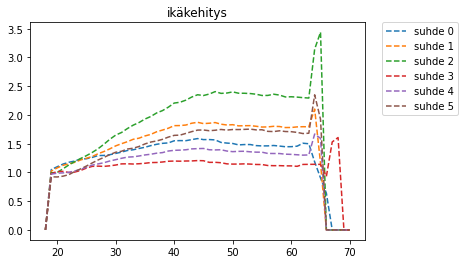

In [13]:
cc1=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
              plotdebug=plotdebug,year=2018)
cc1.load_sim(results2018)
cc1.plotstats.test_salaries()
del cc1

In [14]:
#cc1=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,include_ove=True,
#              plotdebug=plotdebug,year=year)
#cc1.load_sim(perusresults)
#cc1.plotstats.test_emtr()

In [15]:
cc1=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
              plotdebug=plotdebug,year=2018)
cc1.load_sim(results2018)
#cc1.plotstats.plot_irr()
del cc1

Mortality included, not stopped
disability rate from year 2018
student year 2018
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.5
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_malli_res_mort_yesove version 5


In [16]:
import numpy as np
import numpy.ma as ma

mask1=np.array([1,0,0])
mask2=np.array([0,0,1])
a=ma.array([1,2,3],mask=mask1+mask2)
a


masked_array(data=[--, 2, --],
             mask=[ True, False,  True],
       fill_value=999999)

In [17]:
def display_person(k):
    plt.plot(-cc1.episodestats.infostats_tyelpremium[:,k])
    plt.plot(cc1.episodestats.infostats_paid_tyel_pension[:,k])
    plt.plot(cc1.episodestats.infostats_pop_tyoelake[:,k])
    print('person #',k,'paid tyel',np.sum(cc1.episodestats.infostats_paid_tyel_pension[:,k]),
          'tyoelake',np.sum(cc1.episodestats.infostats_pop_tyoelake[:,k]),
          'kansanelake',np.sum(cc1.episodestats.infostats_pop_kansanelake[:,k]))
    print(cc1.episodestats.popempstate[:,k])
    print(cc1.episodestats.infostats_pop_wage[:,k])
    print(cc1.episodestats.infostats_pop_pension[:,k])
    plt.show()
    
def display_ke(k):
    plt.plot(-cc1.episodestats.infostats_tyelpremium[:,k])
    plt.plot(cc1.episodestats.infostats_paid_tyel_pension[:,k])
    plt.plot(cc1.episodestats.infostats_pop_tyoelake[:,k])
    print('person #',k,'paid tyel',np.sum(cc1.episodestats.infostats_paid_tyel_pension[:,k]),
          'tyoelake',np.sum(cc1.episodestats.infostats_pop_tyoelake[:,k]),
          'kansanelake',np.sum(cc1.episodestats.infostats_pop_kansanelake[:,k]))
    print(cc1.episodestats.infostats_pop_kansanelake[100:,k])
    print(cc1.episodestats.infostats_pop_tyoelake[100:,k])
    plt.show()    

def test_irr_pop():    
    infostats_irr_tyel_full=np.zeros((cc1.episodestats.n_pop,1))
    infostats_irr_tyel_reduced=np.zeros((cc1.episodestats.n_pop,1))
    np.set_printoptions(precision=0)
    for k in range(cc1.episodestats.n_pop):
        # tyel-eläke ilman vähennyksiä
        #infostats_irr_tyel_full[k]=cc1.episodestats.reaalinen_palkkojenkasvu*100+cc1.episodestats.comp_annual_irr(cc1.episodestats.infostats_npv0[k,0],cc1.episodestats.infostats_tyelpremium[:,k],cc1.episodestats.infostats_pop_tyoelake[:,k],cc1.episodestats.popempstate[:,k])
        # tyel-eläke ml. muiden eläkkeiden vähenteisyys
        infostats_irr_tyel_reduced[k]=cc1.episodestats.reaalinen_palkkojenkasvu*100+cc1.episodestats.comp_annual_irr(cc1.episodestats.infostats_npv0[k,0],cc1.episodestats.infostats_tyelpremium[:,k],cc1.episodestats.infostats_paid_tyel_pension[:,k],cc1.episodestats.popempstate[:,k])
        if not np.isfinite(infostats_irr_tyel_reduced[k]):
            display_person(k)

def test_pop():    
    infostats_irr_tyel_full=np.zeros((cc1.episodestats.n_pop,1))
    infostats_irr_tyel_reduced=np.zeros((cc1.episodestats.n_pop,1))
    np.set_printoptions(precision=0)
    for k in range(cc1.episodestats.n_pop):
        if cc1.episodestats.popempstate[-1,k]==0:
            display_person(k)
            display_person(k-1)
            
def test_ke():
    for k in range(cc1.episodestats.n_pop):
        if np.sum(cc1.episodestats.infostats_pop_kansanelake[:,k])>0:
            display_ke(k)

    

In [18]:
cc1=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,include_ove=True,
              plotdebug=plotdebug,year=2018)
cc1.load_sim(results2018)
cc1.episodestats.comp_potential_palkkasumma(grouped=True)

Mortality included, not stopped
disability rate from year 2018
student year 2018
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.5
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_malli_res_mort_yesove version 5


array([3.45610554e+09, 7.80860401e+10, 8.35344663e+09, 3.41641438e+09,
       1.79682981e+08, 1.14842114e+09, 1.66384754e+08, 1.16297879e+09,
       2.49668100e+08, 8.30649614e+06, 5.19047591e+09, 1.09638526e+09,
       4.97599696e+09, 4.16540339e+09, 1.87741823e+09])

In [19]:
cc1.episodestats.comp_palkkasumma(grouped=True)
del cc1

# 2019

In [20]:
cc2019=Lifecycle(env=model,mortality=mortality,perustulo=False,include_putki=True,library=library,
              plotdebug=plotdebug,year=2019,include_ove=include_ove,unemp_limit_reemp=unemp_limit_reemp,
              silent=False,include_emtr=include_emtr)

Mortality included, not stopped
disability rate from year 2019
student year 2019
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.75
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400



In [21]:
if run2019:
    pop_size=1000
    malli2019=malli2018
    cc2019.run_results(debug=debug,steps1=size1,steps2=size2,pop=pop_size,deterministic=deterministic,
                    train=False,predict=True,batch1=batch1,batch2=batch2,gae_lambda=gae_lambda,
                    learning_rate=learning_rate,learning_schedule=schedule,
                    save=malli2019,cont=cont,start_from=malli2019,results=results2019,
                    callback_minsteps=callback_minsteps,rlmodel=rlmodel,twostage=twostage,
                    log_interval=500)

Loading results from results/v5_perus_2019 version 5


Ave net income 21,470.03 Ave equivalent net income 16,403.80
Rahavirrat skaalattuna väestötasolle
+---------------------------+-----------------------+--------------------+-------------------+
|                           |                   e/v |            toteuma |               ero |
|---------------------------+-----------------------+--------------------+-------------------|
| tyotulosumma              |  93,633,167,492.90    |  92,354,100,000.00 |  1,279,067,492.90 |
| tyotulosumma eielakkeella |  90,611,673,379.94    |                nan |               nan |
| etuusmeno                 |  41,061,654,916.77    |  40,648,151,607.00 |    413,503,309.77 |
| verot+maksut              |  34,301,235,607.76    |  35,071,527,900.00 |   -770,292,292.24 |
| verot+maksut+alv          |  51,338,739,502.00    |  53,857,527,900.00 | -2,518,788,398.00 |
| palkkaverot+maksut        |  27,127,361,236.53    |                nan |               nan |
| muut tulot                | -10,277,084,585.2


Sic! Työllisyysaste vastaa työvoimatilaston laskutapaa!
Työllisyysaste 18-64: 69.79%
Gini coefficient is 26.453 (havainto 27.900)

Sic! pienituloisuus lasketaan vain aikuisväestöstä!
Pienituloisuus 50%: 15.31%; 60%: 20.17%; abs 1000 e/kk 20.21%


Real discounted reward 13.536884127479976
Initial discounted reward 11.109304660339067


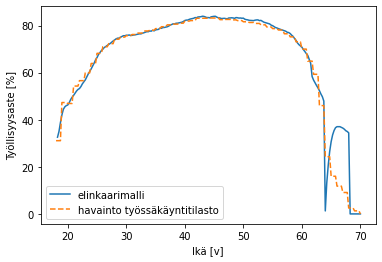

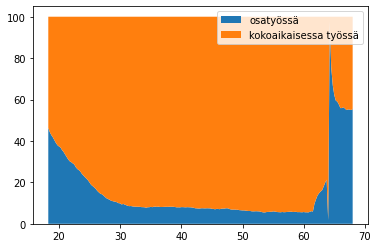

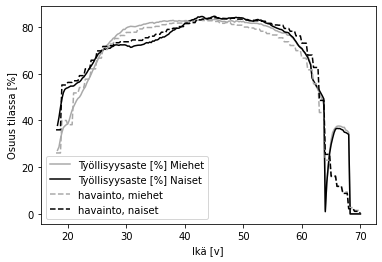

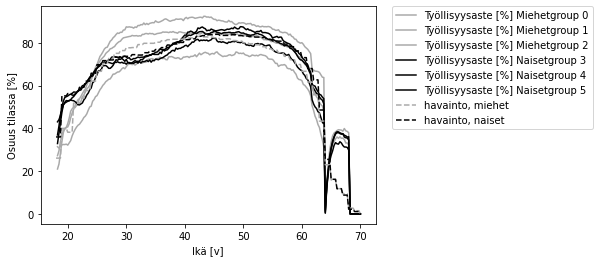

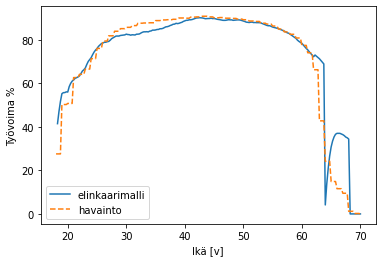

Tilaan 0 menetetty palkkasumma 3,994,485,852.64 ja työpanoksen arvo 8,388,420,290.55
Tilan 1 palkkasumma 86,190,678,830.74 ja työpanoksen arvo 181,000,425,544.55
Tilaan 2 menetetty palkkasumma 7,266,124,553.22 ja työpanoksen arvo 15,258,861,561.77
Tilaan 3 menetetty palkkasumma 3,531,870,955.44 ja työpanoksen arvo 7,416,929,006.42
Tilaan 4 menetetty palkkasumma 153,599,518.67 ja työpanoksen arvo 322,558,989.21
Tilaan 5 menetetty palkkasumma 1,138,130,827.07 ja työpanoksen arvo 2,390,074,736.86
Tilaan 6 menetetty palkkasumma 172,511,284.57 ja työpanoksen arvo 362,273,697.59
Tilaan 7 menetetty palkkasumma 996,796,054.73 ja työpanoksen arvo 2,093,271,714.93
Tilan 8 palkkasumma 1,203,943,545.82 ja työpanoksen arvo 2,528,281,446.23
Tilan 9 palkkasumma 1,817,550,567.14 ja työpanoksen arvo 3,816,856,190.99
Tilan 10 palkkasumma 4,420,994,549.21 ja työpanoksen arvo 9,284,088,553.33
Tilaan 11 menetetty palkkasumma 1,376,577,194.53 ja työpanoksen arvo 2,890,812,108.51
Tilaan 12 menetetty palkkasu

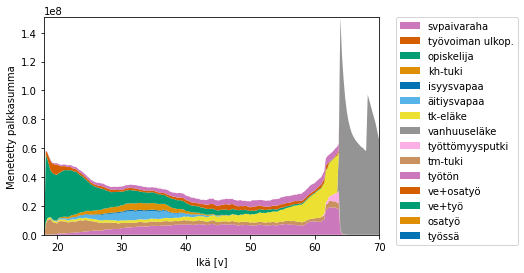

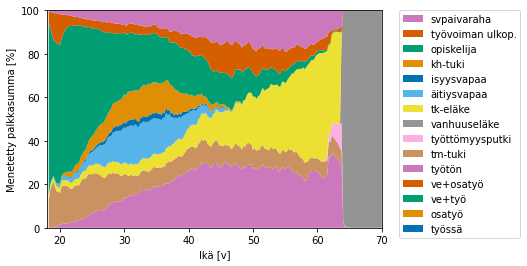

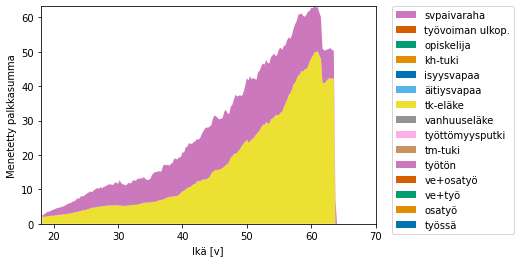

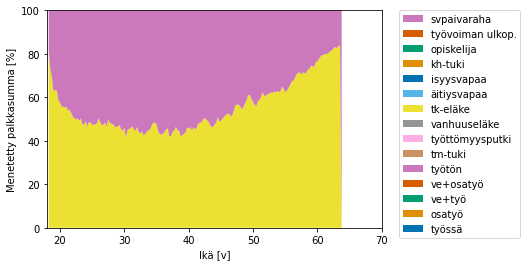

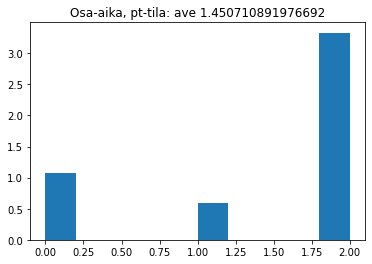

...

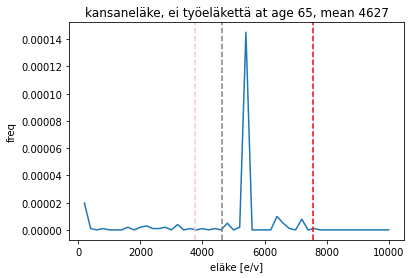

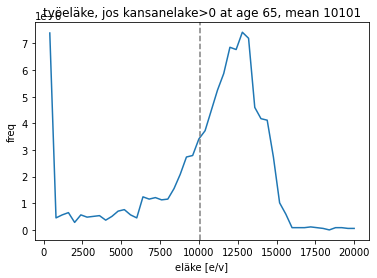

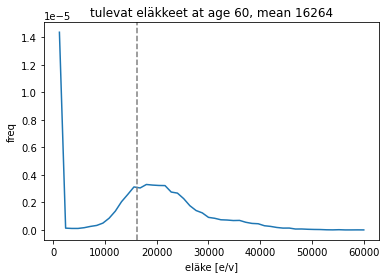

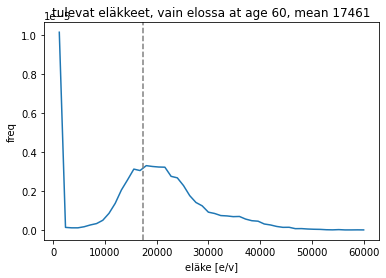

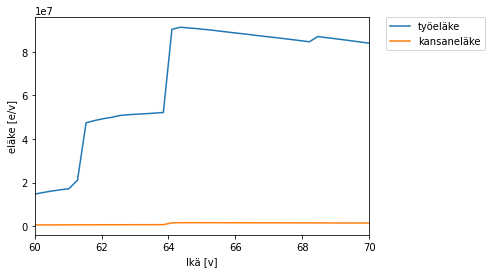

työeläkemeno alle 63: 3102412766.64 vs tilasto 1807.10
työeläkemeno yli 63: 25851478349.24 vs tilasto 24227.20
kansaneläkemeno alle 63: 314538522.46 vs tilasto 679.60
kansaneläkemeno yli 63: 436292927.87 vs tilasto 1419.90


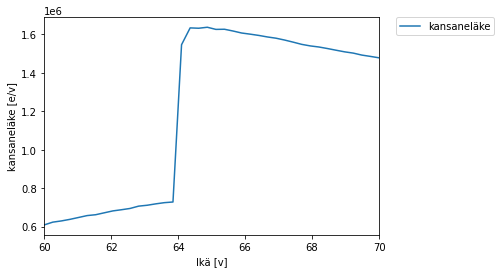

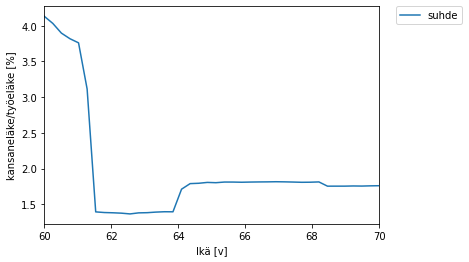

Työkyvyttömyyseläkkeisiin menetetty palkkasumma 3,531,870,955.44 ja työpanoksen arvo 7,522,885,135.08


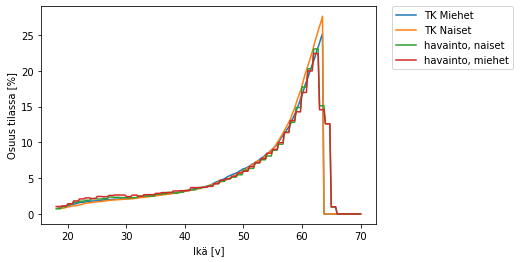

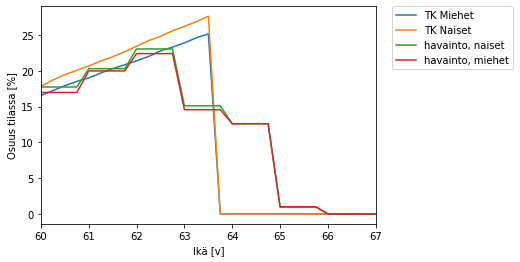

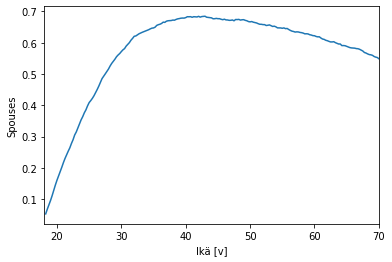

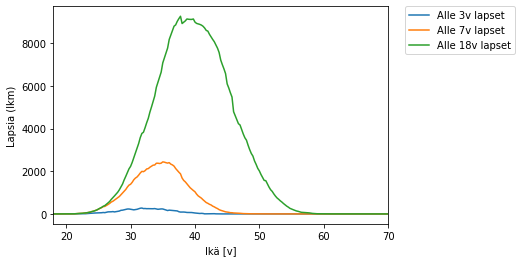

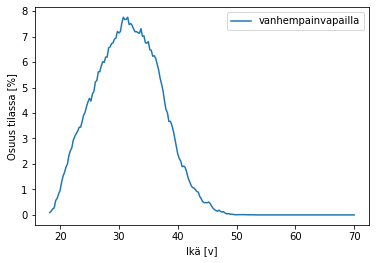

...

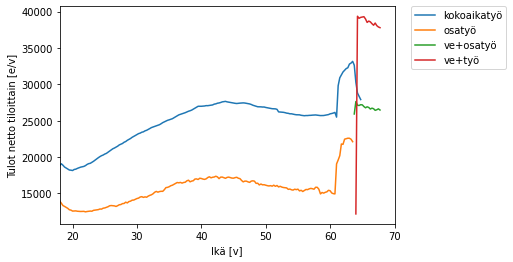

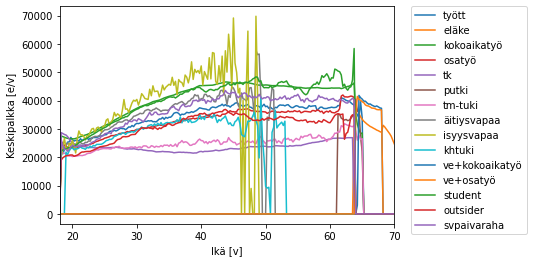

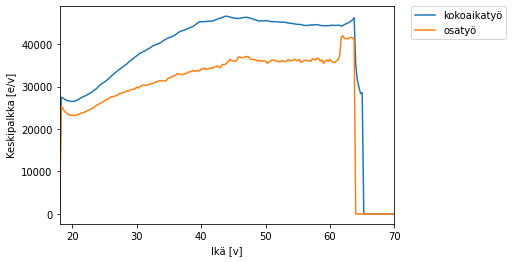

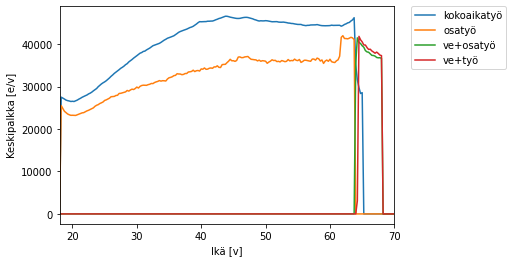

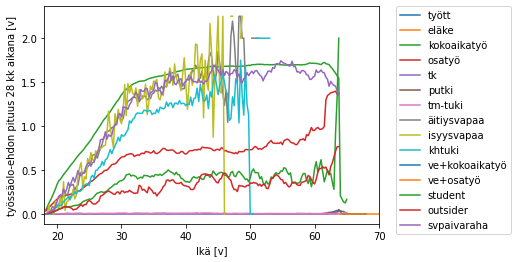

Keskikestot käytettyjen ansiosidonnaisten päivärahojen mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.56 |      0.32 |       0.12 |      0.00 |        0.00 |
| 30-39 |     0.54 |      0.31 |       0.15 |      0.00 |        0.00 |
| 40-49 |     0.54 |      0.31 |       0.15 |      0.00 |        0.00 |
| 50-59 |     0.53 |      0.32 |       0.15 |      0.00 |        0.00 |
| 60-65 |     0.34 |      0.22 |       0.18 |      0.12 |        0.14 |
+-------+----------+-----------+------------+-----------+-------------+
Keskikestot viimeisimmän työttömyysjakson mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.91 |     

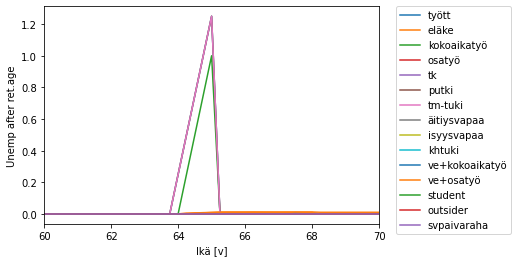

Lisäpäivillä on 5819 henkilöä


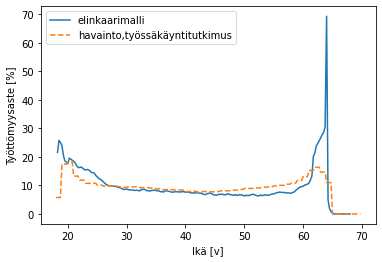

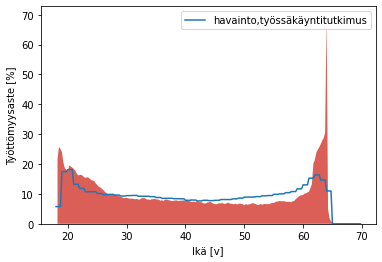

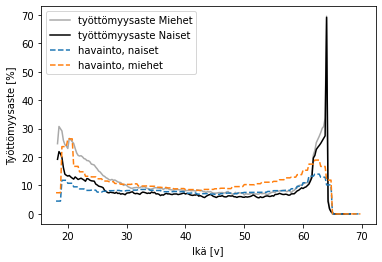

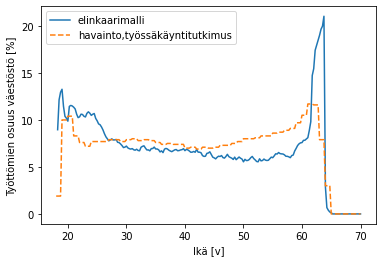

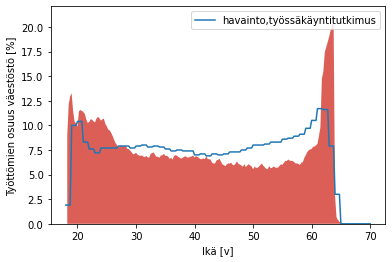

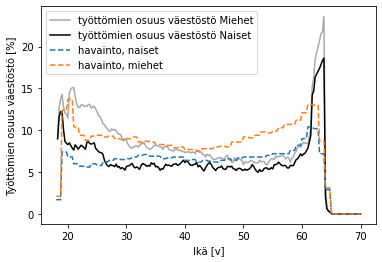

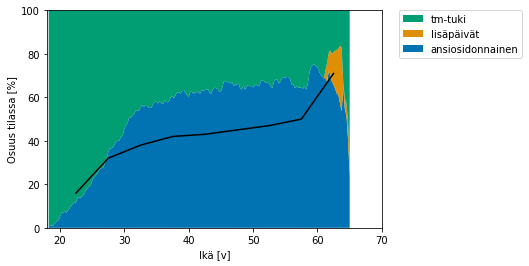

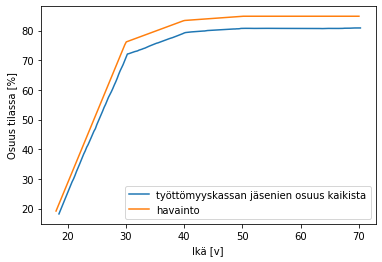

Kassanjäseniä min 18.210000 % max 80.914057 %


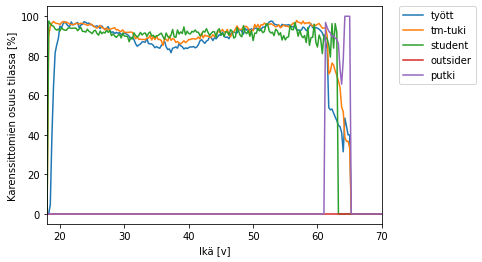

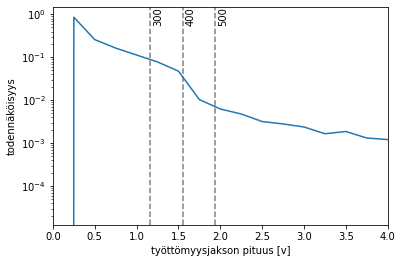

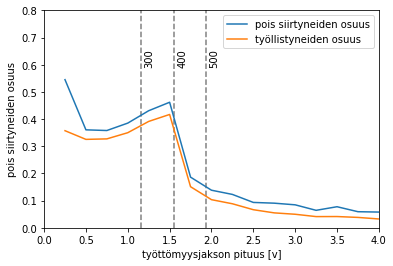

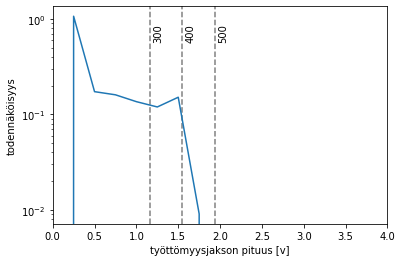

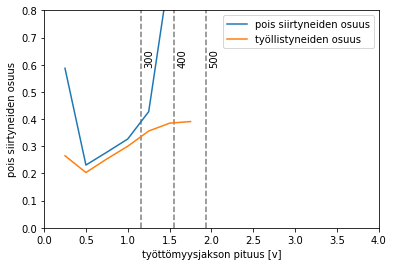

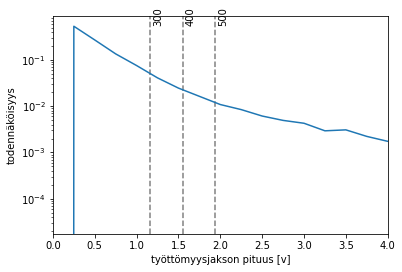

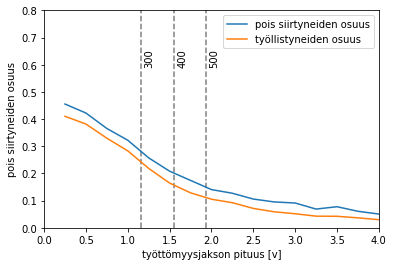

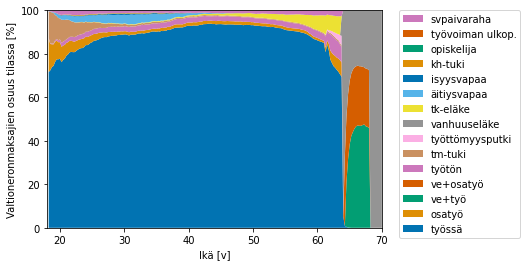

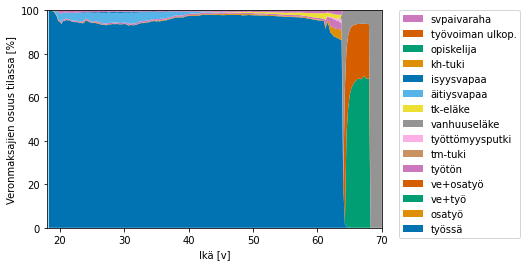

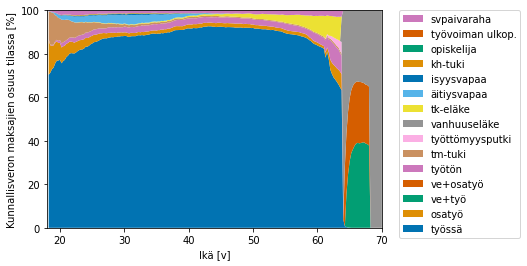

Valtionveron maksajien osuus
Etuudella olevat 11.19
Työssä 81.32
Eläkkeellä 16.29

Kunnallisveron maksajien osuus
Etuudella olevat 8.64
Työssä 70.27
Eläkkeellä 23.93

Veronmaksajien osuus
Etuudella olevat 9.11
Työssä 72.28
Eläkkeellä 22.54



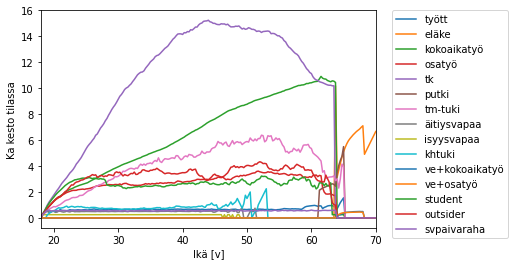

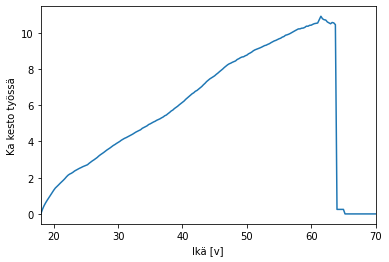

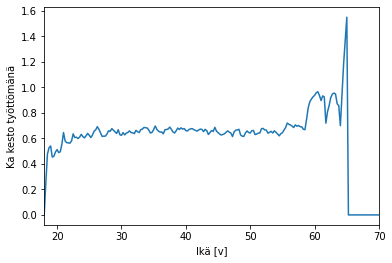

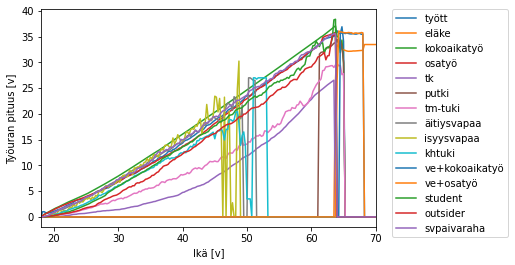

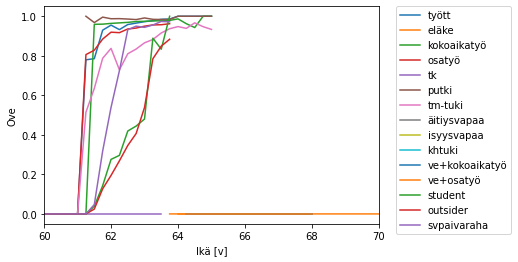

...

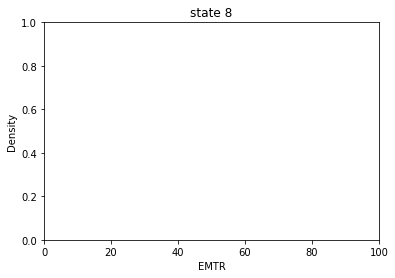

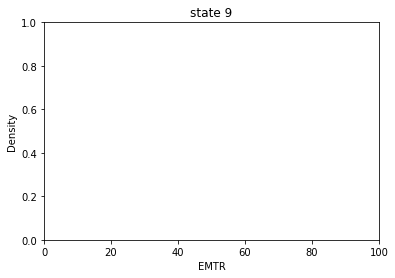

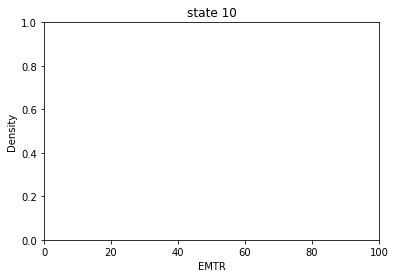

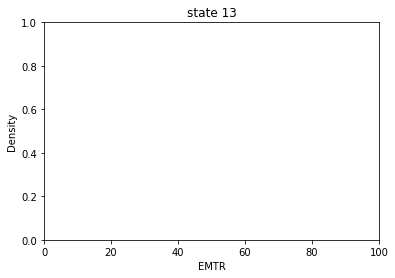

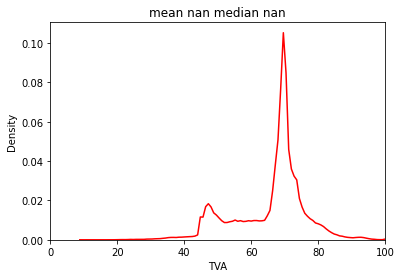

kaikki: työttömyysloukussa (80 %) 0.0


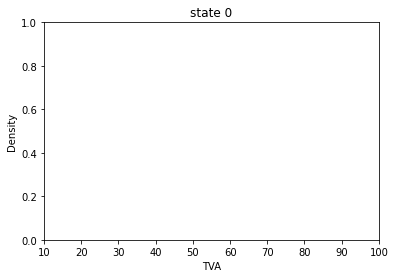

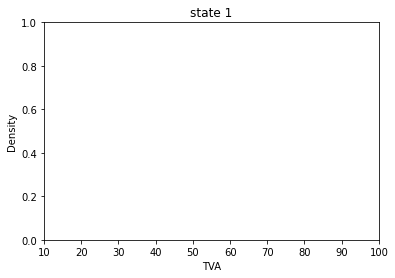

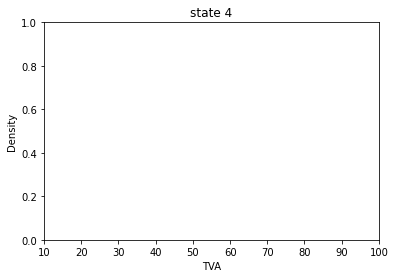

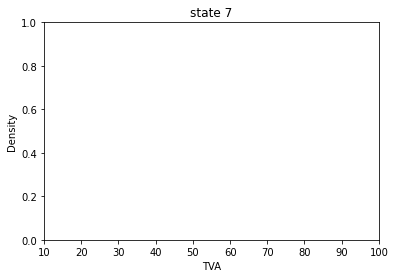

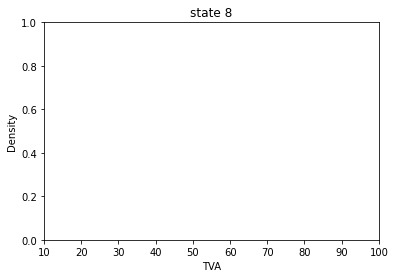

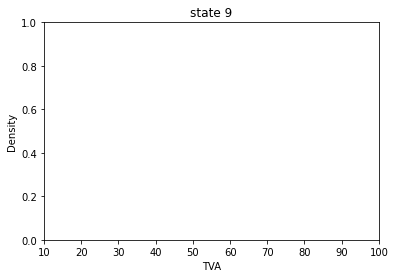

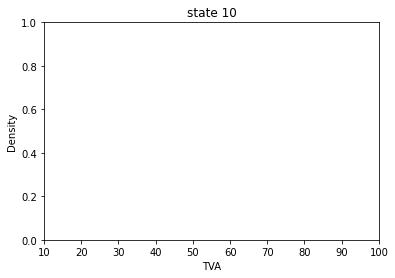

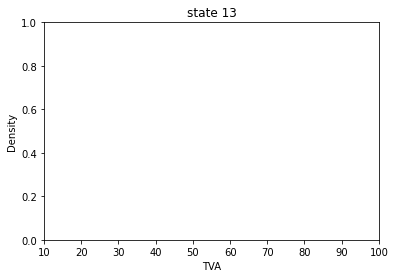

0: työttömyysloukussa (80 %) 0.0
1: työttömyysloukussa (80 %) 0.0
4: työttömyysloukussa (80 %) 0.0
7: työttömyysloukussa (80 %) 0.0
8: työttömyysloukussa (80 %) 0.0
9: työttömyysloukussa (80 %) 0.0
10: työttömyysloukussa (80 %) 0.0
13: työttömyysloukussa (80 %) 0.0


In [22]:
cc2019.load_sim(results2019)
cc2019.render(figname='images/2019_')

Mortality included, not stopped
disability rate from year 2018
student year 2018
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.5
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_malli_res_mort_yesove version 5
2019 reward 13.536884127479976 netincome 21470.03 eq 16403.797 initial 11.109304660339067
2018 reward 13.478871985050107 netincome 20183.15 eq 16209.374 initial 11.088790940307772
Rahavirrat skaalattuna väestötasolle
+---------------------------+-----------------------+----------------------+----------------------+
|         

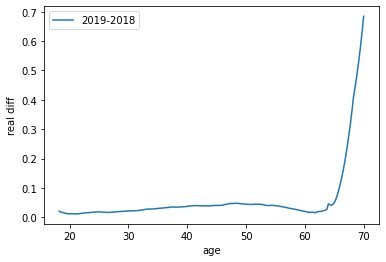

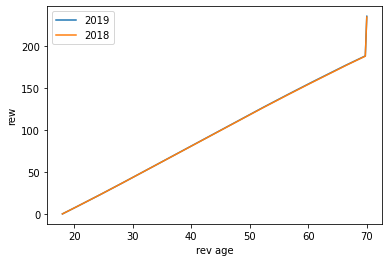

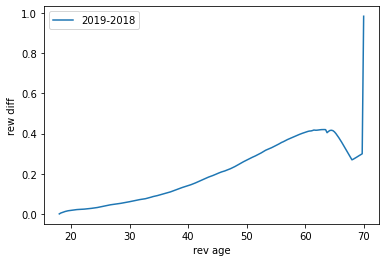

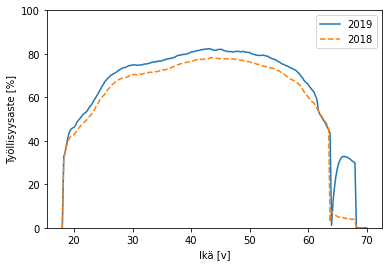

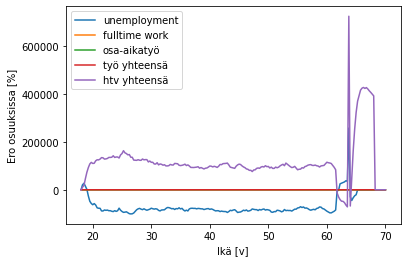

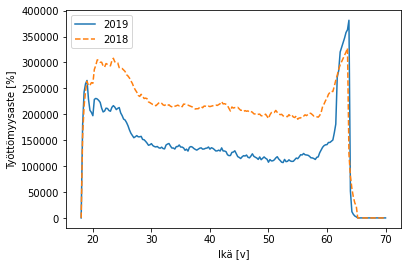

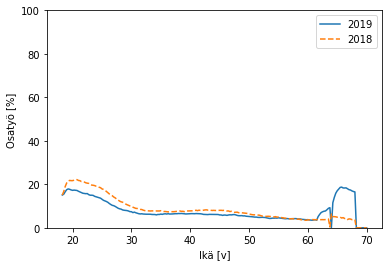

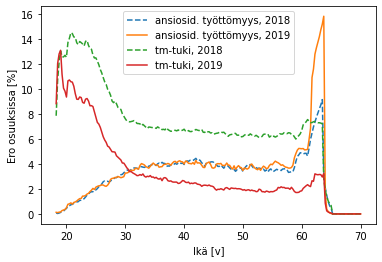

Työllisyysvaikutus 21-60-vuotiaisiin noin 144950 htv ja 119610 työllistä
- kokoaikaisiin 21-60-vuotiailla noin 170289 työllistä (1853929 vs 1683640)
- osa-aikaisiin 21-60-vuotiailla noin -50679 työllistä (191576 vs 242255)
Työllisiä 1949717 vs 1804768 htv
Työllisyysastevaikutus 21-60-vuotiailla noin 4.39 prosenttia (75.09 vs 70.70)
- kokoaikaisiin 21-60-vuotiailla noin 3.21 prosenttia (90.63 vs 87.42)
- osa-aikaisiin 21-60-vuotiailla noin -3.21 prosenttia (9.37 vs 12.58)
Työttömyysvaikutus 21-60-vuotiaisiin noin -120900 htv
- ansiosidonnaiseen 21-60-vuotiailla noin 12581 htv (119615 vs 107034)
- tm-tukeen 21-60-vuotiailla noin -132757 työllistä (117845 vs 250602)
- putkeen 21-60-vuotiailla noin -724 työllistä (5310 vs 6034)
epävarmuus työllisyysasteissa 0.0139, hajonta 0.0744


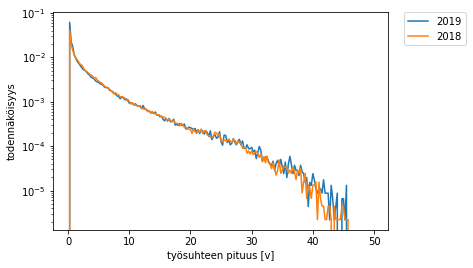

Jakauma ansiosidonnainen+tmtuki+putki, no max age
2019 keskikesto 0.7042621738671173 v 2018 keskikesto 1.1813276149806116 v
Skaalaamaton 2019 lkm 94670 v 2018 lkm 81492 v
Skaalaamaton 2019 työtpäiviä yht 66672.5 v 2018 työtpäiviä yht 96268.75 v


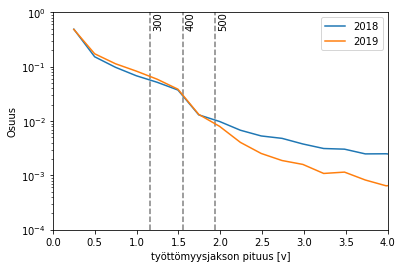

2019 keskikesto 0.7042621738671173 v 2018 keskikesto 1.1813276149806116 v
Skaalaamaton 2019 lkm 94670 v 2018 lkm 81492 v
Skaalaamaton 2019 työtpäiviä yht 66672.5 v 2018 työtpäiviä yht 96268.75 v


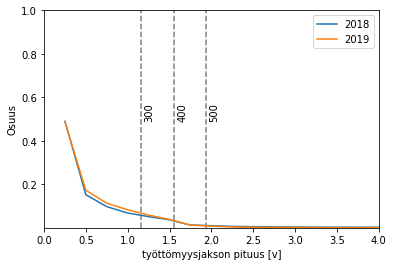

2019 keskikesto 0.7042621738671173 v 2018 keskikesto 1.1813276149806116 v
Skaalaamaton 2019 lkm 94670 v 2018 lkm 81492 v
Skaalaamaton 2019 työtpäiviä yht 66672.5 v 2018 työtpäiviä yht 96268.75 v


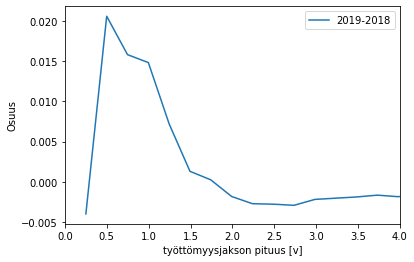

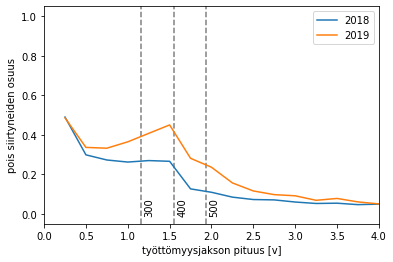

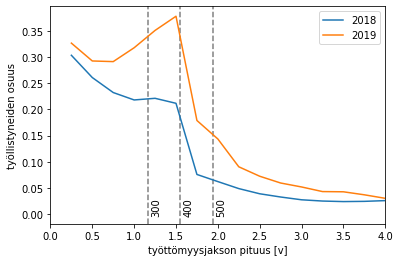

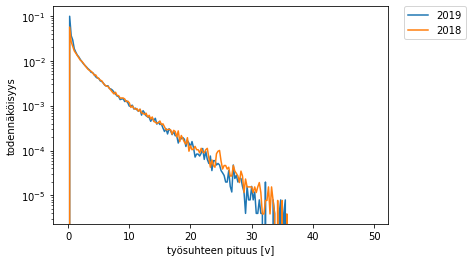

Jakauma ansiosidonnainen+tmtuki+putki, max age 54
2019 keskikesto 0.6423165774590992 v 2018 keskikesto 0.8932174097065463 v
Skaalaamaton 2019 lkm 79216 v 2018 lkm 70880 v
Skaalaamaton 2019 työtpäiviä yht 50881.75 v 2018 työtpäiviä yht 63311.25 v


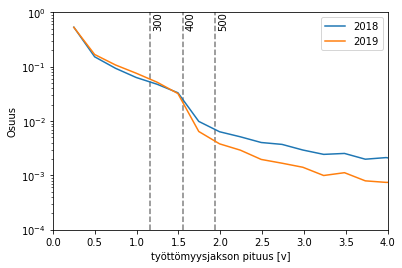

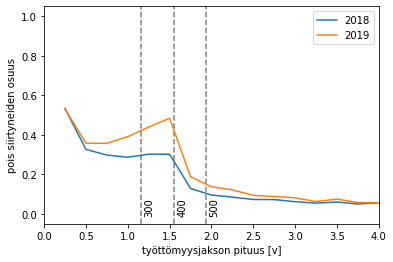

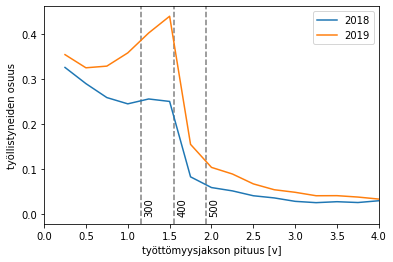

2018
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.56 |      0.32 |       0.12 |      0.00 |        0.00 |
| 30-39 |     0.54 |      0.31 |       0.15 |      0.00 |        0.00 |
| 40-49 |     0.54 |      0.31 |       0.15 |      0.00 |        0.00 |
| 50-59 |     0.53 |      0.32 |       0.15 |      0.00 |        0.00 |
| 60-65 |     0.34 |      0.22 |       0.18 |      0.12 |        0.14 |
+-------+----------+-----------+------------+-----------+-------------+
2019
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.50 |      0.33 |       0.17 |      0.00 |        0.00 |
| 30-39 |     0.48 |      0.32 |       0.20 |      0.0

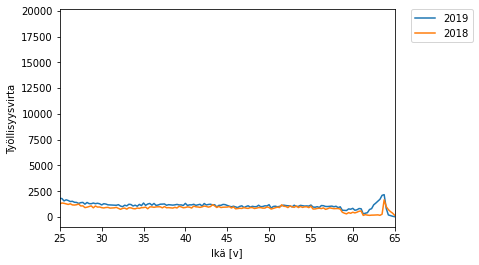

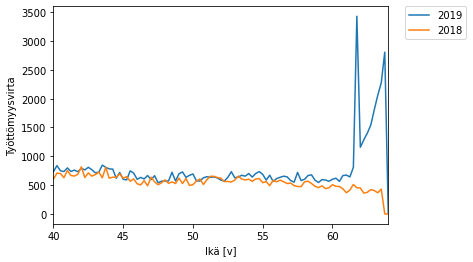

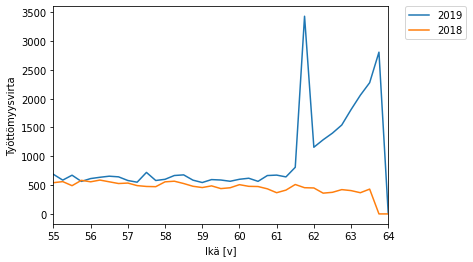

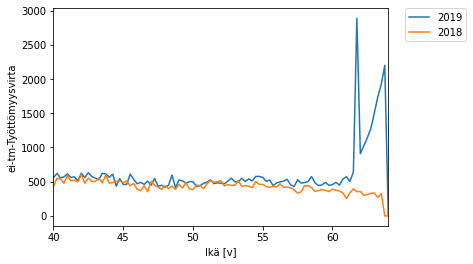

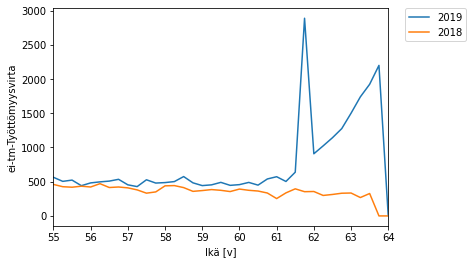

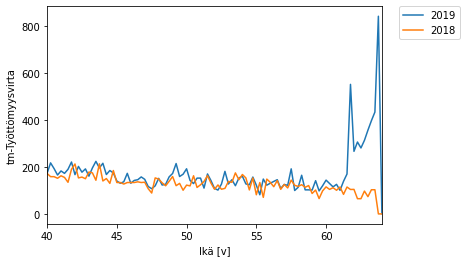

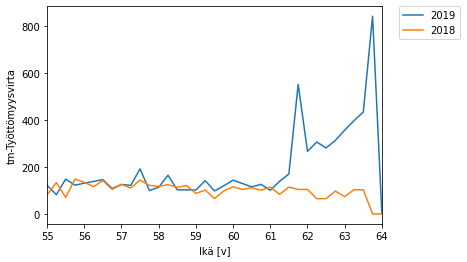

In [23]:
cc2018=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
              plotdebug=plotdebug,year=2018)
cc2018.load_sim(load=results2018)
cc2019=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
                 plotdebug=plotdebug,year=2019,include_putki=True,library=library,
                 include_ove=include_ove,unemp_limit_reemp=unemp_limit_reemp,silent=True)
cc2019.load_sim(results2019)
cc2019.compare_with(cc2018,label1='2019',label2='2018',figname='vuosivertailu')
del cc2019
del cc2018

# 2020

In [24]:
cc2020=Lifecycle(env=model,mortality=mortality,perustulo=False,include_putki=True,library=library,
                 plotdebug=plotdebug,year=2020,include_ove=include_ove,unemp_limit_reemp=unemp_limit_reemp,
                 silent=False,include_emtr=include_emtr)

Mortality included, not stopped
disability rate from year 2020
student year 2020
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 64.0
max_retirementage 69
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400



In [25]:
if run2020:
    cc2020.run_results(debug=debug,steps1=size1,steps2=size2,pop=pop_size,deterministic=deterministic,
                    train=True,predict=False,batch1=batch1,batch2=batch2,gae_lambda=gae_lambda,
                    learning_rate=learning_rate,learning_schedule=schedule,
                    save=malli2020,cont=cont,start_from=malli2020,results=results2020,
                    callback_minsteps=callback_minsteps,rlmodel=rlmodel,twostage=twostage,
                    log_interval=1000)

In [26]:
if run2020:
    cc2020.run_results(debug=debug,steps1=size1,steps2=size2,pop=pop_size,deterministic=deterministic,
                    train=False,predict=True,batch1=batch1,batch2=batch2,gae_lambda=gae_lambda,
                    learning_rate=learning_rate,learning_schedule=schedule,
                    save=malli2020,cont=cont,start_from=malli2020,results=results2020,
                    callback_minsteps=callback_minsteps,rlmodel=rlmodel,twostage=twostage,
                    log_interval=1000)

Loading results from results/v5_perus_2020 version 5


Ave net income 21,521.47 Ave equivalent net income 16,467.36
Rahavirrat skaalattuna väestötasolle
+---------------------------+----------------------+--------------------+-------------------+
|                           |                  e/v |            toteuma |               ero |
|---------------------------+----------------------+--------------------+-------------------|
| tyotulosumma              | 92,573,141,005.38    |  92,123,100,000.00 |    450,041,005.38 |
| tyotulosumma eielakkeella | 92,301,363,267.41    |                nan |               nan |
| etuusmeno                 | 43,414,769,344.56    |  42,158,615,690.00 |  1,256,153,654.56 |
| verot+maksut              | 34,630,917,122.13    |  36,497,488,900.00 | -1,866,571,777.87 |
| verot+maksut+alv          | 51,793,927,557.33    |  55,851,488,900.00 | -4,057,561,342.67 |
| palkkaverot+maksut        | 27,006,524,624.35    |                nan |               nan |
| muut tulot                | -8,379,158,212.77    | -13


Sic! Työllisyysaste vastaa työvoimatilaston laskutapaa!
Työllisyysaste 18-64: 67.95%
Gini coefficient is 27.697 (havainto 27.700)

Sic! pienituloisuus lasketaan vain aikuisväestöstä!
Pienituloisuus 50%: 16.35%; 60%: 21.87%; abs 1000 e/kk 22.93%


Real discounted reward 13.544350451081105
Initial discounted reward 11.047527641571422


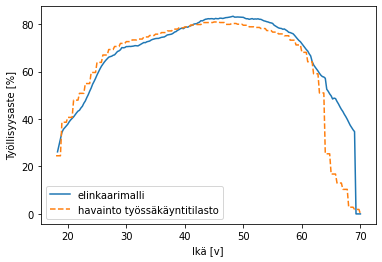

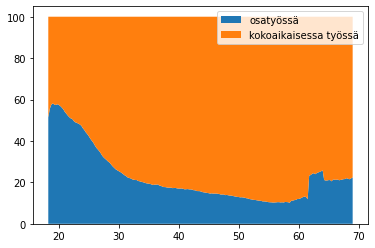

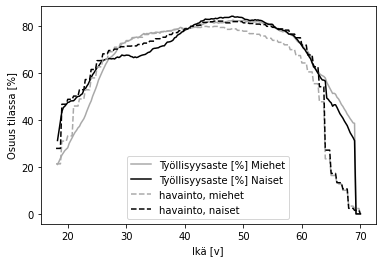

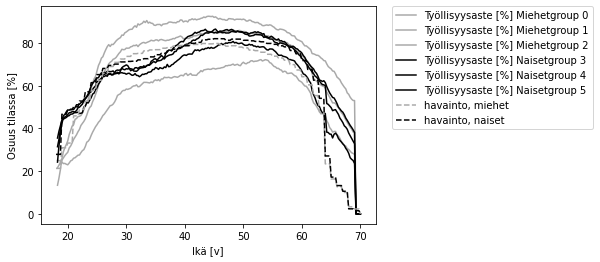

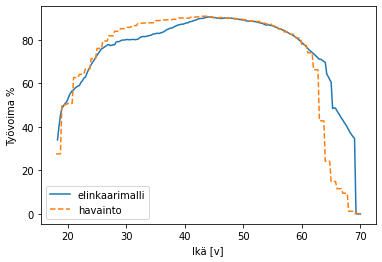

Tilaan 0 menetetty palkkasumma 3,879,956,801.06 ja työpanoksen arvo 8,147,909,282.22
Tilan 1 palkkasumma 82,664,987,852.00 ja työpanoksen arvo 173,596,474,489.20
Tilaan 2 menetetty palkkasumma 5,808,743,465.14 ja työpanoksen arvo 12,198,361,276.80
Tilaan 3 menetetty palkkasumma 3,702,876,368.99 ja työpanoksen arvo 7,776,040,374.87
Tilaan 4 menetetty palkkasumma 225,737,953.11 ja työpanoksen arvo 474,049,701.52
Tilaan 5 menetetty palkkasumma 1,122,663,683.28 ja työpanoksen arvo 2,357,593,734.89
Tilaan 6 menetetty palkkasumma 169,803,269.43 ja työpanoksen arvo 356,586,865.81
Tilaan 7 menetetty palkkasumma 1,656,529,812.78 ja työpanoksen arvo 3,478,712,606.84
Tilan 8 palkkasumma 15,541,751.49 ja työpanoksen arvo 32,637,678.13
Tilan 9 palkkasumma 256,235,986.48 ja työpanoksen arvo 538,095,571.60
Tilan 10 palkkasumma 9,636,375,415.41 ja työpanoksen arvo 20,236,388,372.37
Tilaan 11 menetetty palkkasumma 881,039,811.86 ja työpanoksen arvo 1,850,183,604.90
Tilaan 12 menetetty palkkasumma 5,779

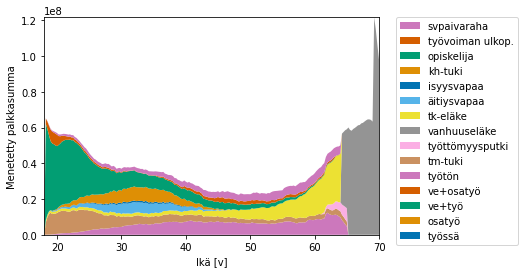

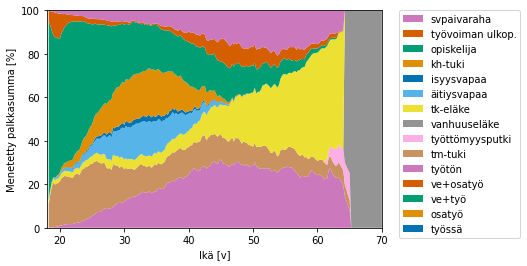

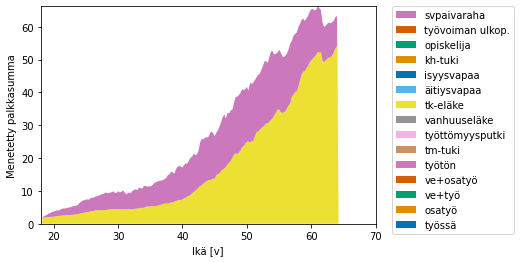

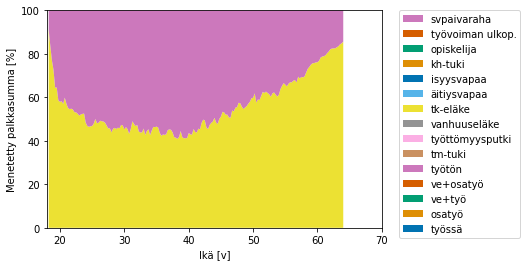

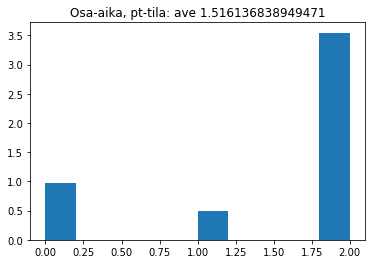

...

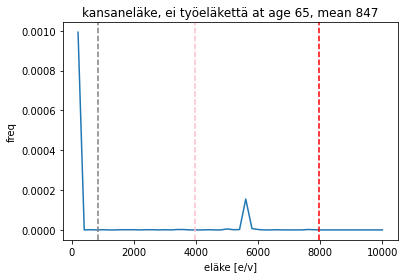

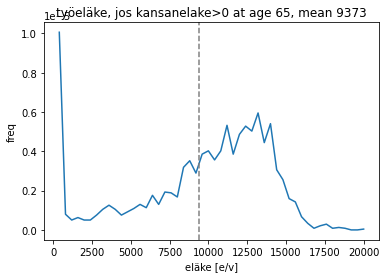

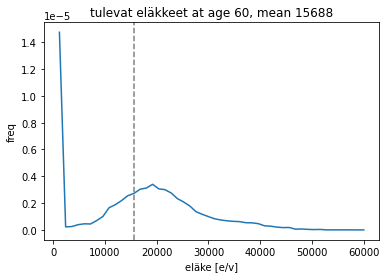

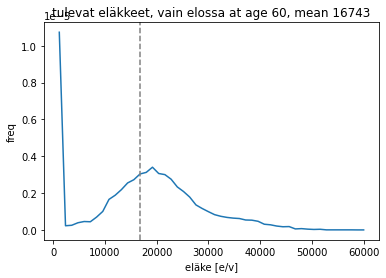

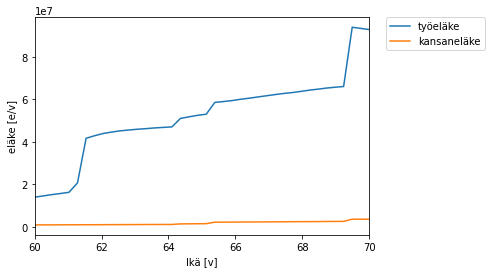

työeläkemeno alle 63: 2875639512.64 vs tilasto 1807.10
työeläkemeno yli 63: 26388710892.50 vs tilasto 24227.20
kansaneläkemeno alle 63: 400643594.51 vs tilasto 679.60
kansaneläkemeno yli 63: 961643620.49 vs tilasto 1419.90


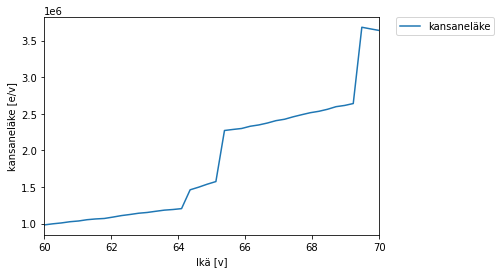

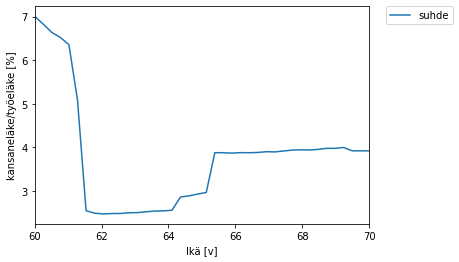

Työkyvyttömyyseläkkeisiin menetetty palkkasumma 3,604,161,367.90 ja työpanoksen arvo 7,676,863,713.63


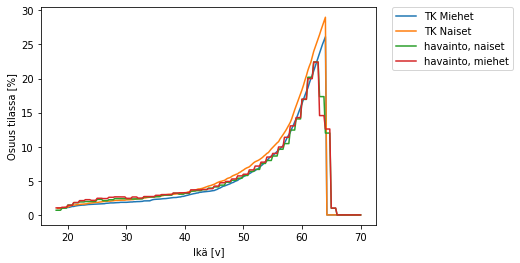

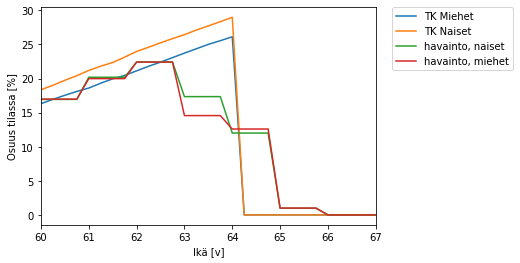

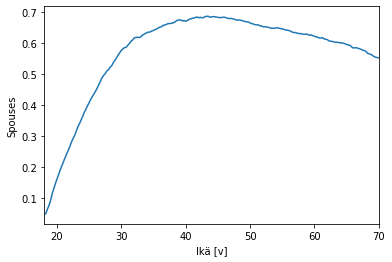

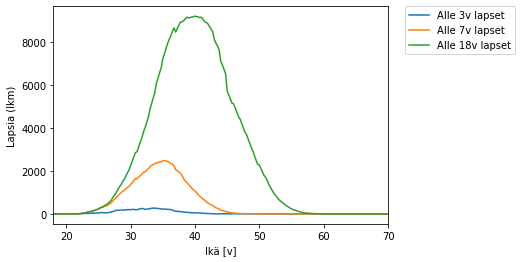

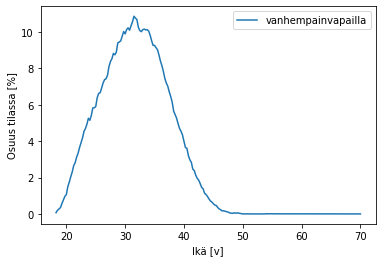

...

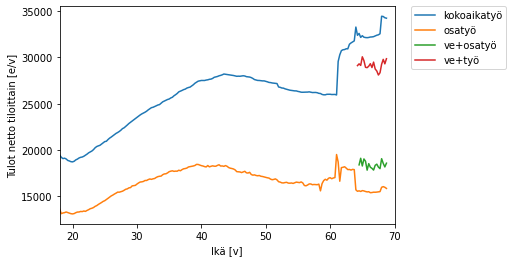

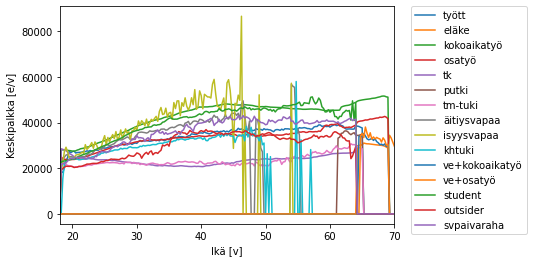

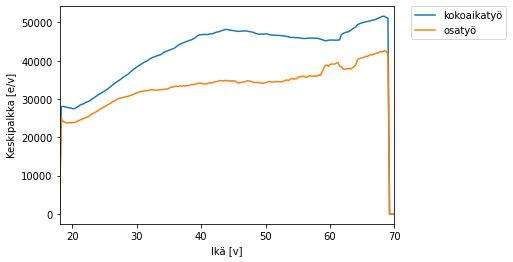

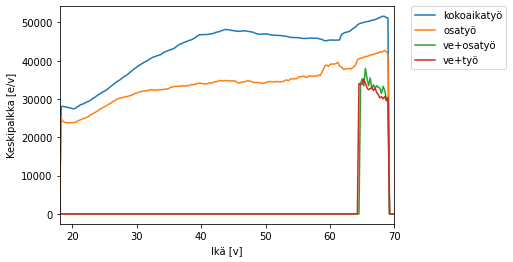

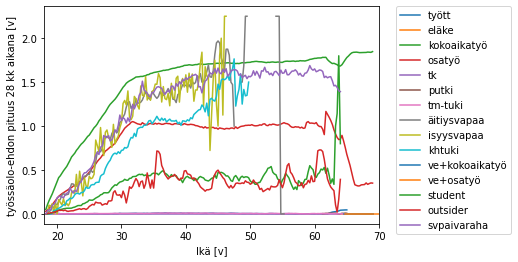

Keskikestot käytettyjen ansiosidonnaisten päivärahojen mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.52 |      0.33 |       0.15 |      0.00 |        0.00 |
| 30-39 |     0.49 |      0.32 |       0.19 |      0.00 |        0.00 |
| 40-49 |     0.51 |      0.31 |       0.18 |      0.00 |        0.00 |
| 50-59 |     0.52 |      0.32 |       0.17 |      0.00 |        0.00 |
| 60-65 |     0.28 |      0.21 |       0.17 |      0.13 |        0.22 |
+-------+----------+-----------+------------+-----------+-------------+
Keskikestot viimeisimmän työttömyysjakson mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.91 |     

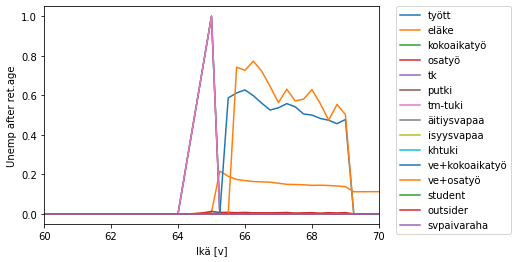

Lisäpäivillä on 7908 henkilöä


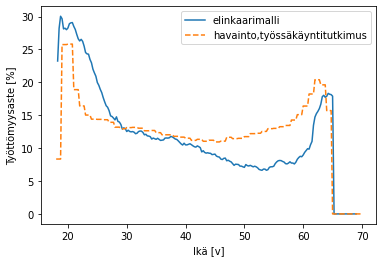

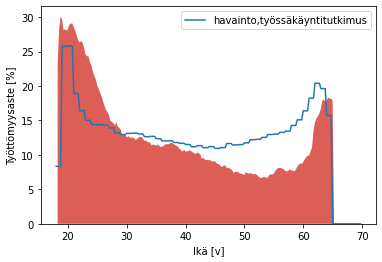

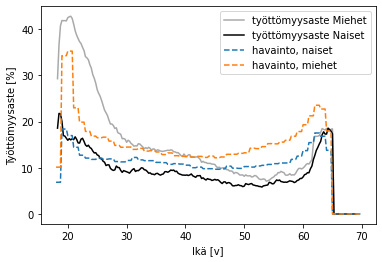

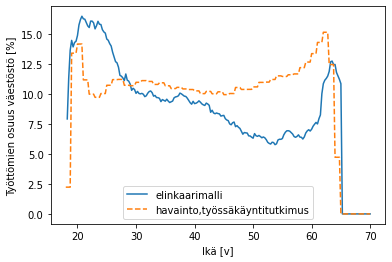

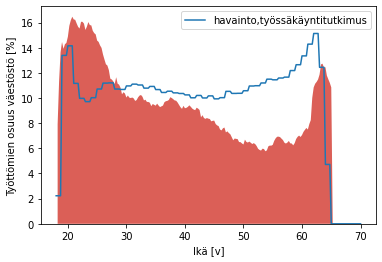

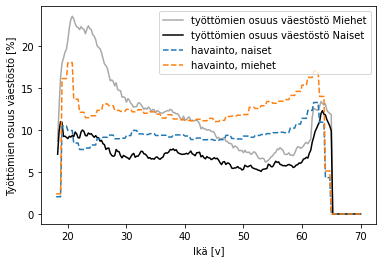

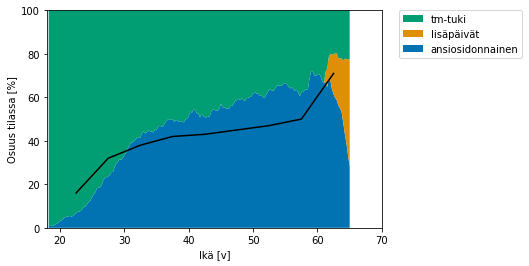

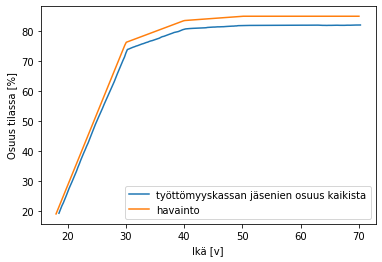

Kassanjäseniä min 19.404851 % max 81.944937 %


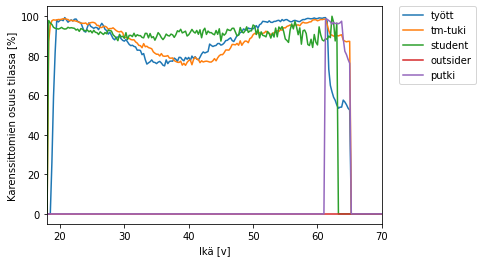

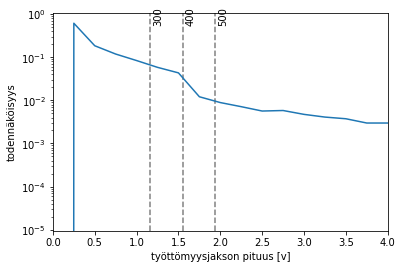

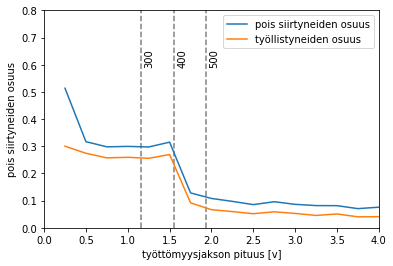

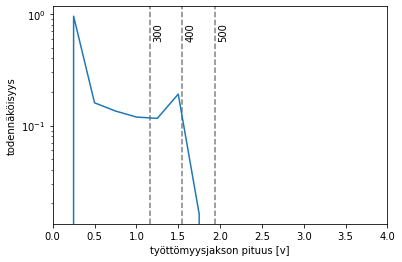

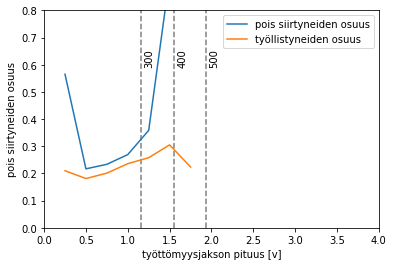

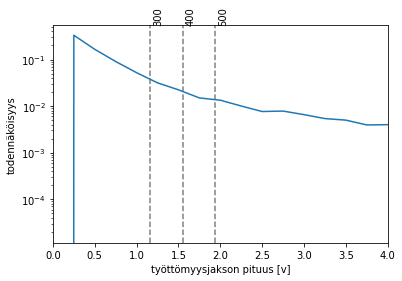

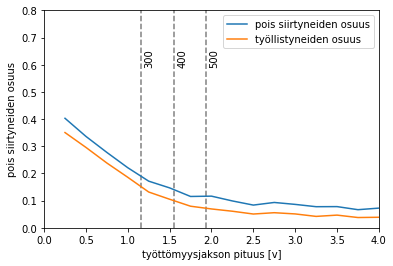

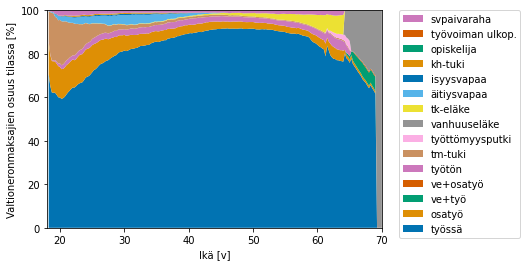

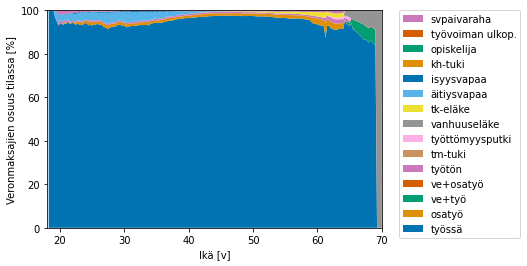

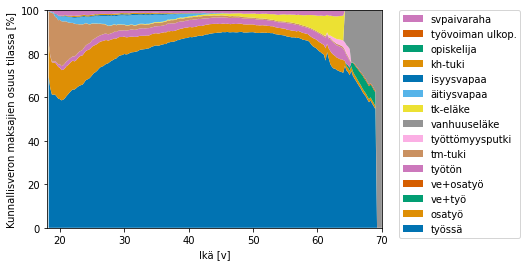

Valtionveron maksajien osuus
Etuudella olevat 1.96
Työssä 85.29
Eläkkeellä 12.89

Kunnallisveron maksajien osuus
Etuudella olevat 5.39
Työssä 72.28
Eläkkeellä 21.51

Veronmaksajien osuus
Etuudella olevat 4.76
Työssä 74.67
Eläkkeellä 19.92



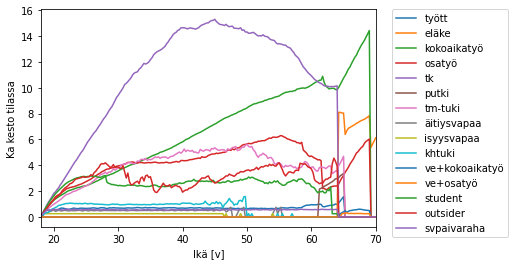

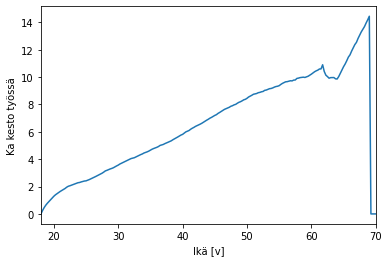

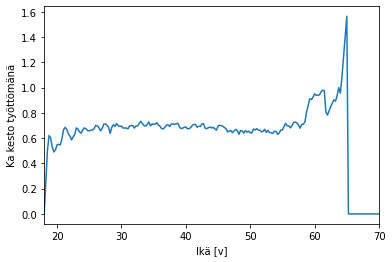

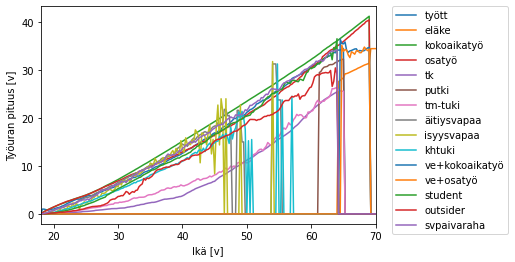

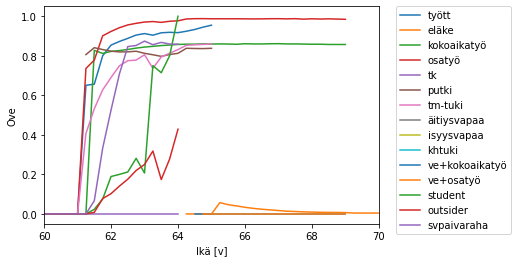

...

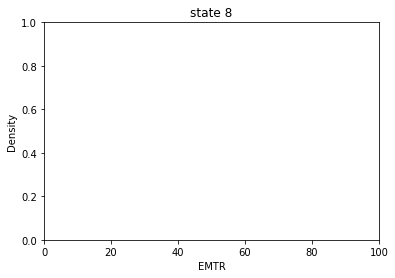

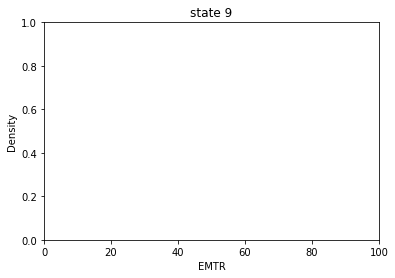

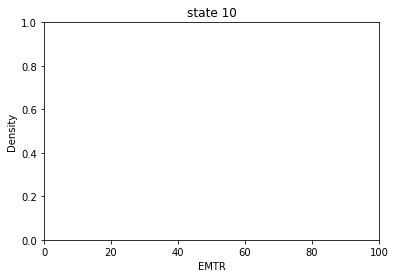

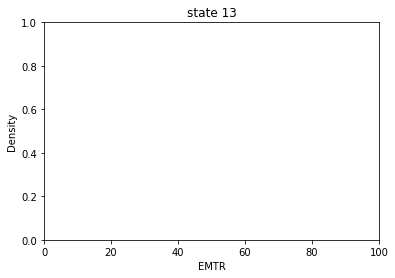

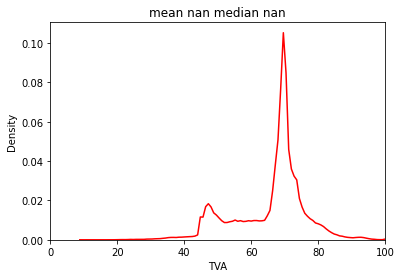

kaikki: työttömyysloukussa (80 %) 0.0


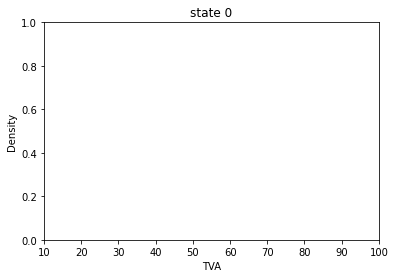

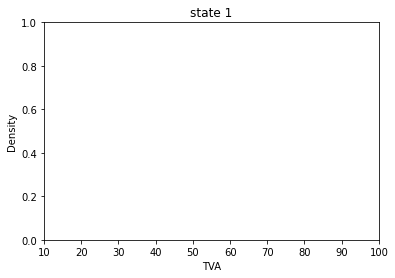

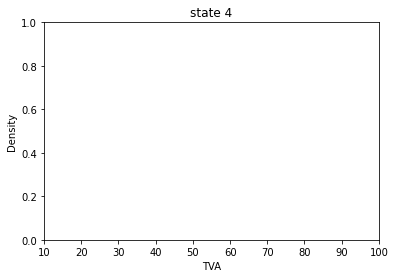

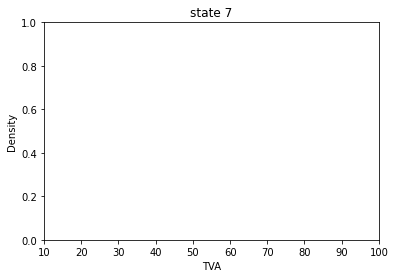

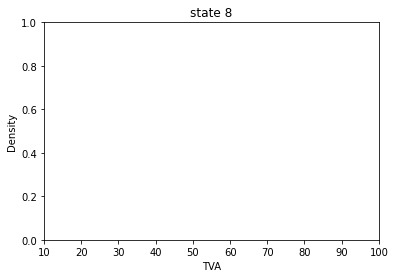

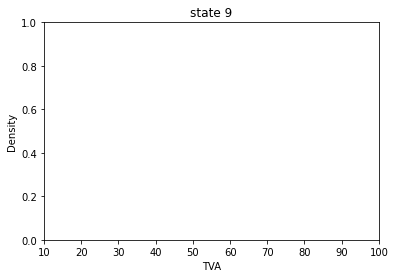

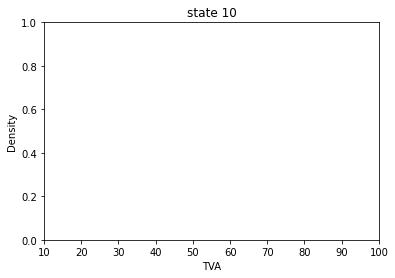

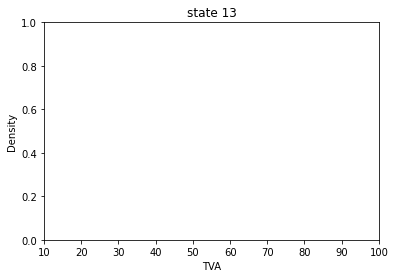

0: työttömyysloukussa (80 %) 0.0
1: työttömyysloukussa (80 %) 0.0
4: työttömyysloukussa (80 %) 0.0
7: työttömyysloukussa (80 %) 0.0
8: työttömyysloukussa (80 %) 0.0
9: työttömyysloukussa (80 %) 0.0
10: työttömyysloukussa (80 %) 0.0
13: työttömyysloukussa (80 %) 0.0


In [27]:
cc2020.load_sim(load=results2020)
cc2020.render(figname='images/2020_')

Mortality included, not stopped
disability rate from year 2018
student year 2018
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.5
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_malli_res_mort_yesove version 5
2020 reward 13.544350451081105 netincome 21521.47 eq 16467.365 initial 11.047527641571422
2018 reward 13.478871985050107 netincome 20183.15 eq 16209.374 initial 11.088790940307772
Rahavirrat skaalattuna väestötasolle
+---------------------------+----------------------+----------------------+----------------------+
|          

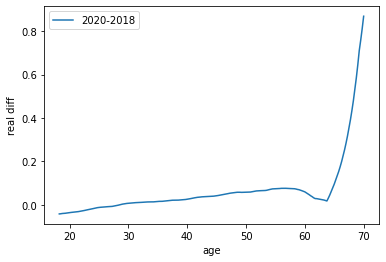

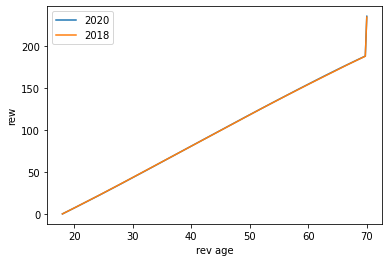

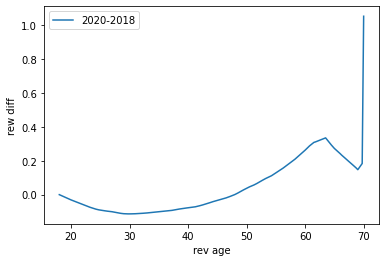

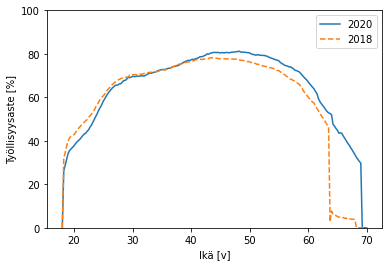

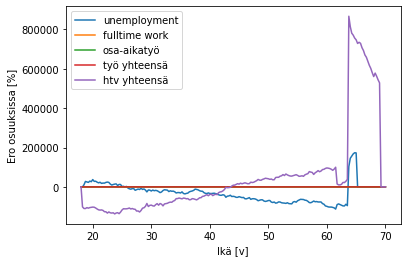

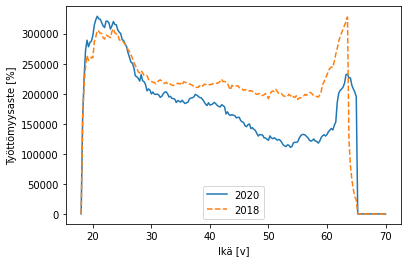

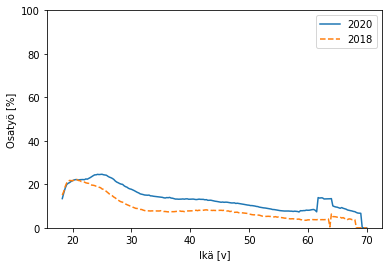

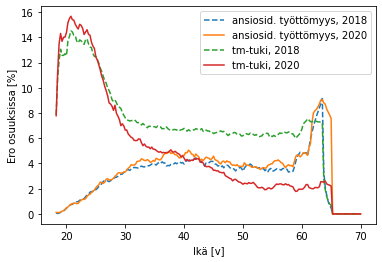

Työllisyysvaikutus 21-60-vuotiaisiin noin -35542 htv ja 33781 työllistä
- kokoaikaisiin 21-60-vuotiailla noin -104865 työllistä (1580451 vs 1685316)
- osa-aikaisiin 21-60-vuotiailla noin 138646 työllistä (382143 vs 243497)
Työllisiä 1771522 vs 1807064 htv
Työllisyysastevaikutus 21-60-vuotiailla noin 1.24 prosenttia (71.89 vs 70.65)
- kokoaikaisiin 21-60-vuotiailla noin -6.85 prosenttia (80.53 vs 87.38)
- osa-aikaisiin 21-60-vuotiailla noin 6.85 prosenttia (19.47 vs 12.62)
Työttömyysvaikutus 21-60-vuotiaisiin noin -56177 htv
- ansiosidonnaiseen 21-60-vuotiailla noin 14596 htv (121630 vs 107034)
- tm-tukeen 21-60-vuotiailla noin -71944 työllistä (178657 vs 250602)
- putkeen 21-60-vuotiailla noin 1172 työllistä (7206 vs 6034)
epävarmuus työllisyysasteissa 0.0139, hajonta 0.0975


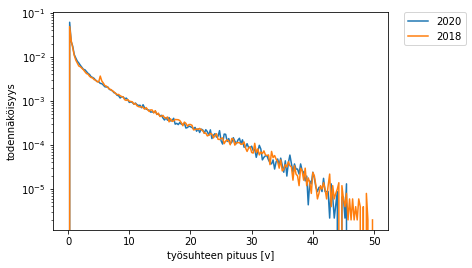

Jakauma ansiosidonnainen+tmtuki+putki, no max age
2020 keskikesto 0.8845436518570127 v 2018 keskikesto 1.1813276149806116 v
Skaalaamaton 2020 lkm 93295 v 2018 lkm 81492 v
Skaalaamaton 2020 työtpäiviä yht 82523.5 v 2018 työtpäiviä yht 96268.75 v


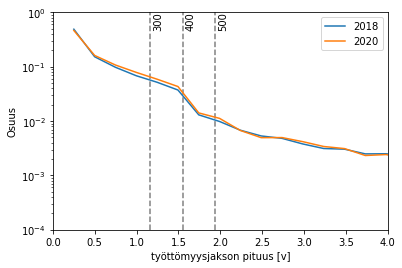

2020 keskikesto 0.8845436518570127 v 2018 keskikesto 1.1813276149806116 v
Skaalaamaton 2020 lkm 93295 v 2018 lkm 81492 v
Skaalaamaton 2020 työtpäiviä yht 82523.5 v 2018 työtpäiviä yht 96268.75 v


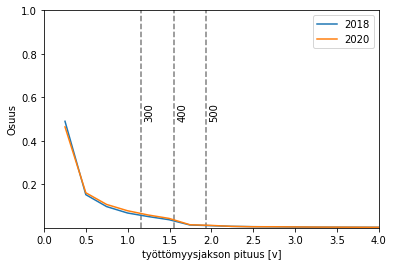

2020 keskikesto 0.8845436518570127 v 2018 keskikesto 1.1813276149806116 v
Skaalaamaton 2020 lkm 93295 v 2018 lkm 81492 v
Skaalaamaton 2020 työtpäiviä yht 82523.5 v 2018 työtpäiviä yht 96268.75 v


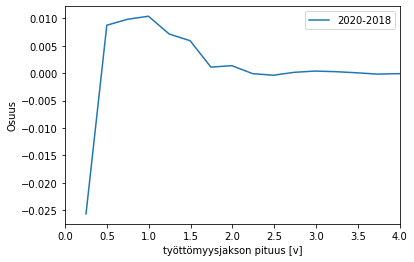

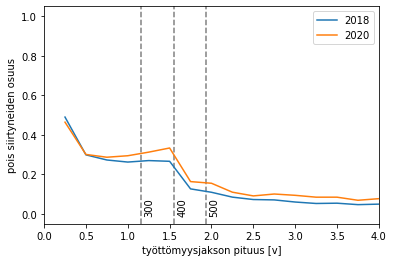

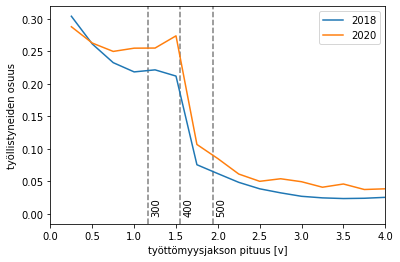

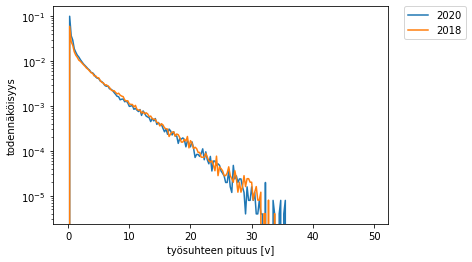

Jakauma ansiosidonnainen+tmtuki+putki, max age 54
2020 keskikesto 0.8427215740901968 v 2018 keskikesto 0.8932174097065463 v
Skaalaamaton 2020 lkm 80402 v 2018 lkm 70880 v
Skaalaamaton 2020 työtpäiviä yht 67756.5 v 2018 työtpäiviä yht 63311.25 v


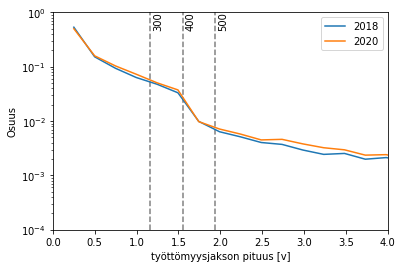

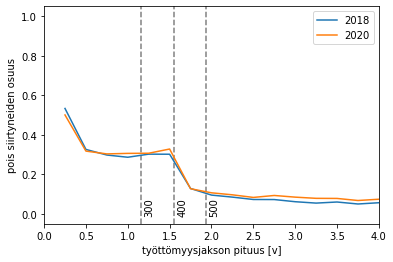

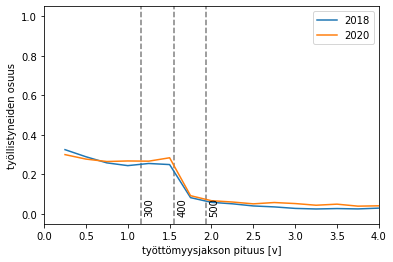

2018
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.52 |      0.33 |       0.15 |      0.00 |        0.00 |
| 30-39 |     0.49 |      0.32 |       0.19 |      0.00 |        0.00 |
| 40-49 |     0.51 |      0.31 |       0.18 |      0.00 |        0.00 |
| 50-59 |     0.52 |      0.32 |       0.17 |      0.00 |        0.00 |
| 60-65 |     0.28 |      0.21 |       0.17 |      0.13 |        0.22 |
+-------+----------+-----------+------------+-----------+-------------+
2020
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.50 |      0.33 |       0.17 |      0.00 |        0.00 |
| 30-39 |     0.48 |      0.32 |       0.20 |      0.0

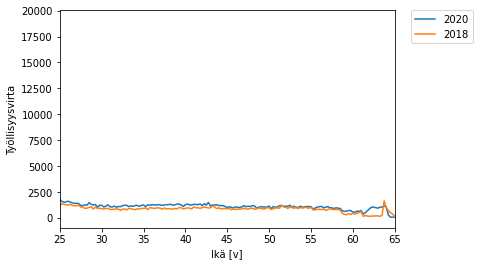

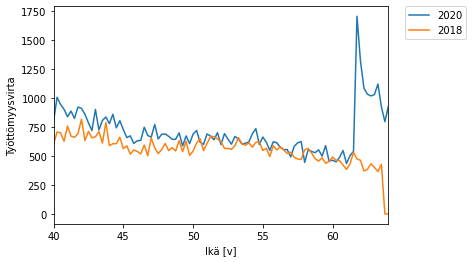

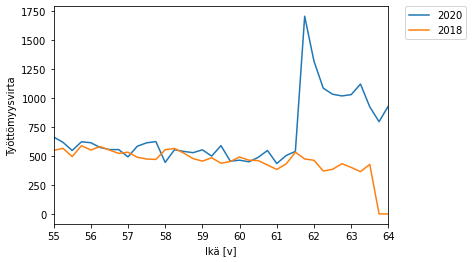

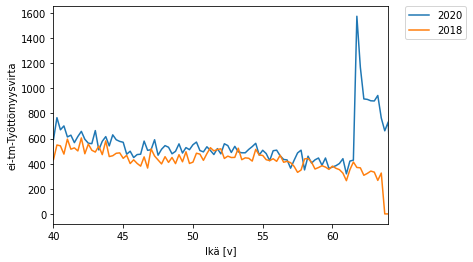

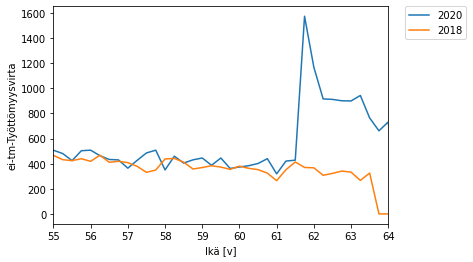

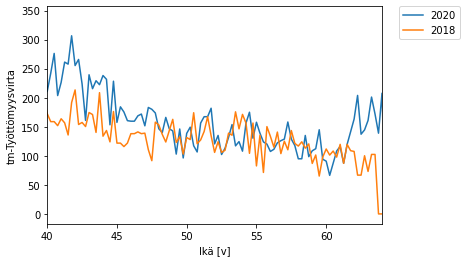

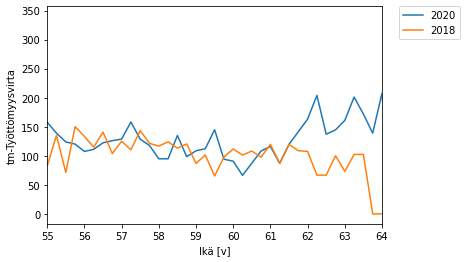

In [28]:
cc2018=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
              plotdebug=plotdebug,year=2018)
cc2018.load_sim(load=results2018)
cc2020.compare_with(cc2018,label1='2020',label2='2018',figname='vuosivertailu')
del cc2018
del cc2020

# 2021

In [29]:
cc2021=Lifecycle(env=model,mortality=mortality,perustulo=False,include_putki=True,library=library,
                 plotdebug=plotdebug,year=2021,include_ove=include_ove,unemp_limit_reemp=unemp_limit_reemp,
                 silent=False,include_emtr=include_emtr)

Mortality included, not stopped
disability rate from year 2021
student year 2021
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 64.25
max_retirementage 69
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400



In [30]:
if run2021:
    cc2021.run_results(debug=debug,steps1=size1,steps2=size2,pop=pop_size,deterministic=deterministic,
                    train=True,predict=True,batch1=batch1,batch2=batch2,gae_lambda=gae_lambda,
                    learning_rate=learning_rate,learning_schedule=schedule,
                    save=malli2021,cont=cont,start_from=malli2021,results=results2021,
                    callback_minsteps=callback_minsteps,rlmodel=rlmodel,twostage=twostage,
                    log_interval=1000)

Loading results from results/v5_perus_2021 version 5


Ave net income 21,956.54 Ave equivalent net income 16,721.33
Rahavirrat skaalattuna väestötasolle
+---------------------------+-----------------------+--------------------+-------------------+
|                           |                   e/v |            toteuma |               ero |
|---------------------------+-----------------------+--------------------+-------------------|
| tyotulosumma              |  96,275,981,654.88    |  96,602,200,000.00 |   -326,218,345.12 |
| tyotulosumma eielakkeella |  95,615,067,995.77    |                nan |               nan |
| etuusmeno                 |  42,203,046,053.64    |  42,000,629,161.00 |    202,416,892.64 |
| verot+maksut              |  35,379,723,686.83    |  36,913,241,800.00 | -1,533,518,113.17 |
| verot+maksut+alv          |  52,896,974,992.63    |  57,130,241,800.00 | -4,233,266,807.37 |
| palkkaverot+maksut        |  28,289,282,771.02    |                nan |               nan |
| muut tulot                | -10,693,928,938.9


Sic! Työllisyysaste vastaa työvoimatilaston laskutapaa!
Työllisyysaste 18-64: 71.04%
Gini coefficient is 26.552 (havainto 27.800)

Sic! pienituloisuus lasketaan vain aikuisväestöstä!
Pienituloisuus 50%: 14.74%; 60%: 19.85%; abs 1000 e/kk 19.31%


Real discounted reward 13.57151679021991
Initial discounted reward 11.062337956384933


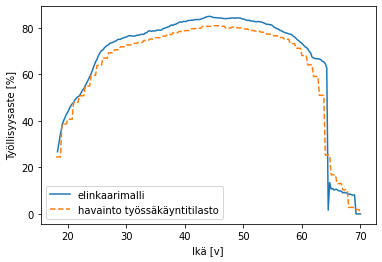

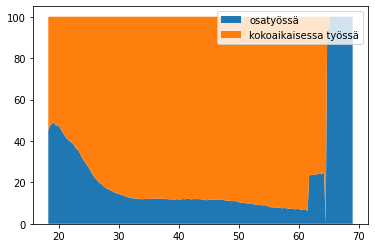

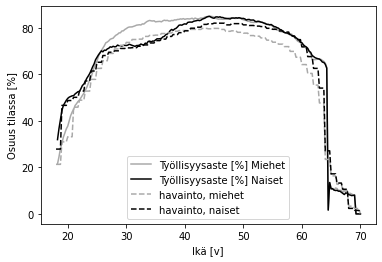

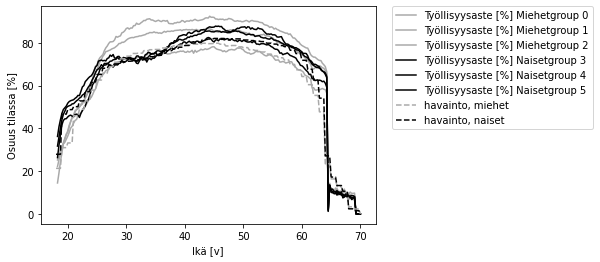

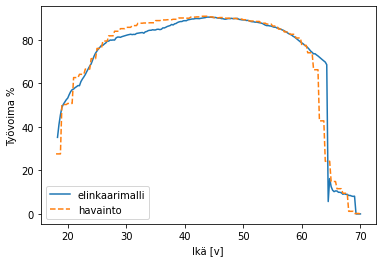

Tilaan 0 menetetty palkkasumma 3,906,591,999.97 ja työpanoksen arvo 8,203,843,199.94
Tilan 1 palkkasumma 88,695,960,246.60 ja työpanoksen arvo 186,261,516,517.87
Tilaan 2 menetetty palkkasumma 8,711,744,572.68 ja työpanoksen arvo 18,294,663,602.64
Tilaan 3 menetetty palkkasumma 3,885,951,469.09 ja työpanoksen arvo 8,160,498,085.08
Tilaan 4 menetetty palkkasumma 47,196,827.84 ja työpanoksen arvo 99,113,338.47
Tilaan 5 menetetty palkkasumma 1,219,098,532.84 ja työpanoksen arvo 2,560,106,918.95
Tilaan 6 menetetty palkkasumma 185,831,088.50 ja työpanoksen arvo 390,245,285.86
Tilaan 7 menetetty palkkasumma 855,311,413.02 ja työpanoksen arvo 1,796,153,967.34
Tilan 8 palkkasumma 660,913,659.12 ja työpanoksen arvo 1,387,918,684.15
Tilan 9 palkkasumma 0.00 ja työpanoksen arvo 0.00
Tilan 10 palkkasumma 6,919,107,749.16 ja työpanoksen arvo 14,530,126,273.24
Tilaan 11 menetetty palkkasumma 1,294,725,331.52 ja työpanoksen arvo 2,718,923,196.19
Tilaan 12 menetetty palkkasumma 6,178,886,369.12 ja työ

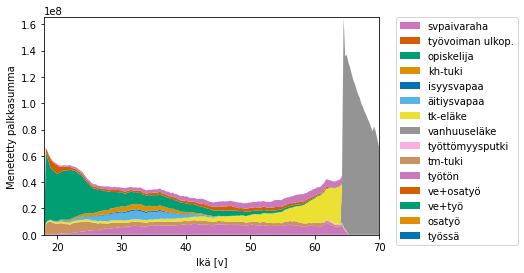

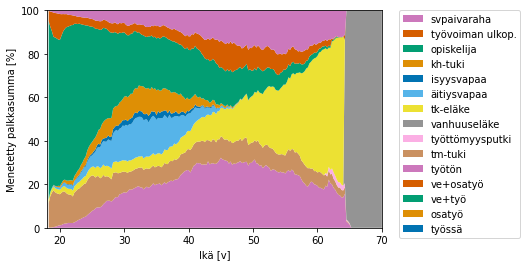

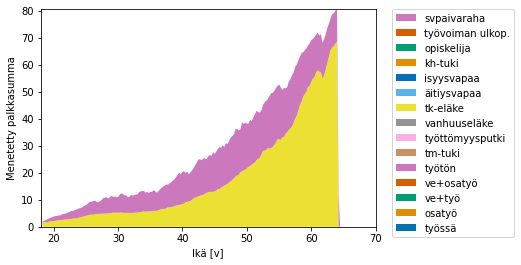

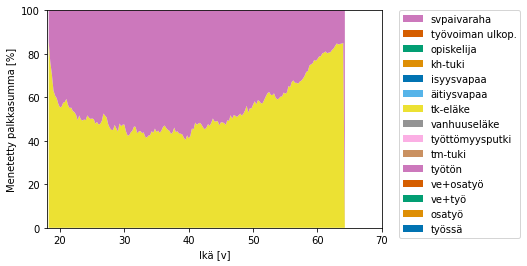

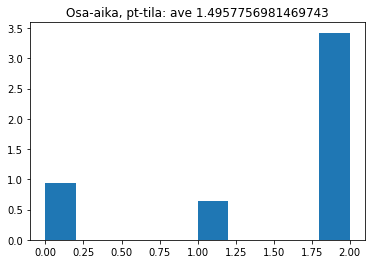

...

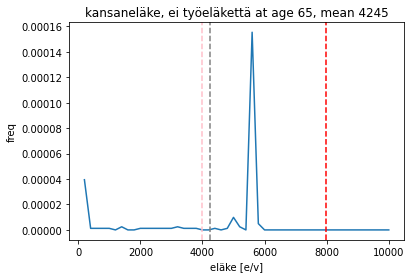

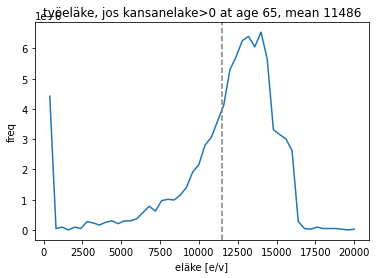

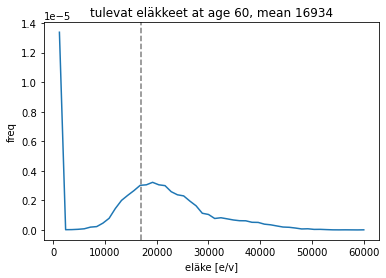

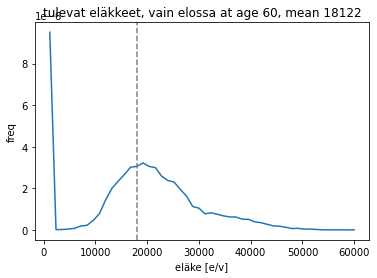

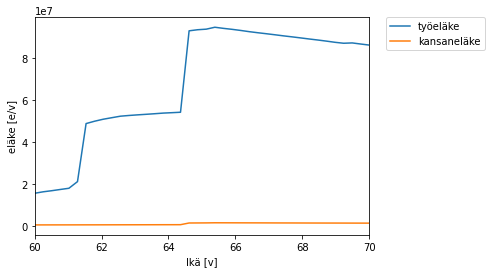

työeläkemeno alle 63: 3199372999.68 vs tilasto 1807.10
työeläkemeno yli 63: 26981045067.09 vs tilasto 24227.20
kansaneläkemeno alle 63: 335084687.36 vs tilasto 679.60
kansaneläkemeno yli 63: 441015850.51 vs tilasto 1419.90


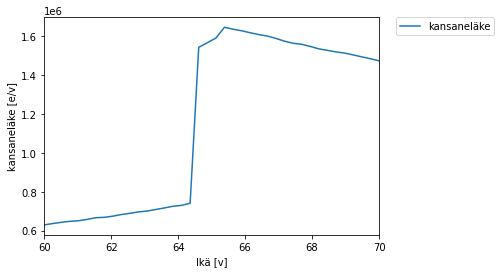

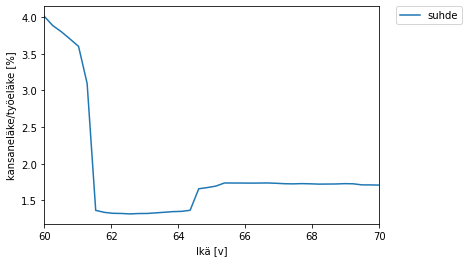

Työkyvyttömyyseläkkeisiin menetetty palkkasumma 3,885,951,469.09 ja työpanoksen arvo 8,277,076,629.16


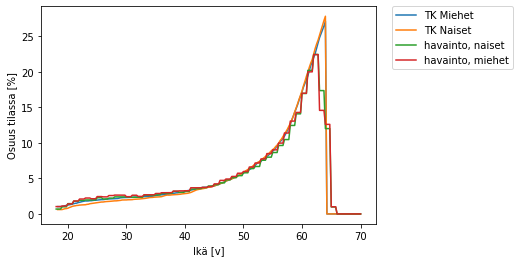

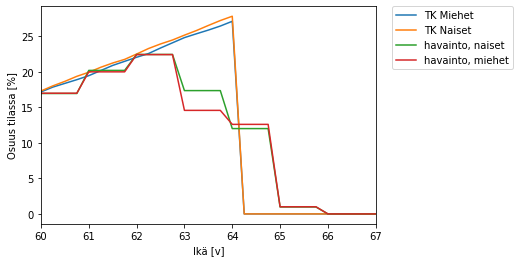

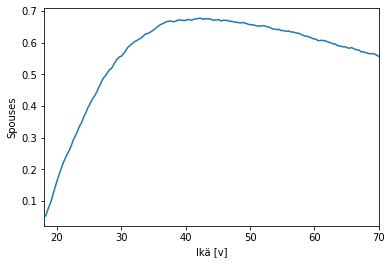

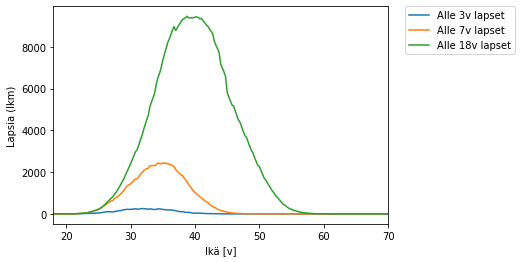

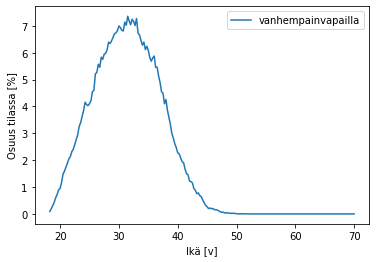

...

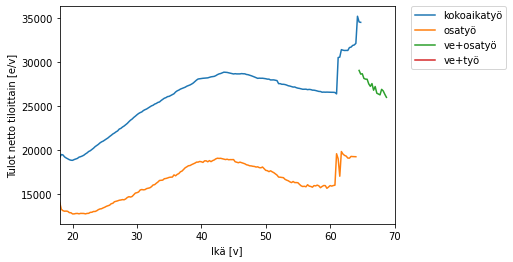

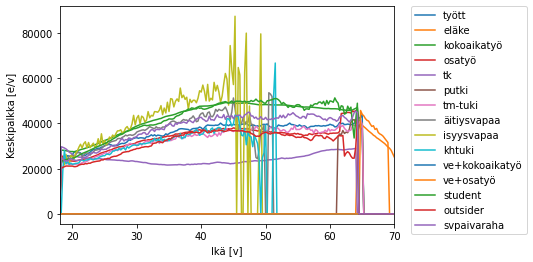

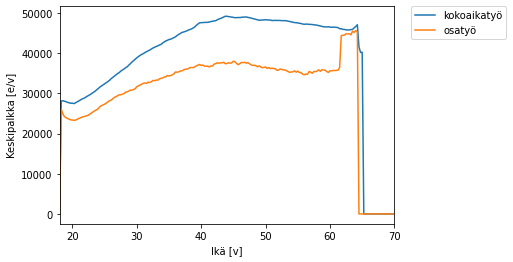

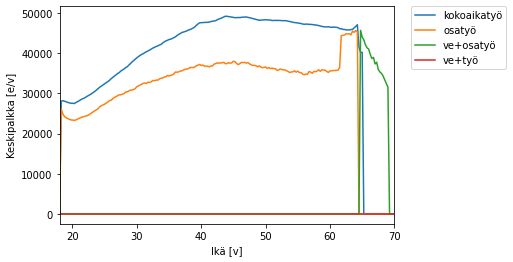

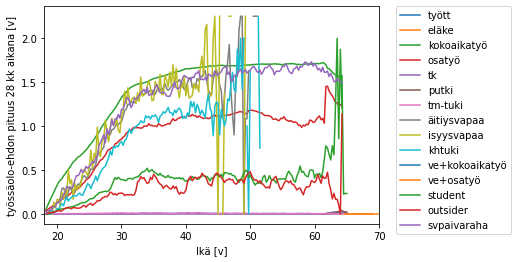

Keskikestot käytettyjen ansiosidonnaisten päivärahojen mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.49 |      0.34 |       0.17 |      0.00 |        0.00 |
| 30-39 |     0.48 |      0.32 |       0.19 |      0.00 |        0.00 |
| 40-49 |     0.52 |      0.31 |       0.18 |      0.00 |        0.00 |
| 50-59 |     0.52 |      0.31 |       0.17 |      0.00 |        0.00 |
| 60-65 |     0.43 |      0.25 |       0.16 |      0.09 |        0.07 |
+-------+----------+-----------+------------+-----------+-------------+
Keskikestot viimeisimmän työttömyysjakson mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.89 |     

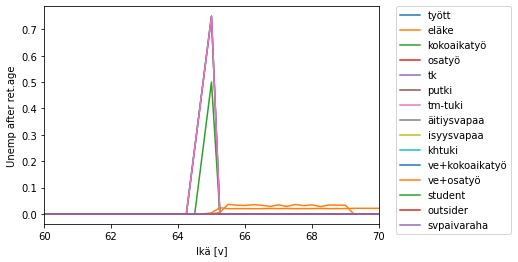

Lisäpäivillä on 1588 henkilöä


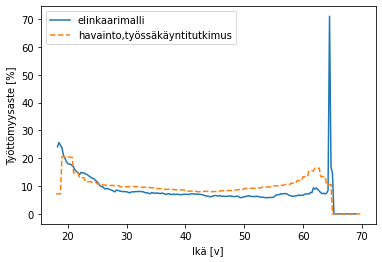

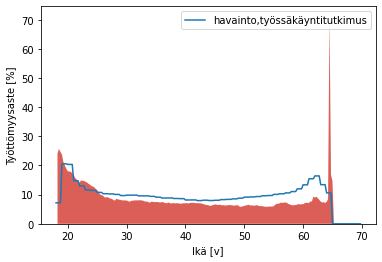

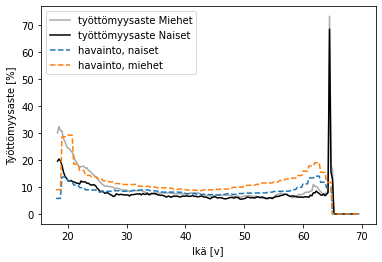

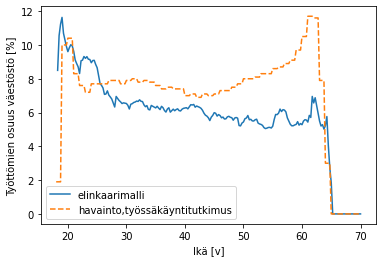

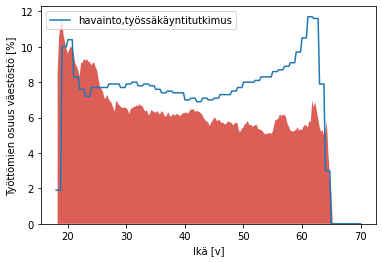

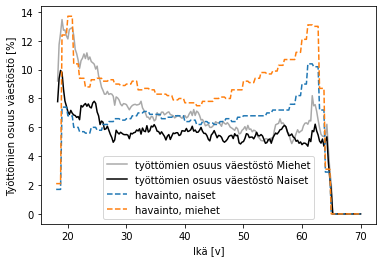

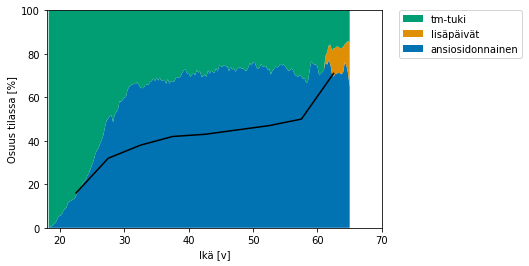

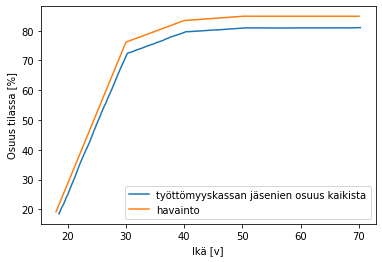

Kassanjäseniä min 18.463693 % max 81.027458 %


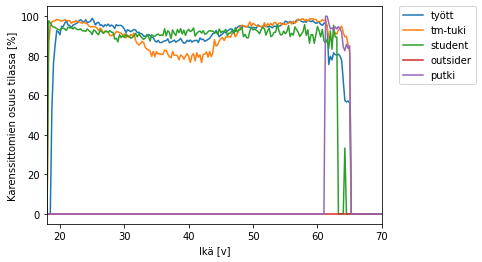

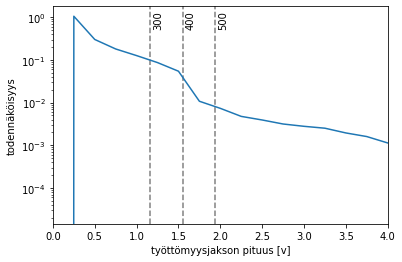

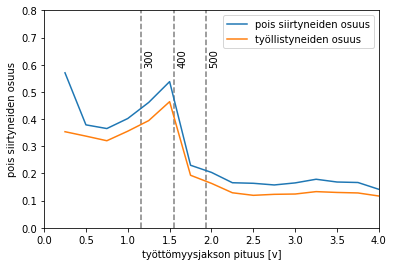

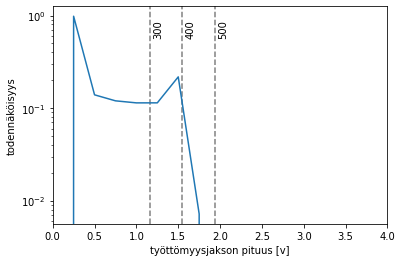

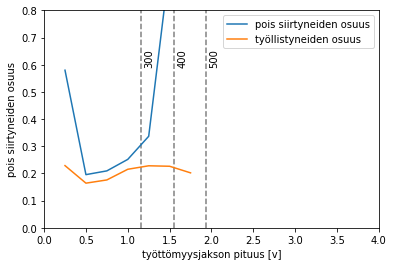

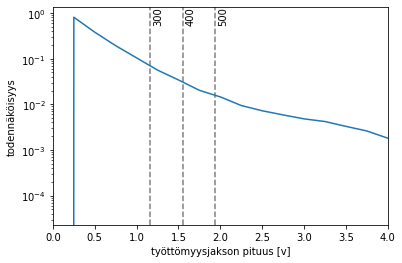

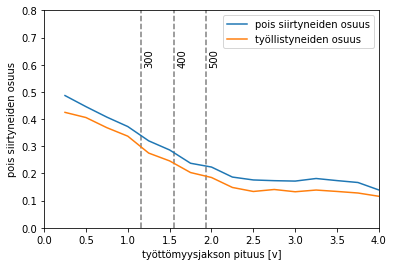

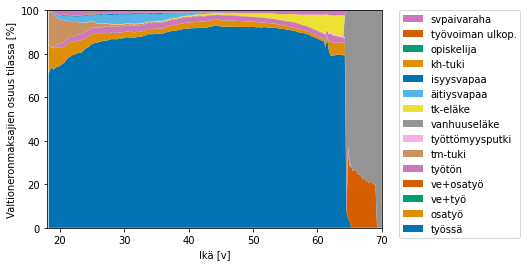

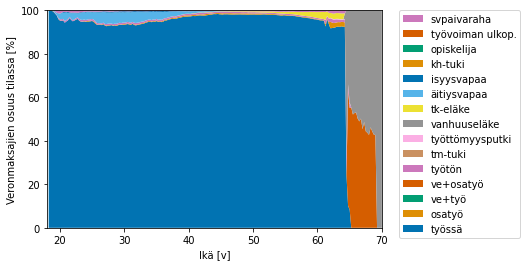

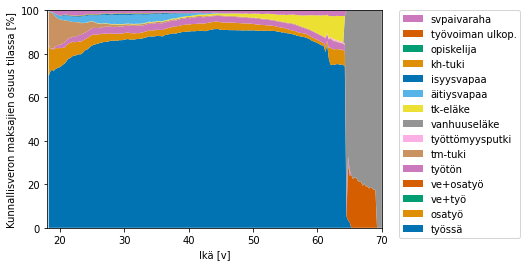

Valtionveron maksajien osuus
Etuudella olevat 3.07
Työssä 88.59
Eläkkeellä 9.35

Kunnallisveron maksajien osuus
Etuudella olevat 5.18
Työssä 73.05
Eläkkeellä 21.56

Veronmaksajien osuus
Etuudella olevat 4.82
Työssä 75.68
Eläkkeellä 19.49



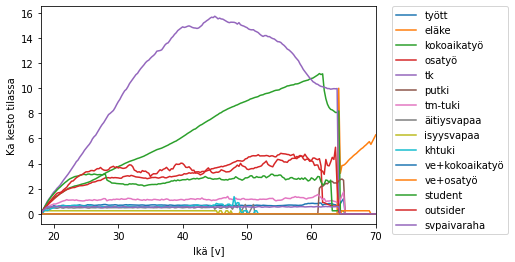

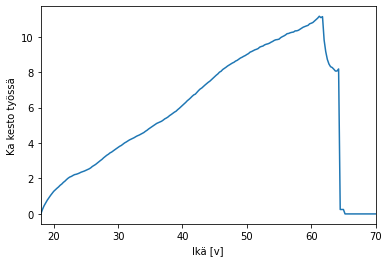

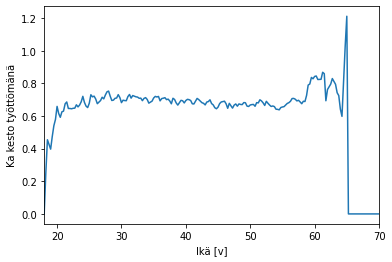

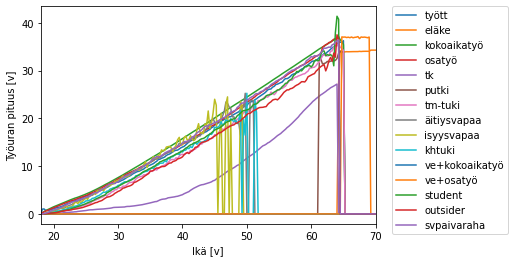

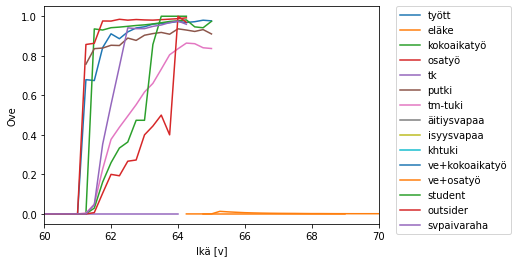

...

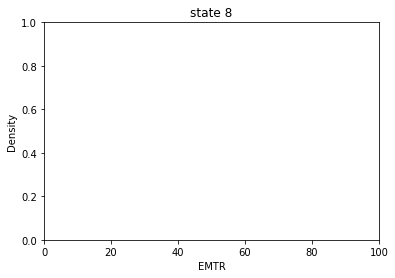

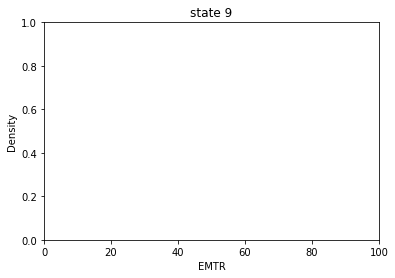

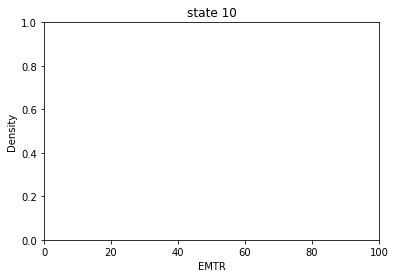

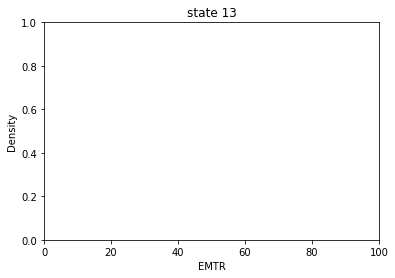

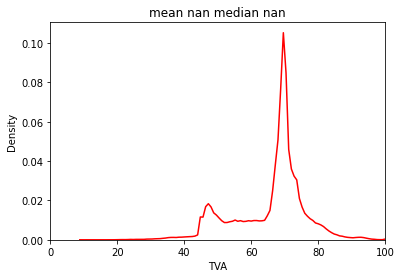

kaikki: työttömyysloukussa (80 %) 0.0


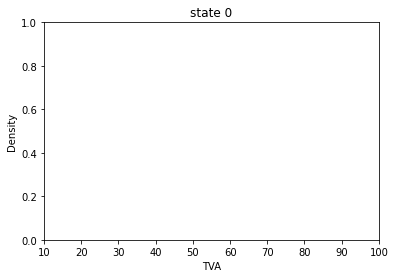

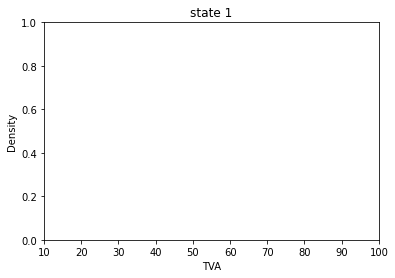

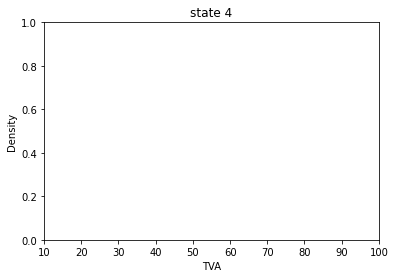

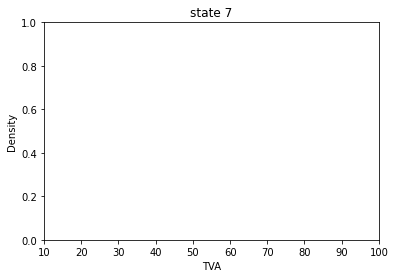

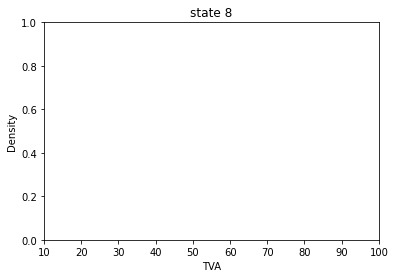

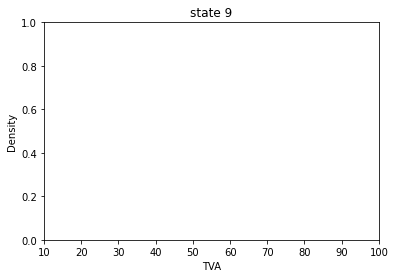

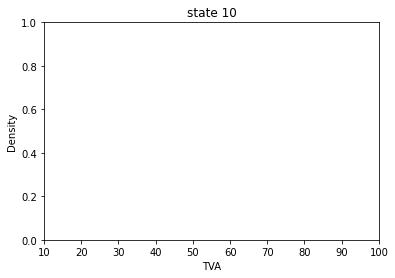

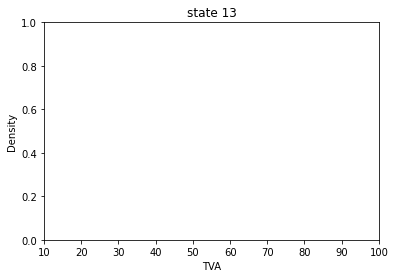

0: työttömyysloukussa (80 %) 0.0
1: työttömyysloukussa (80 %) 0.0
4: työttömyysloukussa (80 %) 0.0
7: työttömyysloukussa (80 %) 0.0
8: työttömyysloukussa (80 %) 0.0
9: työttömyysloukussa (80 %) 0.0
10: työttömyysloukussa (80 %) 0.0
13: työttömyysloukussa (80 %) 0.0


In [31]:
cc2021.load_sim(load=results2021)
cc2021.render()

Mortality included, not stopped
disability rate from year 2020
student year 2020
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 64.0
max_retirementage 69
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_perus_2020 version 5
2021 reward 13.57151679021991 netincome 21956.54 eq 16721.330 initial 11.062337956384933
2020 reward 13.544350451081105 netincome 21521.47 eq 16467.365 initial 11.047527641571422
Rahavirrat skaalattuna väestötasolle
+---------------------------+-----------------------+----------------------+----------------------+
|                     

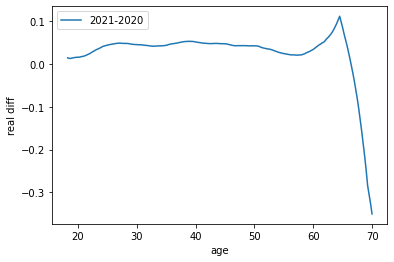

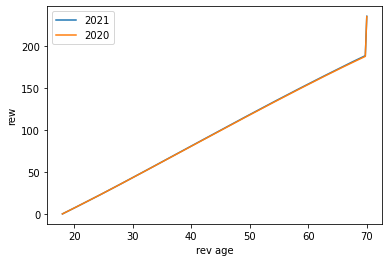

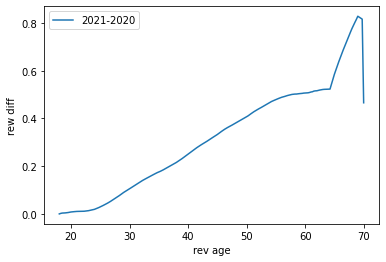

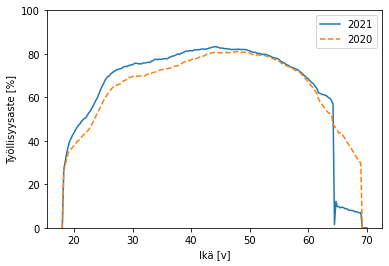

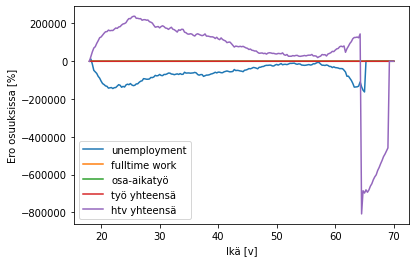

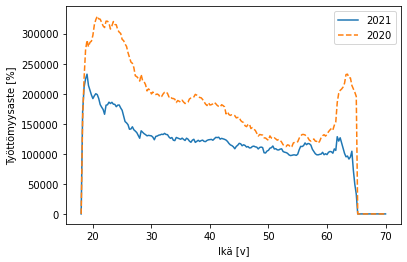

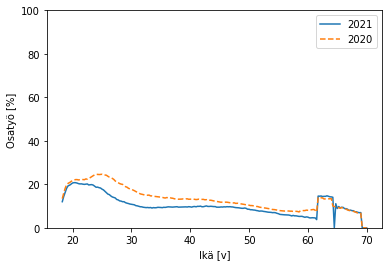

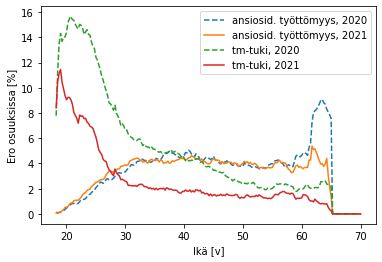

Työllisyysvaikutus 21-60-vuotiaisiin noin 152021 htv ja 100712 työllistä
- kokoaikaisiin 21-60-vuotiailla noin 203331 työllistä (1783781 vs 1580451)
- osa-aikaisiin 21-60-vuotiailla noin -102619 työllistä (279524 vs 382143)
Työllisiä 1923543 vs 1771522 htv
Työllisyysastevaikutus 21-60-vuotiailla noin 3.69 prosenttia (75.58 vs 71.89)
- kokoaikaisiin 21-60-vuotiailla noin 5.92 prosenttia (86.45 vs 80.53)
- osa-aikaisiin 21-60-vuotiailla noin -5.92 prosenttia (13.55 vs 19.47)
Työttömyysvaikutus 21-60-vuotiaisiin noin -102424 htv
- ansiosidonnaiseen 21-60-vuotiailla noin -6626 htv (115004 vs 121630)
- tm-tukeen 21-60-vuotiailla noin -90043 työllistä (88614 vs 178657)
- putkeen 21-60-vuotiailla noin -5755 työllistä (1451 vs 7206)
epävarmuus työllisyysasteissa 0.0139, hajonta 0.0809


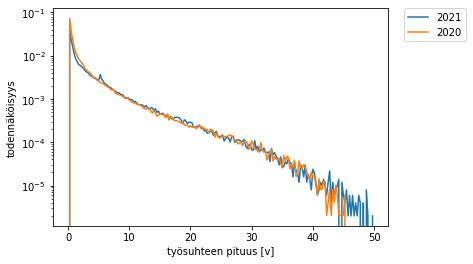

Jakauma ansiosidonnainen+tmtuki+putki, no max age
2021 keskikesto 0.5740340463055564 v 2020 keskikesto 0.8845436518570127 v
Skaalaamaton 2021 lkm 92991 v 2020 lkm 93295 v
Skaalaamaton 2021 työtpäiviä yht 53380.0 v 2020 työtpäiviä yht 82523.5 v


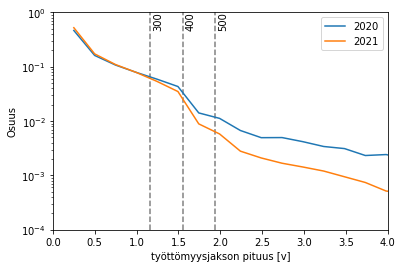

2021 keskikesto 0.5740340463055564 v 2020 keskikesto 0.8845436518570127 v
Skaalaamaton 2021 lkm 92991 v 2020 lkm 93295 v
Skaalaamaton 2021 työtpäiviä yht 53380.0 v 2020 työtpäiviä yht 82523.5 v


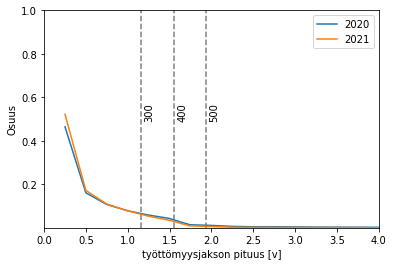

2021 keskikesto 0.5740340463055564 v 2020 keskikesto 0.8845436518570127 v
Skaalaamaton 2021 lkm 92991 v 2020 lkm 93295 v
Skaalaamaton 2021 työtpäiviä yht 53380.0 v 2020 työtpäiviä yht 82523.5 v


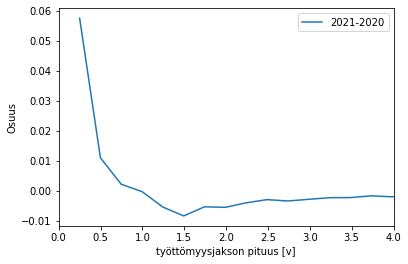

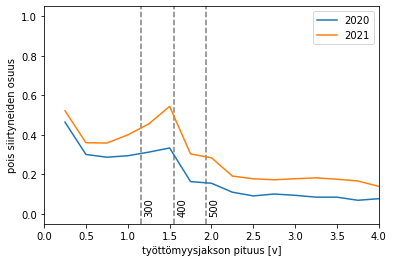

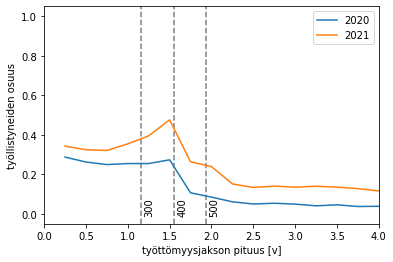

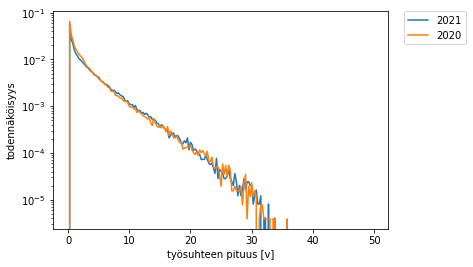

Jakauma ansiosidonnainen+tmtuki+putki, max age 54
2021 keskikesto 0.5466790654856688 v 2020 keskikesto 0.8427215740901968 v
Skaalaamaton 2021 lkm 80384 v 2020 lkm 80402 v
Skaalaamaton 2021 työtpäiviä yht 43944.25 v 2020 työtpäiviä yht 67756.5 v


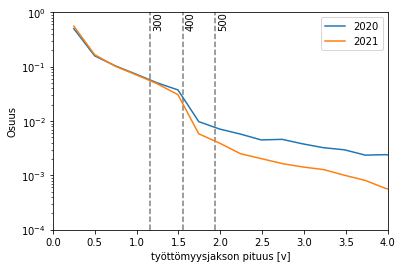

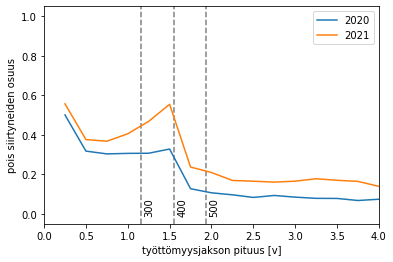

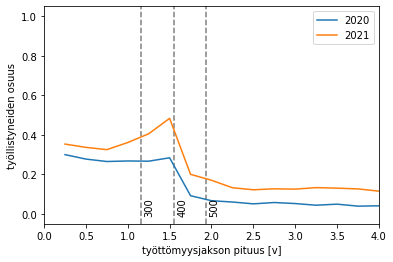

2020
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.49 |      0.34 |       0.17 |      0.00 |        0.00 |
| 30-39 |     0.48 |      0.32 |       0.19 |      0.00 |        0.00 |
| 40-49 |     0.52 |      0.31 |       0.18 |      0.00 |        0.00 |
| 50-59 |     0.52 |      0.31 |       0.17 |      0.00 |        0.00 |
| 60-65 |     0.43 |      0.25 |       0.16 |      0.09 |        0.07 |
+-------+----------+-----------+------------+-----------+-------------+
2021
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.52 |      0.33 |       0.15 |      0.00 |        0.00 |
| 30-39 |     0.49 |      0.32 |       0.19 |      0.0

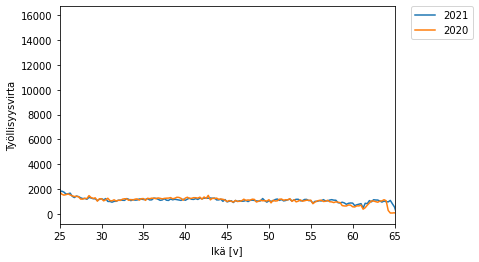

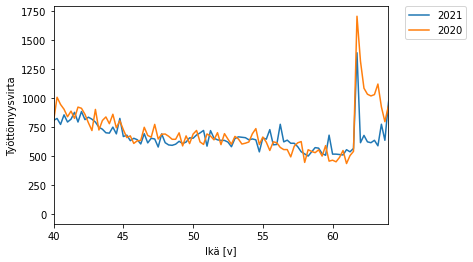

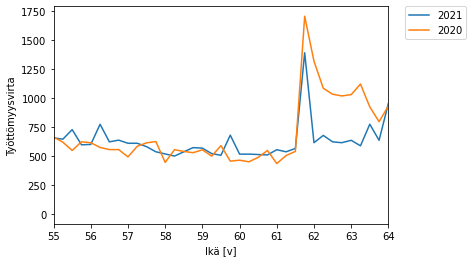

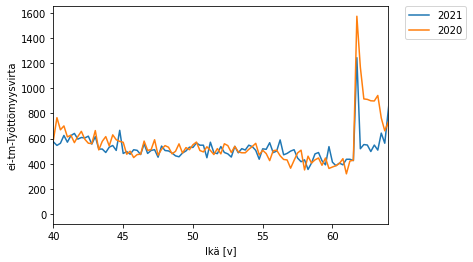

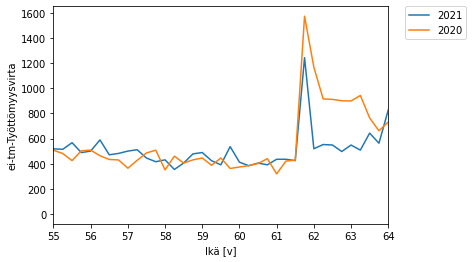

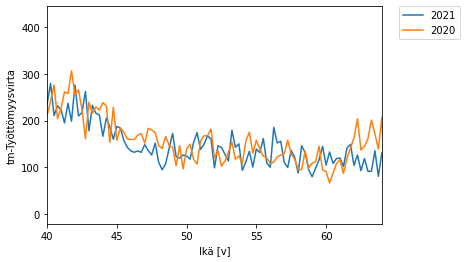

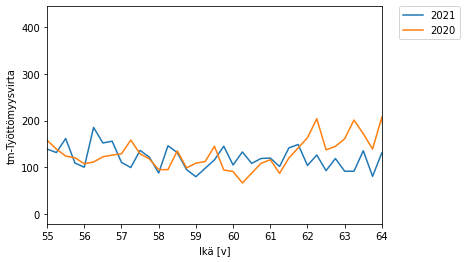

In [32]:
cc2020=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
              plotdebug=plotdebug,year=2020)
cc2020.load_sim(load=results2020)
cc2021.compare_with(cc2020,label1='2021',label2='2020',figname='vuosivertailu')
del cc2020
del cc2021

# 2022

In [33]:
cc2022=Lifecycle(env=model,mortality=mortality,perustulo=False,include_putki=True,library=library,
                 plotdebug=plotdebug,year=2022,include_ove=include_ove,unemp_limit_reemp=unemp_limit_reemp,
                 silent=False,include_emtr=include_emtr)

Mortality included, not stopped
disability rate from year 2022
student year 2022
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 64.5
max_retirementage 69
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400



In [34]:
if run2022:
    cc2022.run_results(debug=debug,steps1=size1,steps2=size2,pop=pop_size,deterministic=deterministic,
                    train=True,predict=True,batch1=batch1,batch2=batch2,gae_lambda=gae_lambda,
                    learning_rate=learning_rate,learning_schedule=schedule,
                    save=malli2022,cont=cont,start_from=malli2022,results=results2022,
                    callback_minsteps=callback_minsteps,rlmodel=rlmodel,twostage=twostage,
                    log_interval=1000)

Loading results from results/v5_perus_2022 version 5


Ave net income 22,105.50 Ave equivalent net income 16,612.51
Rahavirrat skaalattuna väestötasolle
+---------------------------+----------------------+--------------------+-------------------+
|                           |                  e/v |            toteuma |               ero |
|---------------------------+----------------------+--------------------+-------------------|
| tyotulosumma              | 94,512,019,199.60    |  97,603,000,000.00 | -3,090,980,800.40 |
| tyotulosumma eielakkeella | 93,883,651,130.38    |                nan |               nan |
| etuusmeno                 | 43,202,250,292.19    |  42,992,887,874.00 |    209,362,418.19 |
| verot+maksut              | 34,444,514,444.25    |  36,932,257,000.00 | -2,487,742,555.75 |
| verot+maksut+alv          | 51,950,799,565.91    |  57,149,257,000.00 | -5,198,457,434.09 |
| palkkaverot+maksut        | 27,387,018,396.88    |                nan |               nan |
| muut tulot                | -8,748,549,273.71    | -14


Sic! Työllisyysaste vastaa työvoimatilaston laskutapaa!
Työllisyysaste 18-64: 68.83%
Gini coefficient is 27.079 (havainto 27.800)

Sic! pienituloisuus lasketaan vain aikuisväestöstä!
Pienituloisuus 50%: 15.58%; 60%: 20.54%; abs 1000 e/kk 20.30%


Real discounted reward 13.523659779339413
Initial discounted reward 11.071354677734742


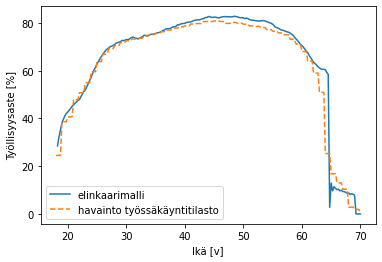

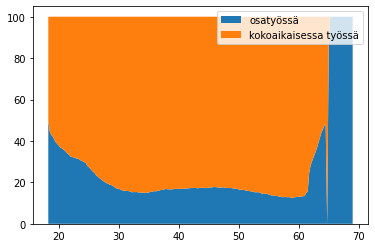

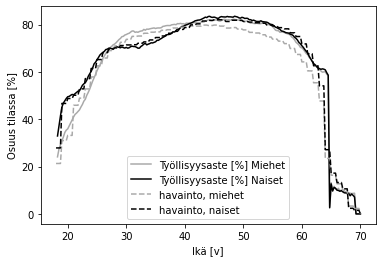

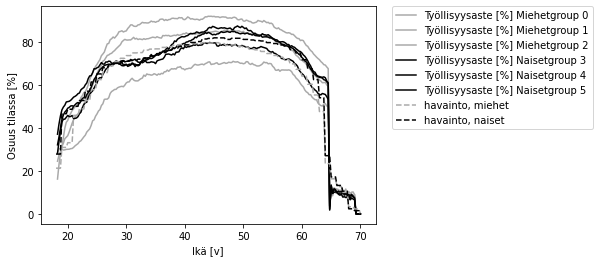

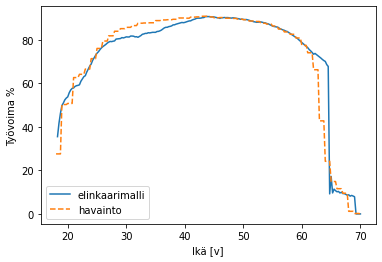

Tilaan 0 menetetty palkkasumma 4,418,909,381.31 ja työpanoksen arvo 9,279,709,700.75
Tilan 1 palkkasumma 83,274,948,638.21 ja työpanoksen arvo 174,877,392,140.23
Tilaan 2 menetetty palkkasumma 8,253,857,020.96 ja työpanoksen arvo 17,333,099,744.02
Tilaan 3 menetetty palkkasumma 4,041,304,477.28 ja työpanoksen arvo 8,486,739,402.30
Tilaan 4 menetetty palkkasumma 264,032,875.12 ja työpanoksen arvo 554,469,037.76
Tilaan 5 menetetty palkkasumma 1,208,649,968.49 ja työpanoksen arvo 2,538,164,933.84
Tilaan 6 menetetty palkkasumma 179,963,067.01 ja työpanoksen arvo 377,922,440.72
Tilaan 7 menetetty palkkasumma 1,186,391,188.80 ja työpanoksen arvo 2,491,421,496.48
Tilan 8 palkkasumma 628,368,069.22 ja työpanoksen arvo 1,319,572,945.36
Tilan 9 palkkasumma 0.00 ja työpanoksen arvo 0.00
Tilan 10 palkkasumma 10,608,702,492.17 ja työpanoksen arvo 22,278,275,233.56
Tilaan 11 menetetty palkkasumma 1,234,489,546.67 ja työpanoksen arvo 2,592,428,048.00
Tilaan 12 menetetty palkkasumma 6,181,517,025.16 j

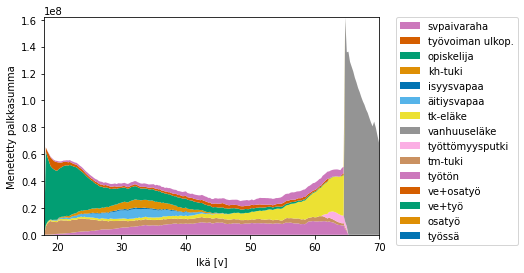

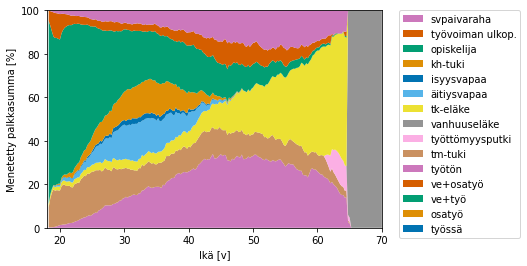

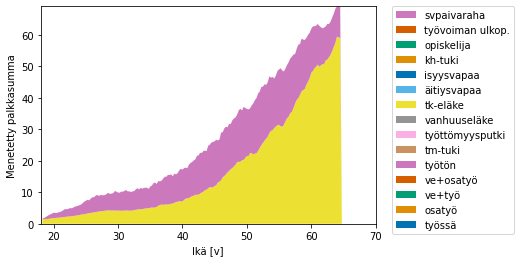

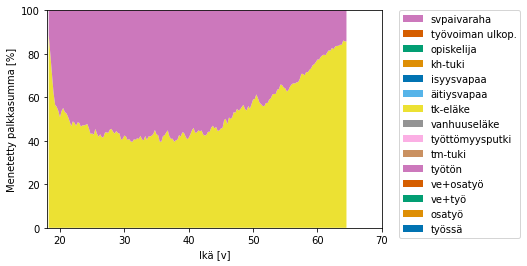

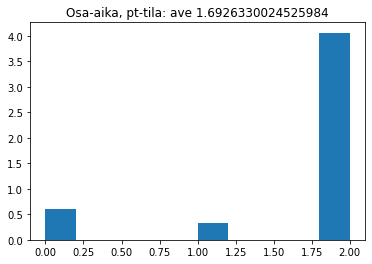

...

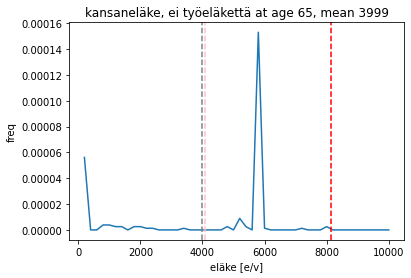

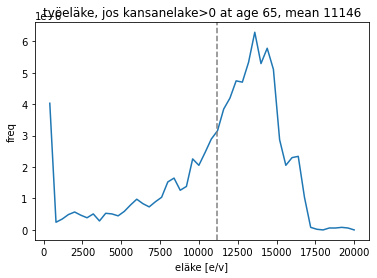

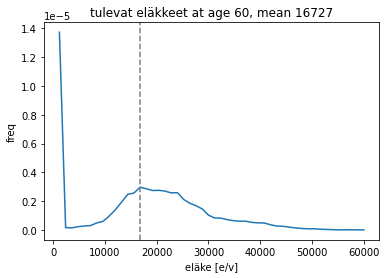

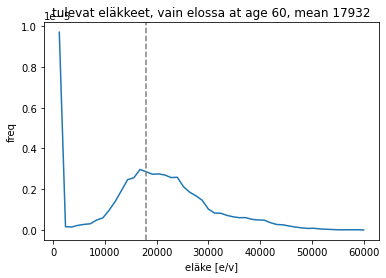

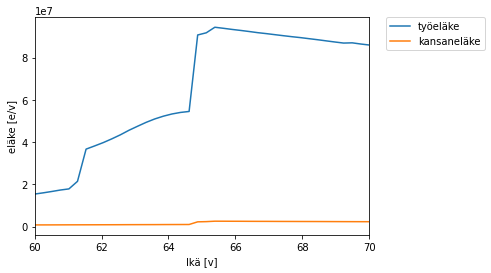

työeläkemeno alle 63: 2945090405.28 vs tilasto 1807.10
työeläkemeno yli 63: 26717315102.55 vs tilasto 24227.20
kansaneläkemeno alle 63: 320840806.36 vs tilasto 679.60
kansaneläkemeno yli 63: 652809992.16 vs tilasto 1419.90


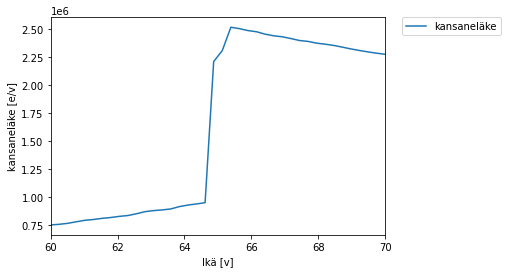

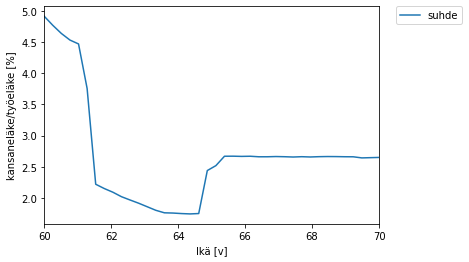

Työkyvyttömyyseläkkeisiin menetetty palkkasumma 3,932,368,135.31 ja työpanoksen arvo 8,375,944,128.20


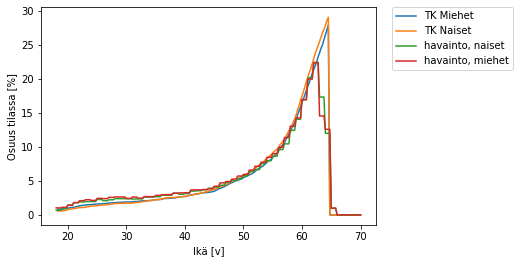

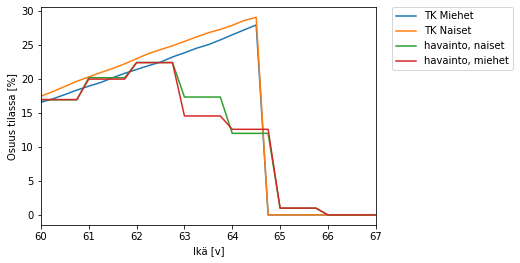

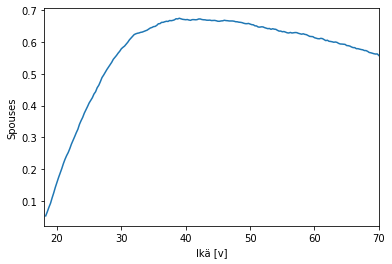

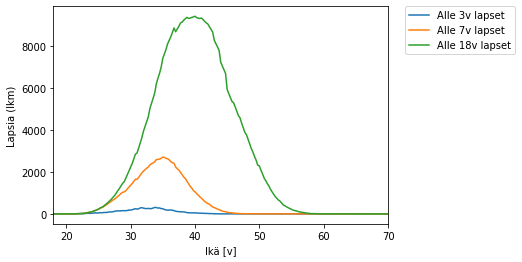

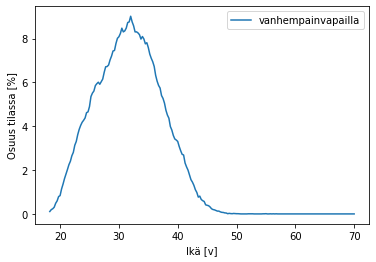

...

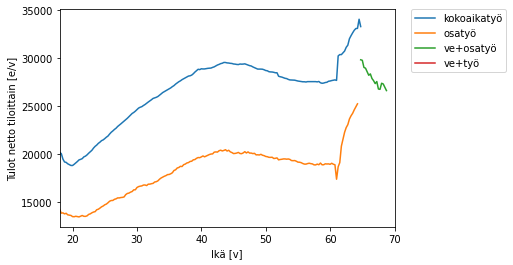

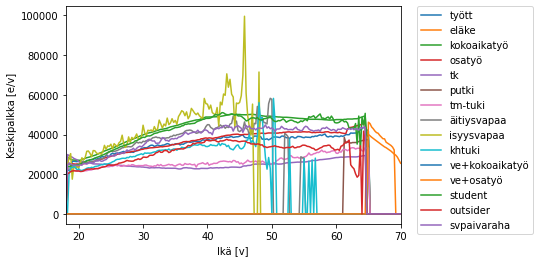

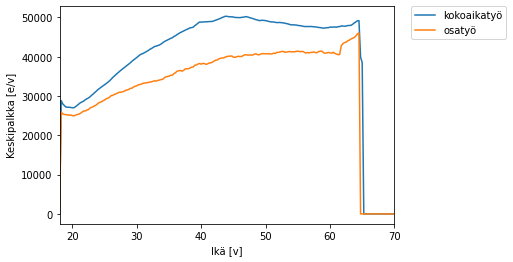

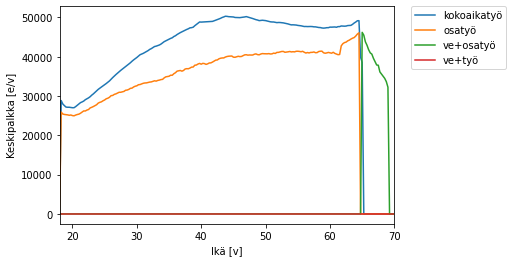

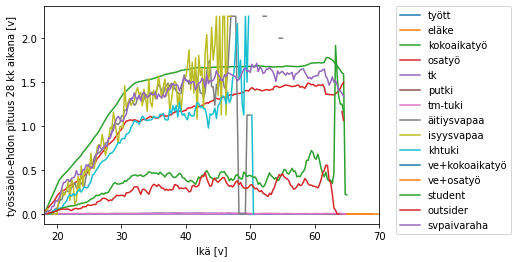

Keskikestot käytettyjen ansiosidonnaisten päivärahojen mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.53 |      0.32 |       0.15 |      0.00 |        0.00 |
| 30-39 |     0.51 |      0.31 |       0.18 |      0.00 |        0.00 |
| 40-49 |     0.49 |      0.32 |       0.19 |      0.00 |        0.00 |
| 50-59 |     0.47 |      0.33 |       0.21 |      0.00 |        0.00 |
| 60-65 |     0.23 |      0.20 |       0.17 |      0.13 |        0.27 |
+-------+----------+-----------+------------+-----------+-------------+
Keskikestot viimeisimmän työttömyysjakson mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.90 |     

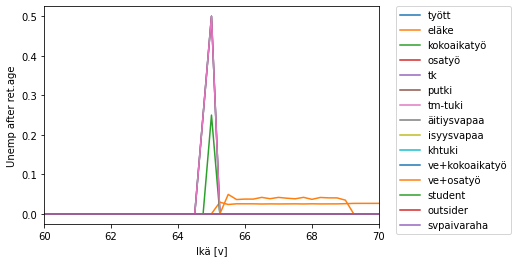

Lisäpäivillä on 9334 henkilöä


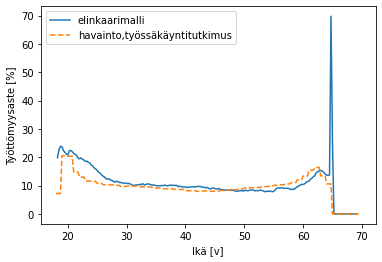

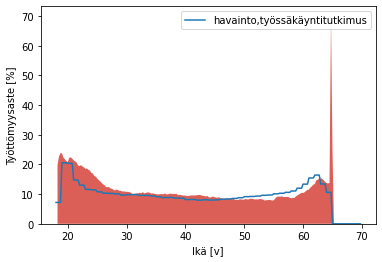

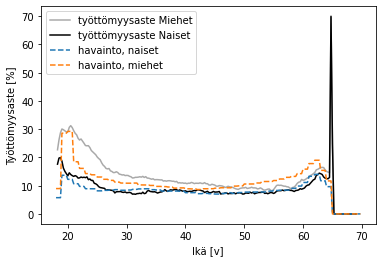

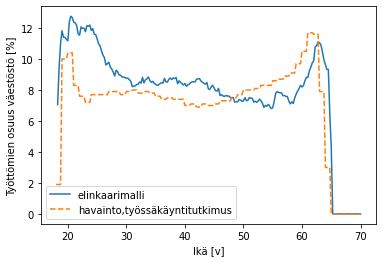

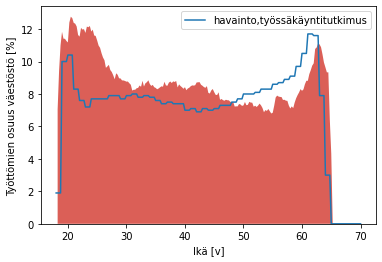

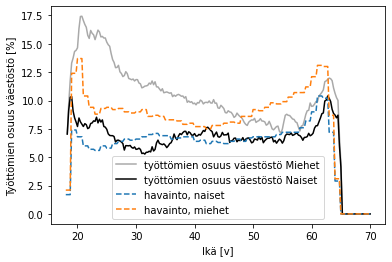

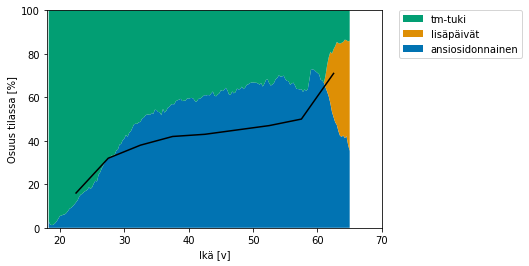

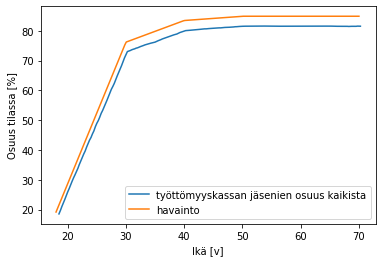

Kassanjäseniä min 18.545927 % max 81.569554 %


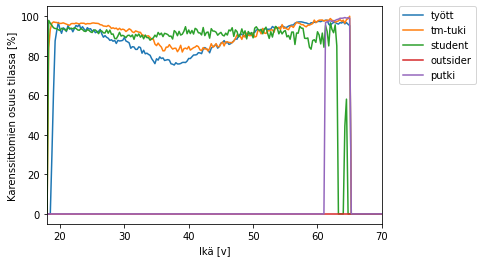

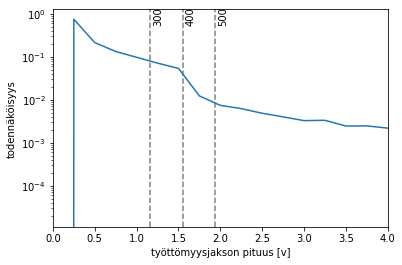

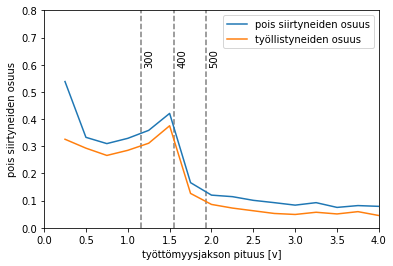

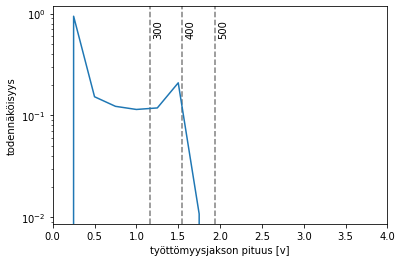

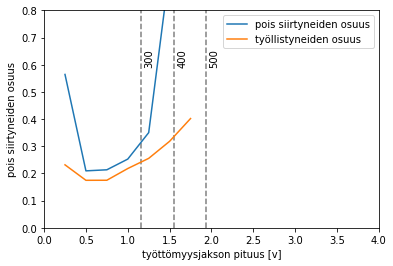

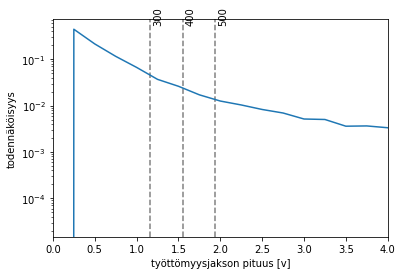

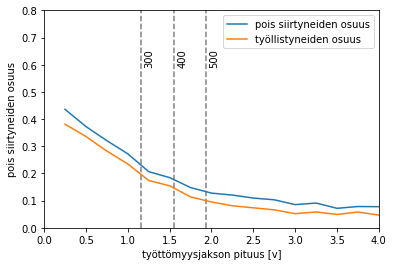

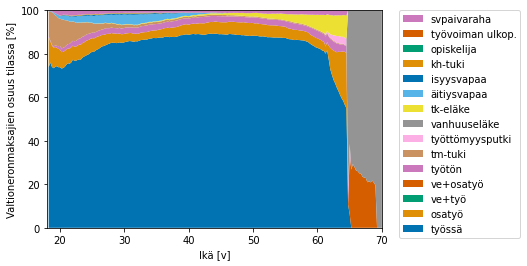

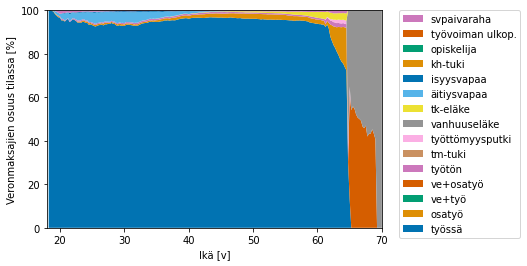

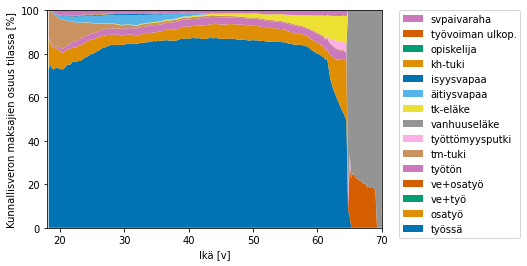

Valtionveron maksajien osuus
Etuudella olevat 3.22
Työssä 87.86
Eläkkeellä 9.99

Kunnallisveron maksajien osuus
Etuudella olevat 6.10
Työssä 72.17
Eläkkeellä 21.45

Veronmaksajien osuus
Etuudella olevat 5.62
Työssä 74.78
Eläkkeellä 19.54



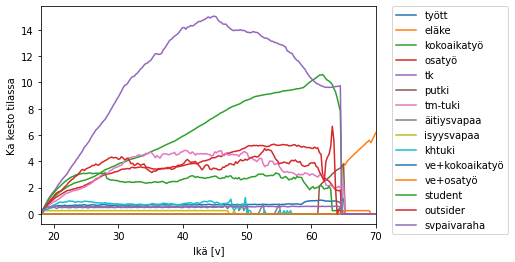

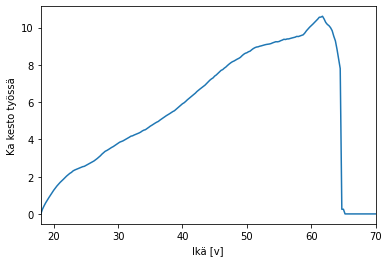

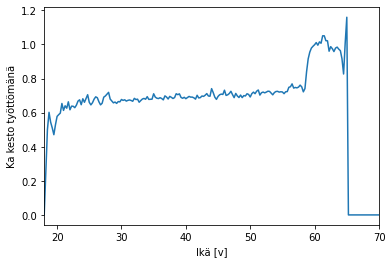

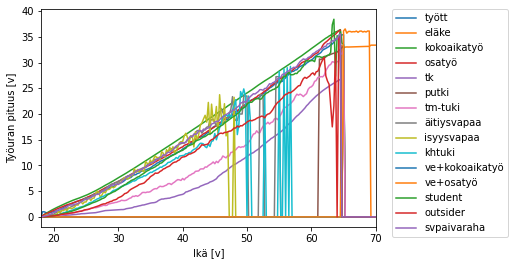

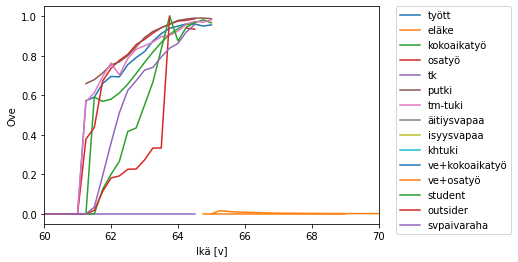

...

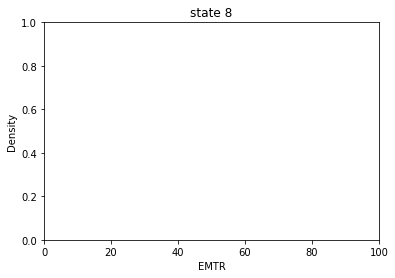

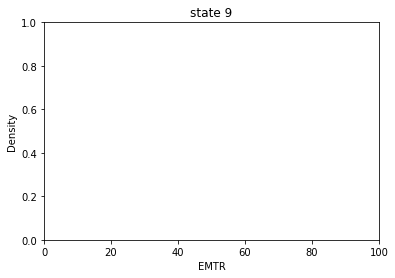

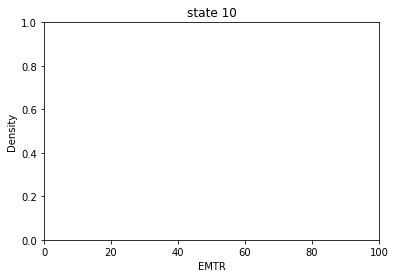

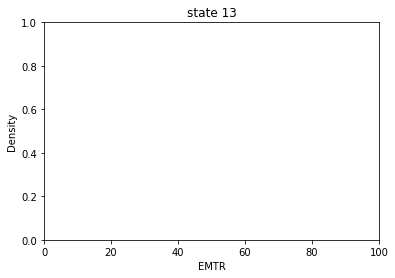

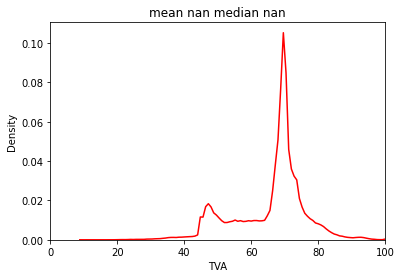

kaikki: työttömyysloukussa (80 %) 0.0


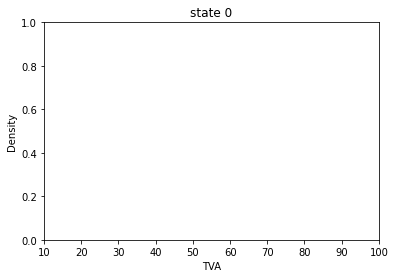

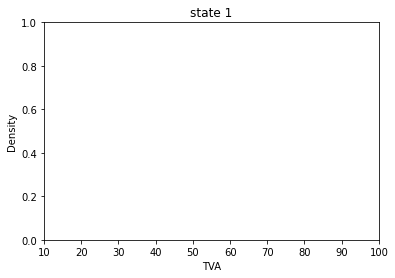

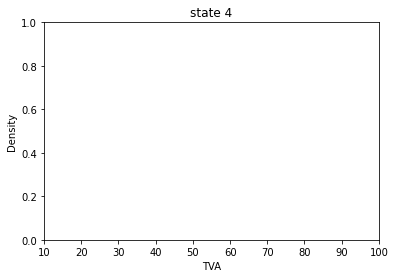

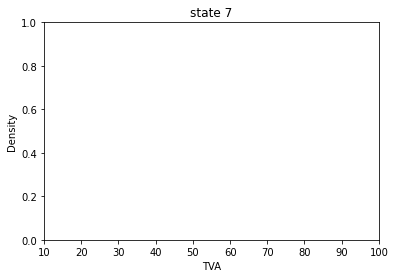

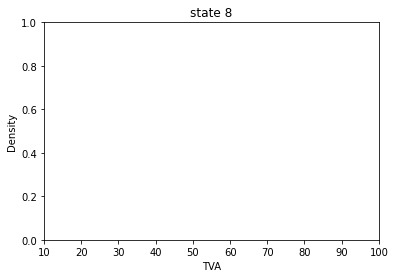

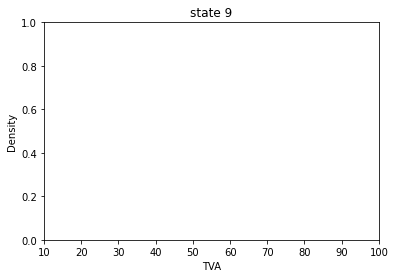

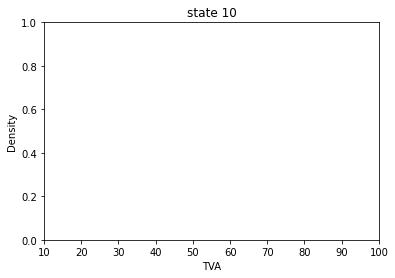

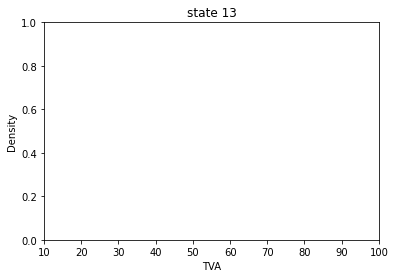

0: työttömyysloukussa (80 %) 0.0
1: työttömyysloukussa (80 %) 0.0
4: työttömyysloukussa (80 %) 0.0
7: työttömyysloukussa (80 %) 0.0
8: työttömyysloukussa (80 %) 0.0
9: työttömyysloukussa (80 %) 0.0
10: työttömyysloukussa (80 %) 0.0
13: työttömyysloukussa (80 %) 0.0


In [35]:
cc2022.load_sim(load=results2022)
cc2022.render()

Mortality included, not stopped
disability rate from year 2020
student year 2020
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 64.0
max_retirementage 69
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_perus_2020 version 5
2022 reward 13.523659779339413 netincome 22105.50 eq 16612.507 initial 11.071354677734742
2020 reward 13.544350451081105 netincome 21521.47 eq 16467.365 initial 11.047527641571422
Rahavirrat skaalattuna väestötasolle
+---------------------------+----------------------+----------------------+---------------------+
|                      

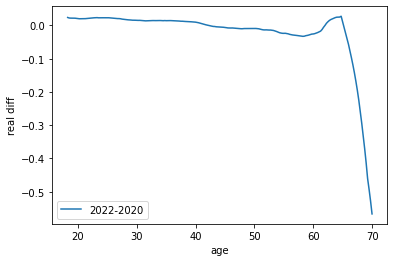

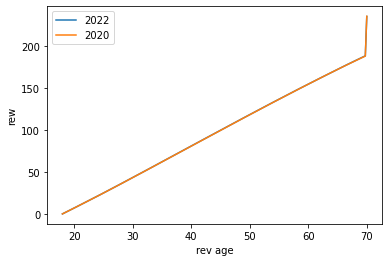

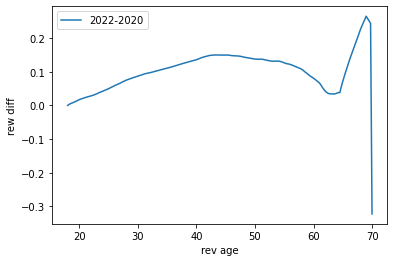

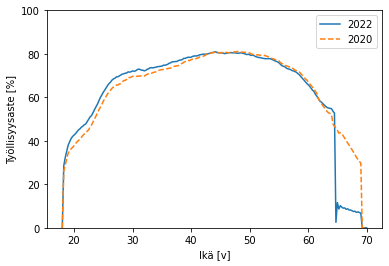

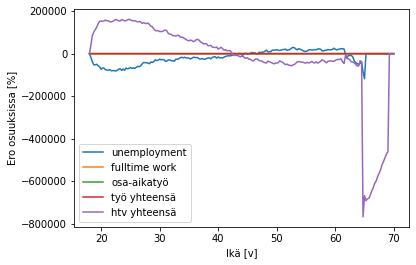

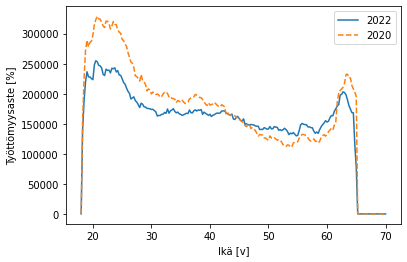

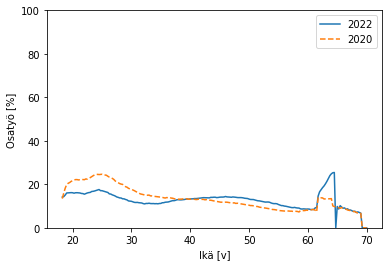

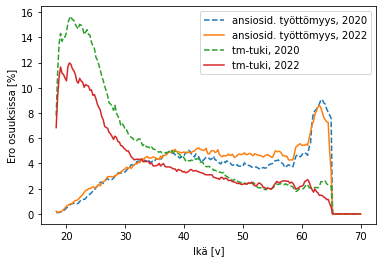

Työllisyysvaikutus 21-60-vuotiaisiin noin 48640 htv ja 32628 työllistä
- kokoaikaisiin 21-60-vuotiailla noin 64653 työllistä (1645103 vs 1580451)
- osa-aikaisiin 21-60-vuotiailla noin -32025 työllistä (350117 vs 382143)
Työllisiä 1820162 vs 1771522 htv
Työllisyysastevaikutus 21-60-vuotiailla noin 1.20 prosenttia (73.09 vs 71.89)
- kokoaikaisiin 21-60-vuotiailla noin 1.92 prosenttia (82.45 vs 80.53)
- osa-aikaisiin 21-60-vuotiailla noin -1.92 prosenttia (17.55 vs 19.47)
Työttömyysvaikutus 21-60-vuotiaisiin noin -28603 htv
- ansiosidonnaiseen 21-60-vuotiailla noin 8420 htv (130050 vs 121630)
- tm-tukeen 21-60-vuotiailla noin -38307 työllistä (140351 vs 178657)
- putkeen 21-60-vuotiailla noin 1283 työllistä (8489 vs 7206)
epävarmuus työllisyysasteissa 0.0139, hajonta 0.0835


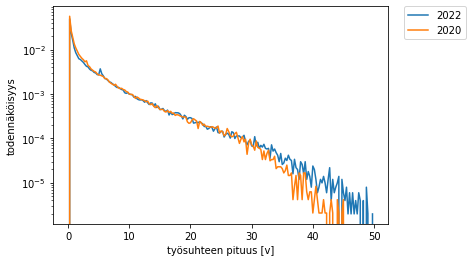

Jakauma ansiosidonnainen+tmtuki+putki, no max age
2022 keskikesto 0.7798178264437822 v 2020 keskikesto 0.8845436518570127 v
Skaalaamaton 2022 lkm 92604 v 2020 lkm 93295 v
Skaalaamaton 2022 työtpäiviä yht 72214.25 v 2020 työtpäiviä yht 82523.5 v


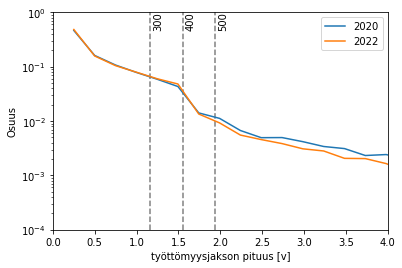

2022 keskikesto 0.7798178264437822 v 2020 keskikesto 0.8845436518570127 v
Skaalaamaton 2022 lkm 92604 v 2020 lkm 93295 v
Skaalaamaton 2022 työtpäiviä yht 72214.25 v 2020 työtpäiviä yht 82523.5 v


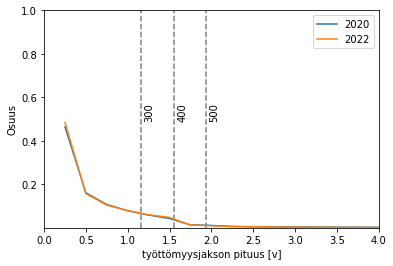

2022 keskikesto 0.7798178264437822 v 2020 keskikesto 0.8845436518570127 v
Skaalaamaton 2022 lkm 92604 v 2020 lkm 93295 v
Skaalaamaton 2022 työtpäiviä yht 72214.25 v 2020 työtpäiviä yht 82523.5 v


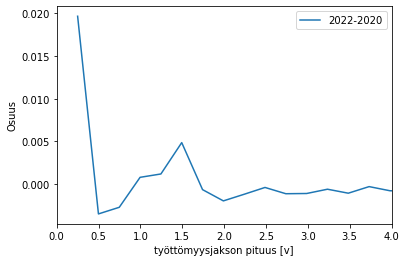

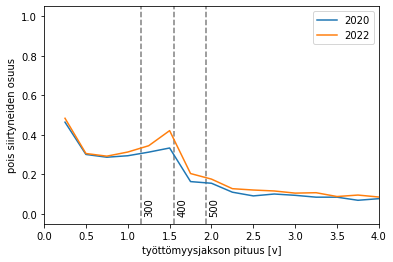

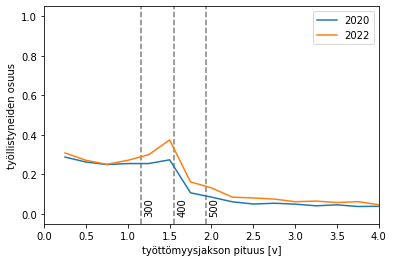

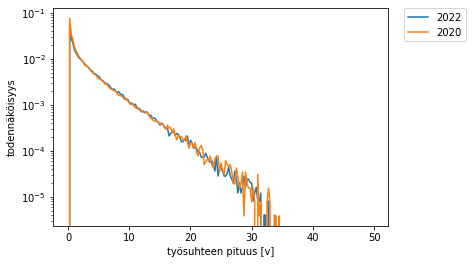

Jakauma ansiosidonnainen+tmtuki+putki, max age 54
2022 keskikesto 0.7273081819089456 v 2020 keskikesto 0.8427215740901968 v
Skaalaamaton 2022 lkm 80128 v 2020 lkm 80402 v
Skaalaamaton 2022 työtpäiviä yht 58277.75 v 2020 työtpäiviä yht 67756.5 v


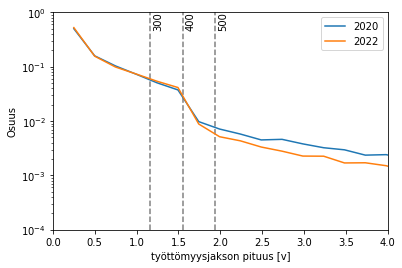

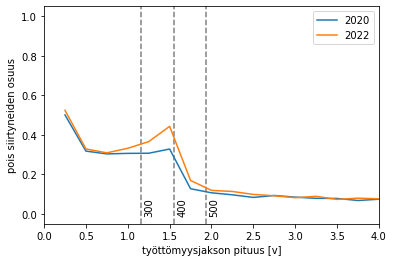

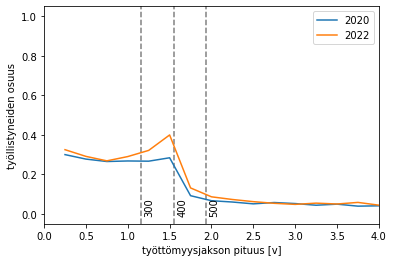

2020
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.53 |      0.32 |       0.15 |      0.00 |        0.00 |
| 30-39 |     0.51 |      0.31 |       0.18 |      0.00 |        0.00 |
| 40-49 |     0.49 |      0.32 |       0.19 |      0.00 |        0.00 |
| 50-59 |     0.47 |      0.33 |       0.21 |      0.00 |        0.00 |
| 60-65 |     0.23 |      0.20 |       0.17 |      0.13 |        0.27 |
+-------+----------+-----------+------------+-----------+-------------+
2022
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.52 |      0.33 |       0.15 |      0.00 |        0.00 |
| 30-39 |     0.49 |      0.32 |       0.19 |      0.0

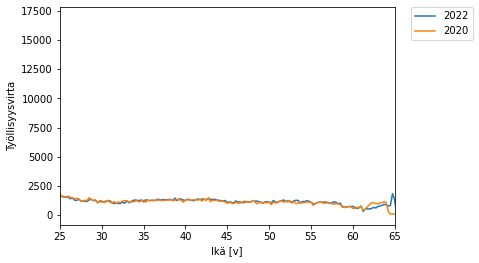

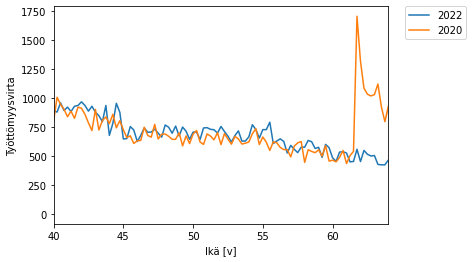

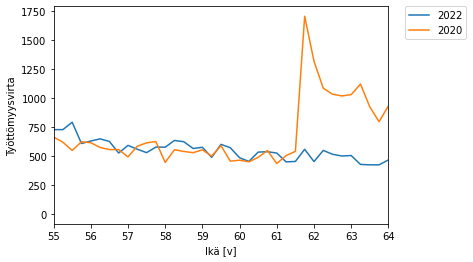

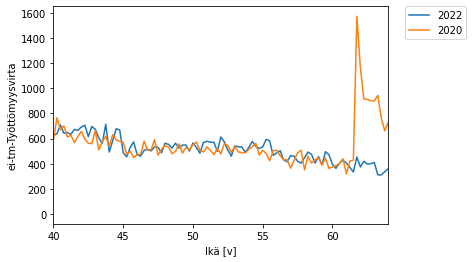

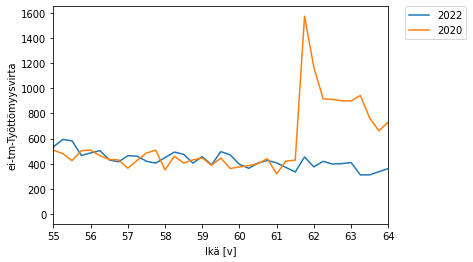

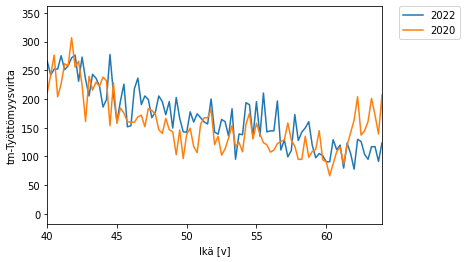

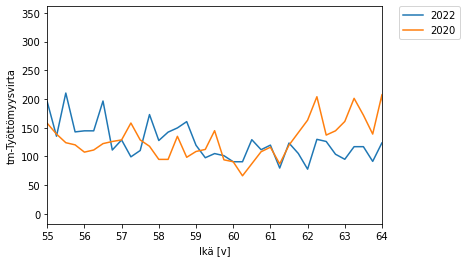

In [36]:
cc2020=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
              plotdebug=plotdebug,year=2020)
cc2020.load_sim(load=results2020)
cc2022.compare_with(cc2020,label1='2022',label2='2020',figname='vuosivertailu')
del cc2020
del cc2022

# 2023

In [37]:
cc2023=Lifecycle(env=model,mortality=mortality,perustulo=False,include_putki=True,library=library,
                 plotdebug=plotdebug,year=2023,include_ove=include_ove,unemp_limit_reemp=unemp_limit_reemp,
                 silent=False,include_emtr=include_emtr)

Mortality included, not stopped
disability rate from year 2023
student year 2023
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 64.75
max_retirementage 69
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400



In [38]:
if run2023:
    cc2023.run_results(debug=debug,steps1=size1,steps2=size2,pop=pop_size,deterministic=deterministic,
                    train=True,predict=True,batch1=batch1,batch2=batch2,gae_lambda=gae_lambda,
                    learning_rate=learning_rate,learning_schedule=schedule,
                    save=malli2023,cont=cont,start_from=malli2023,results=results2023,
                    callback_minsteps=callback_minsteps,rlmodel=rlmodel,twostage=twostage,
                    log_interval=1000)

Loading results from results/v5_perus_2023 version 5


Ave net income 21,101.39 Ave equivalent net income 15,410.26
Rahavirrat skaalattuna väestötasolle
+---------------------------+----------------------+--------------------+--------------------+
|                           |                  e/v |            toteuma |                ero |
|---------------------------+----------------------+--------------------+--------------------|
| tyotulosumma              | 85,139,118,633.48    |  97,603,000,000.00 | -12,463,881,366.52 |
| tyotulosumma eielakkeella | 84,813,279,949.10    |                nan |                nan |
| etuusmeno                 | 46,002,715,083.93    |  42,992,887,874.00 |   3,009,827,209.93 |
| verot+maksut              | 32,423,108,657.69    |  36,932,257,000.00 |  -4,509,148,342.31 |
| verot+maksut+alv          | 48,921,046,666.68    |  57,149,257,000.00 |  -8,228,210,333.32 |
| palkkaverot+maksut        | 25,097,122,187.21    |                nan |                nan |
| muut tulot                | -2,918,331,582.75


Sic! Työllisyysaste vastaa työvoimatilaston laskutapaa!
Työllisyysaste 18-64: 59.80%
Gini coefficient is 30.091 (havainto 27.800)

Sic! pienituloisuus lasketaan vain aikuisväestöstä!
Pienituloisuus 50%: 15.12%; 60%: 27.15%; abs 1000 e/kk 29.93%


Real discounted reward 13.438487695000061
Initial discounted reward 11.049693593417198


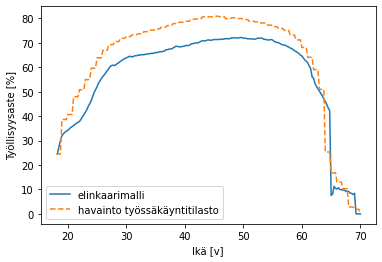

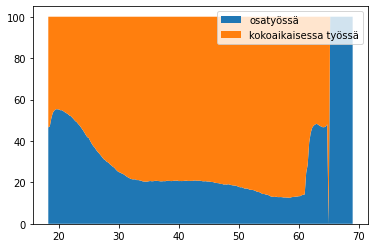

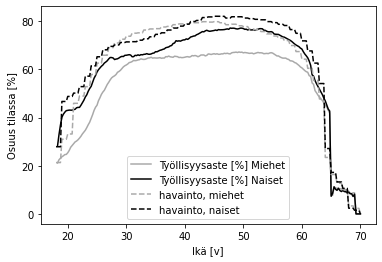

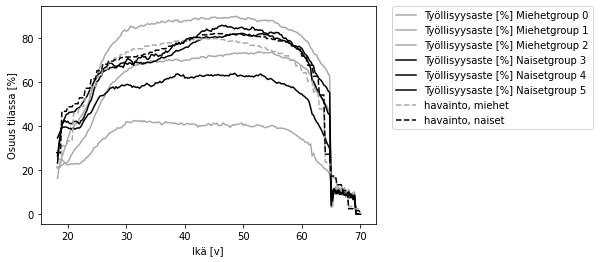

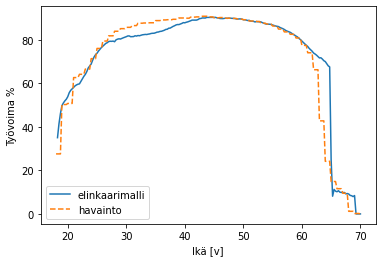

Tilaan 0 menetetty palkkasumma 3,853,150,166.98 ja työpanoksen arvo 8,091,615,350.66
Tilan 1 palkkasumma 73,140,869,968.91 ja työpanoksen arvo 153,595,826,934.72
Tilaan 2 menetetty palkkasumma 7,359,011,403.45 ja työpanoksen arvo 15,453,923,947.25
Tilaan 3 menetetty palkkasumma 3,687,941,902.22 ja työpanoksen arvo 7,744,677,994.65
Tilaan 4 menetetty palkkasumma 224,967,524.70 ja työpanoksen arvo 472,431,801.88
Tilaan 5 menetetty palkkasumma 1,173,748,426.38 ja työpanoksen arvo 2,464,871,695.39
Tilaan 6 menetetty palkkasumma 167,577,139.12 ja työpanoksen arvo 351,911,992.15
Tilaan 7 menetetty palkkasumma 1,238,328,115.42 ja työpanoksen arvo 2,600,489,042.38
Tilan 8 palkkasumma 325,838,684.39 ja työpanoksen arvo 684,261,237.21
Tilan 9 palkkasumma 0.00 ja työpanoksen arvo 0.00
Tilan 10 palkkasumma 11,672,409,980.18 ja työpanoksen arvo 24,512,060,958.38
Tilaan 11 menetetty palkkasumma 1,046,790,955.42 ja työpanoksen arvo 2,198,261,006.38
Tilaan 12 menetetty palkkasumma 6,152,615,339.47 ja 

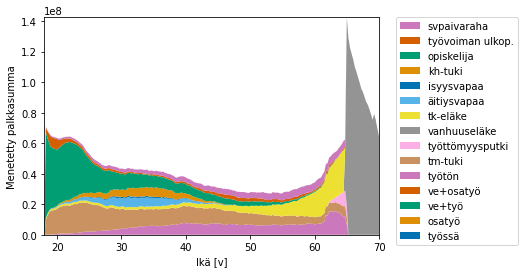

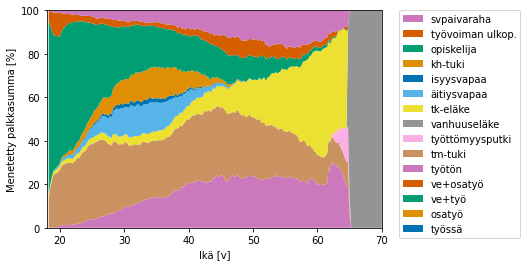

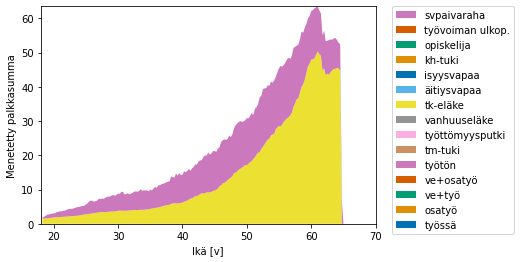

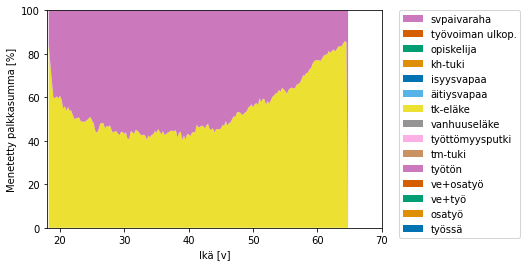

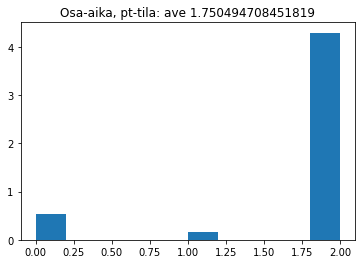

...

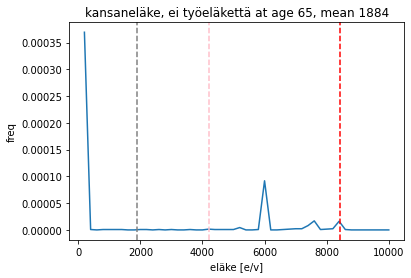

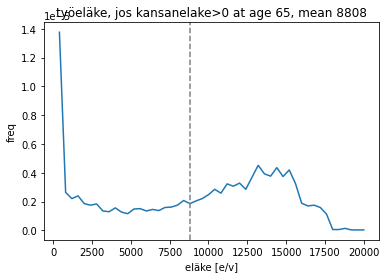

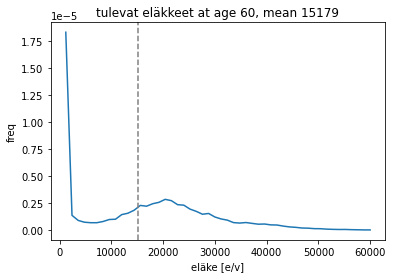

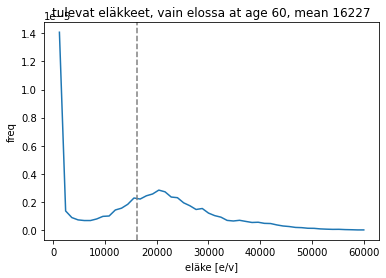

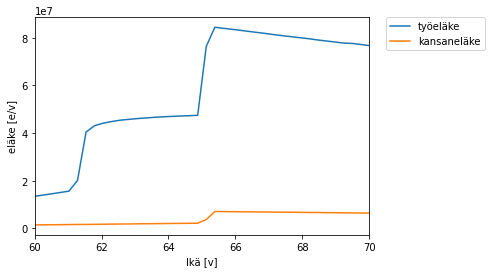

työeläkemeno alle 63: 2754590820.51 vs tilasto 1807.10
työeläkemeno yli 63: 23911408562.47 vs tilasto 24227.20
kansaneläkemeno alle 63: 464898974.97 vs tilasto 679.60
kansaneläkemeno yli 63: 1818262655.81 vs tilasto 1419.90


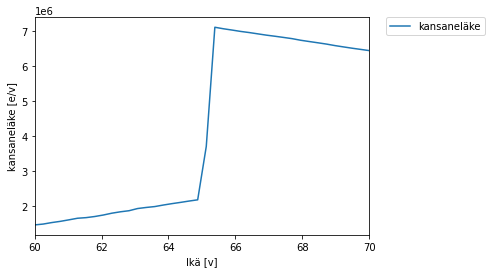

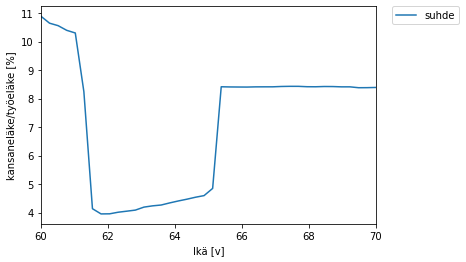

Työkyvyttömyyseläkkeisiin menetetty palkkasumma 3,687,941,902.22 ja työpanoksen arvo 7,855,316,251.72


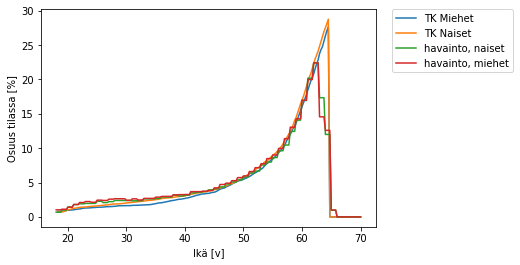

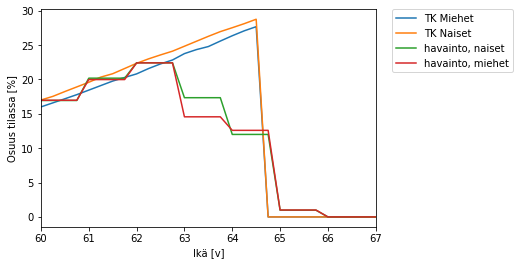

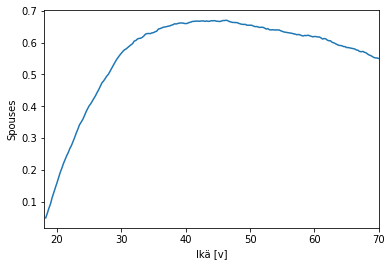

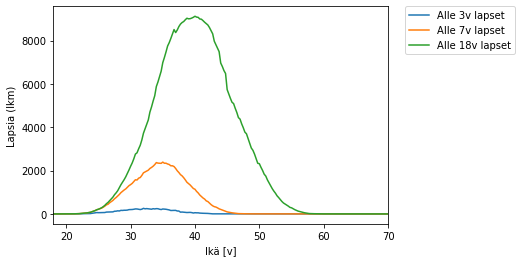

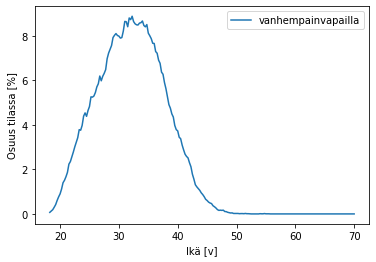

...

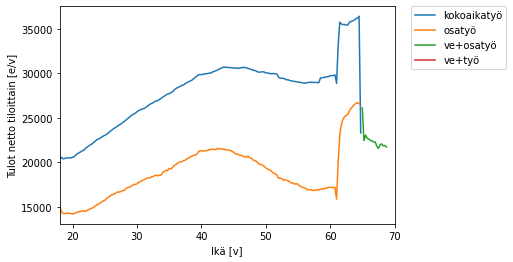

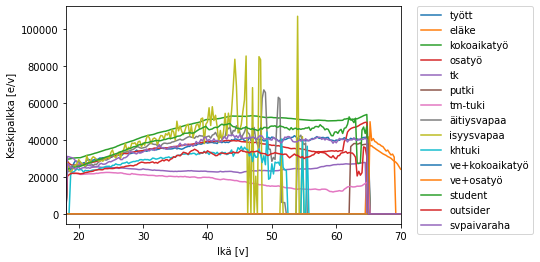

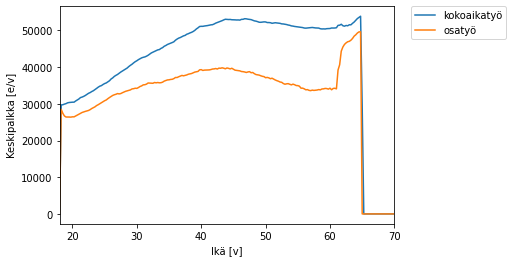

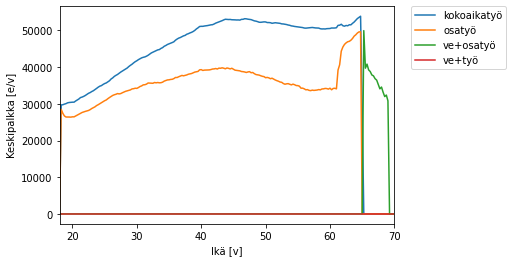

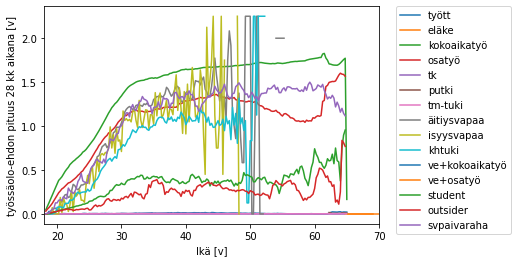

Keskikestot käytettyjen ansiosidonnaisten päivärahojen mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.59 |      0.29 |       0.12 |      0.00 |        0.00 |
| 30-39 |     0.55 |      0.29 |       0.17 |      0.00 |        0.00 |
| 40-49 |     0.53 |      0.29 |       0.18 |      0.00 |        0.00 |
| 50-59 |     0.53 |      0.29 |       0.17 |      0.00 |        0.00 |
| 60-65 |     0.29 |      0.21 |       0.17 |      0.14 |        0.20 |
+-------+----------+-----------+------------+-----------+-------------+
Keskikestot viimeisimmän työttömyysjakson mukaan
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.94 |     

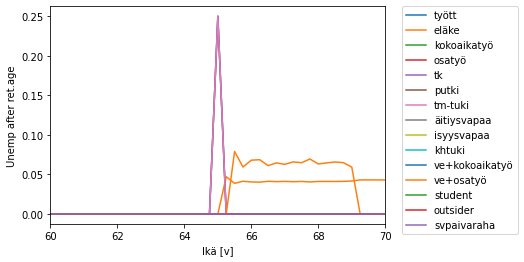

Lisäpäivillä on 7660 henkilöä


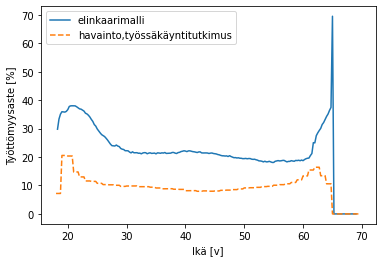

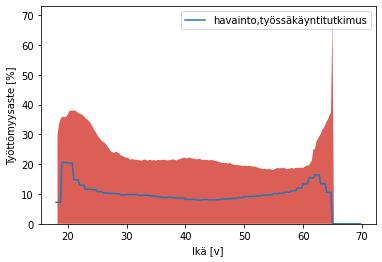

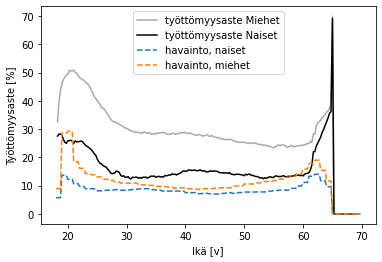

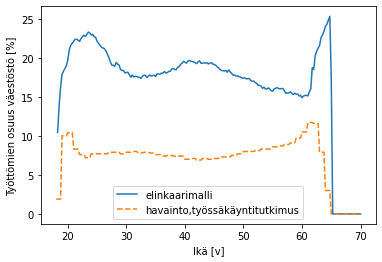

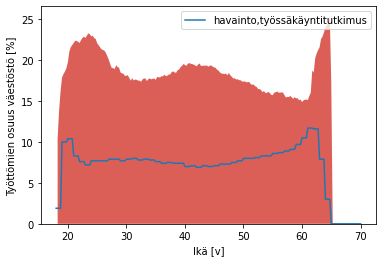

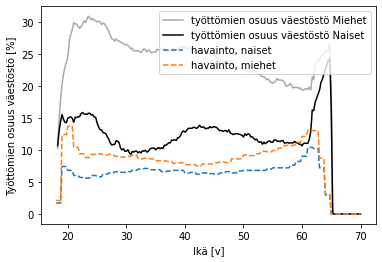

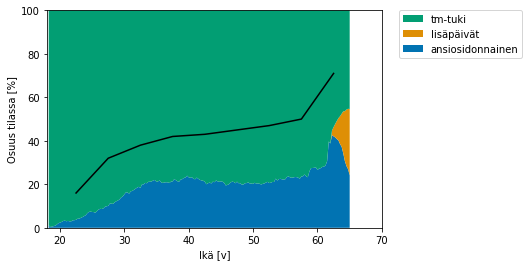

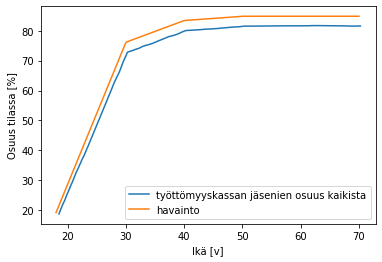

Kassanjäseniä min 18.716872 % max 81.730821 %


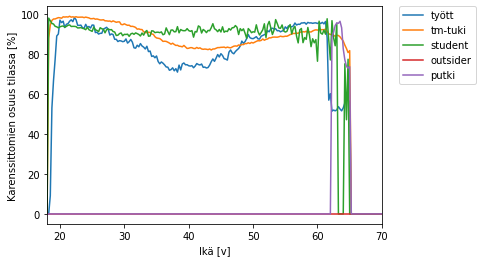

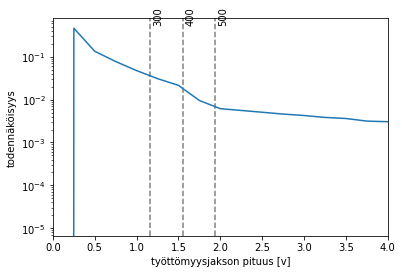

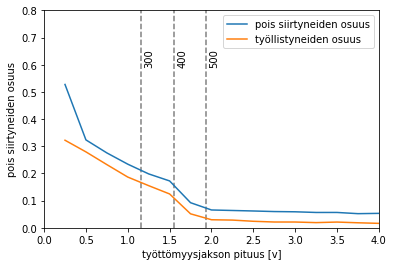

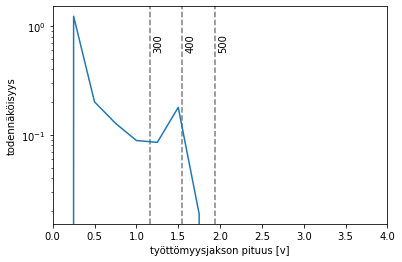

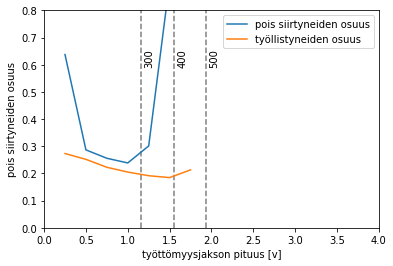

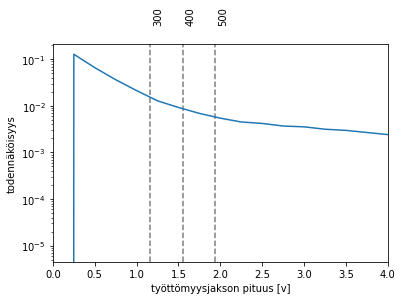

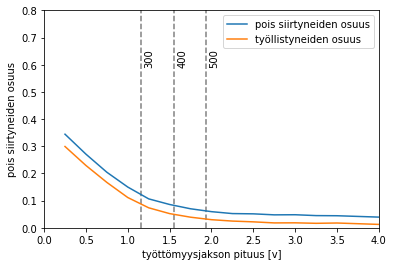

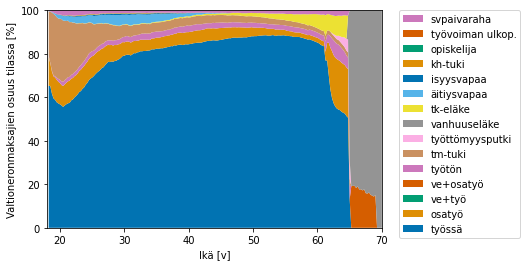

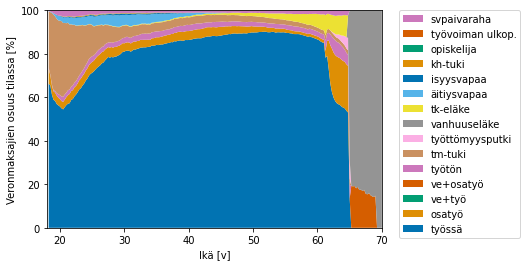

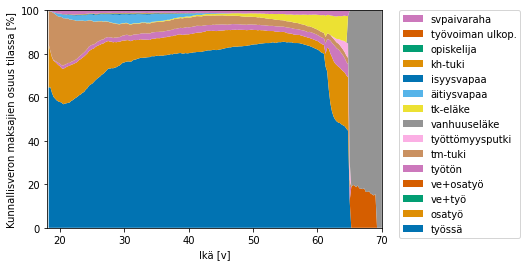

Valtionveron maksajien osuus
Etuudella olevat 7.37
Työssä 72.92
Eläkkeellä 19.22

Kunnallisveron maksajien osuus
Etuudella olevat 8.32
Työssä 71.84
Eläkkeellä 19.27

Veronmaksajien osuus
Etuudella olevat 7.68
Työssä 72.57
Eläkkeellä 19.23



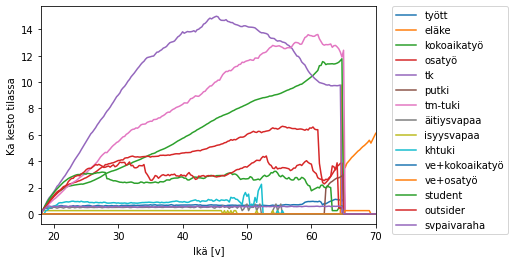

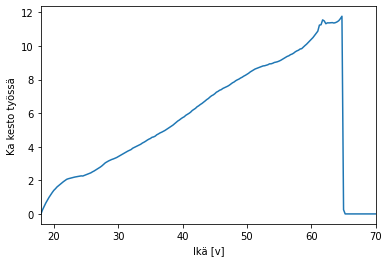

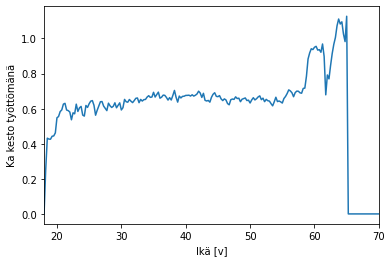

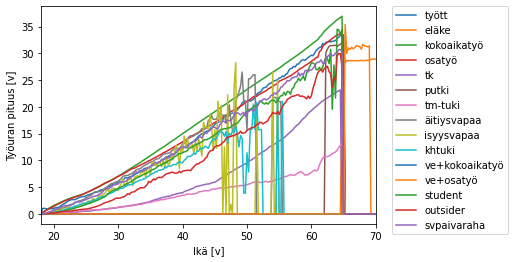

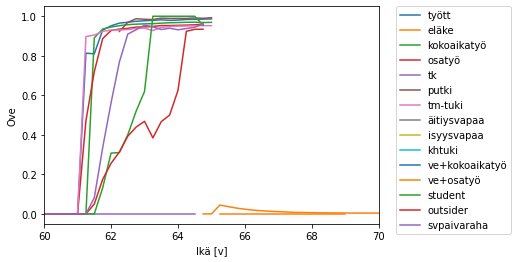

...

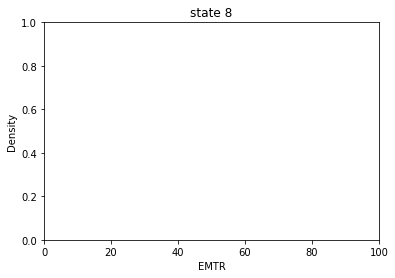

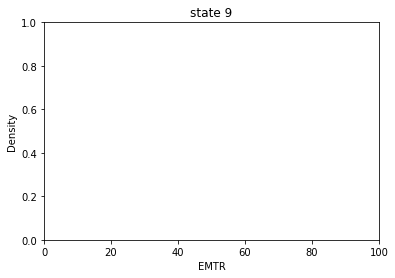

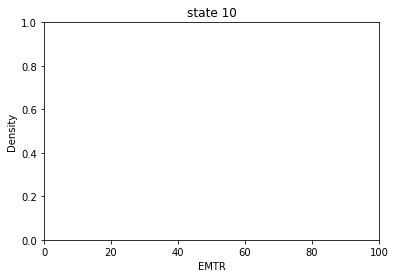

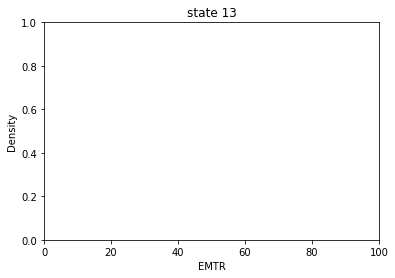

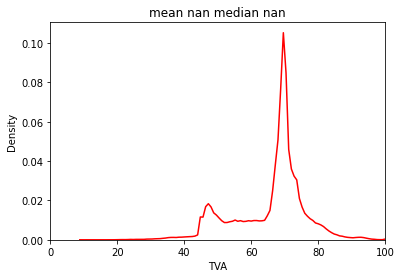

kaikki: työttömyysloukussa (80 %) 0.0


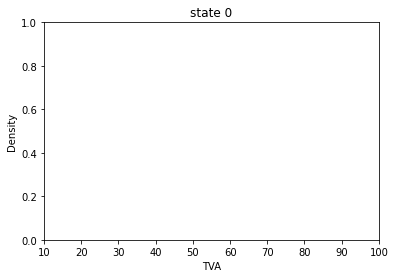

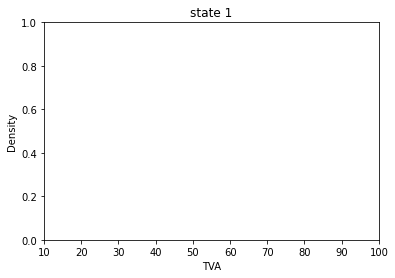

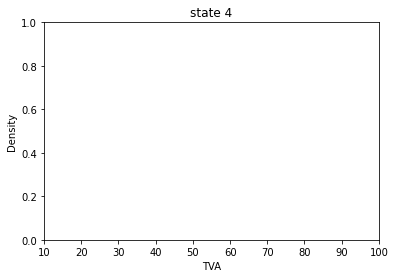

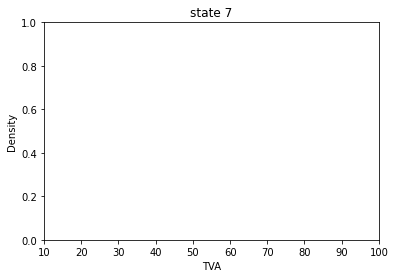

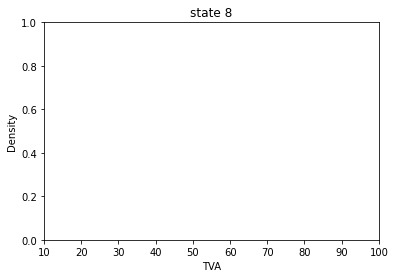

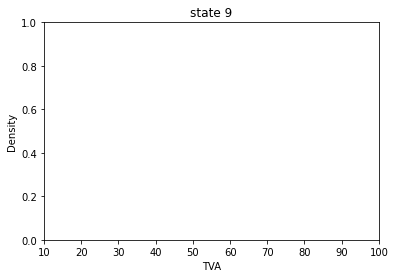

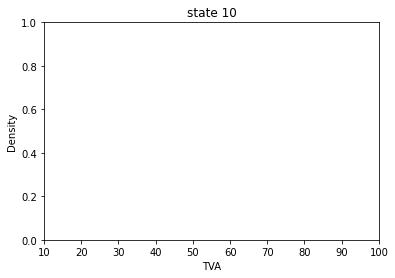

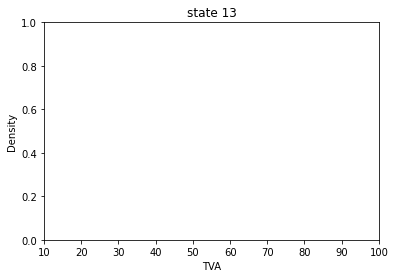

0: työttömyysloukussa (80 %) 0.0
1: työttömyysloukussa (80 %) 0.0
4: työttömyysloukussa (80 %) 0.0
7: työttömyysloukussa (80 %) 0.0
8: työttömyysloukussa (80 %) 0.0
9: työttömyysloukussa (80 %) 0.0
10: työttömyysloukussa (80 %) 0.0
13: työttömyysloukussa (80 %) 0.0


In [39]:
cc2023.load_sim(load=results2023)
cc2023.render()

Mortality included, not stopped
disability rate from year 2020
student year 2020
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 64.0
max_retirementage 69
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_perus_2020 version 5
2023 reward 13.438487695000061 netincome 21101.39 eq 15410.262 initial 11.049693593417198
2020 reward 13.544350451081105 netincome 21521.47 eq 16467.365 initial 11.047527641571422
Rahavirrat skaalattuna väestötasolle
+---------------------------+----------------------+----------------------+-----------------------+
|                    

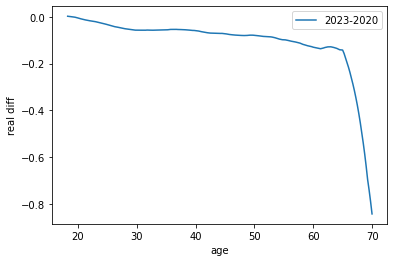

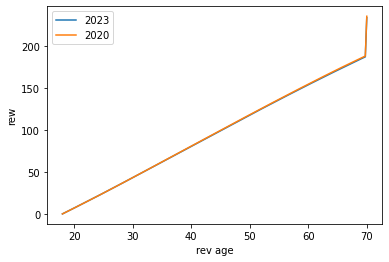

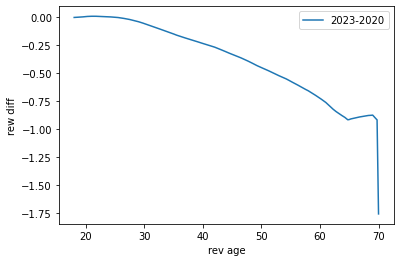

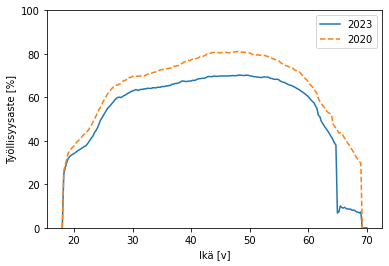

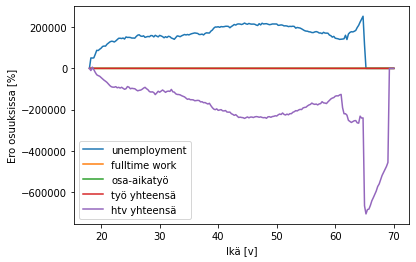

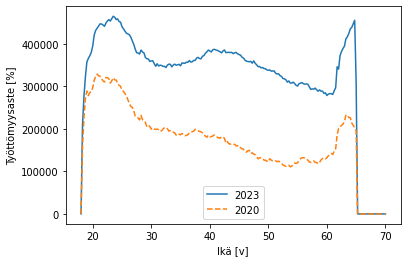

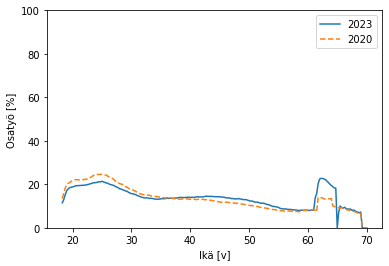

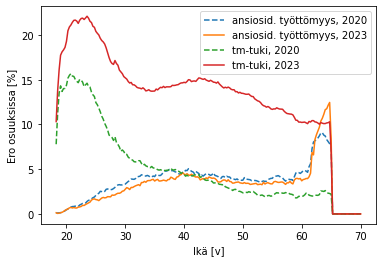

Työllisyysvaikutus 21-60-vuotiaisiin noin -227575 htv ja -227785 työllistä
- kokoaikaisiin 21-60-vuotiailla noin -227365 työllistä (1353086 vs 1580451)
- osa-aikaisiin 21-60-vuotiailla noin -420 työllistä (381723 vs 382143)
Työllisiä 1543947 vs 1771522 htv
Työllisyysastevaikutus 21-60-vuotiailla noin -8.34 prosenttia (63.55 vs 71.89)
- kokoaikaisiin 21-60-vuotiailla noin -2.53 prosenttia (78.00 vs 80.53)
- osa-aikaisiin 21-60-vuotiailla noin 2.53 prosenttia (22.00 vs 19.47)
Työttömyysvaikutus 21-60-vuotiaisiin noin 280667 htv
- ansiosidonnaiseen 21-60-vuotiailla noin -11013 htv (110617 vs 121630)
- tm-tukeen 21-60-vuotiailla noin 291957 työllistä (470615 vs 178657)
- putkeen 21-60-vuotiailla noin -278 työllistä (6928 vs 7206)
epävarmuus työllisyysasteissa 0.0139, hajonta 0.0837


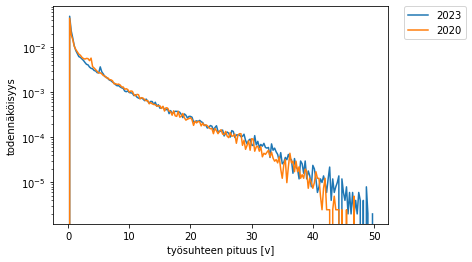

Jakauma ansiosidonnainen+tmtuki+putki, no max age
2023 keskikesto 1.6140791642668468 v 2020 keskikesto 0.8845436518570127 v
Skaalaamaton 2023 lkm 100702 v 2020 lkm 93295 v
Skaalaamaton 2023 työtpäiviä yht 162541.0 v 2020 työtpäiviä yht 82523.5 v


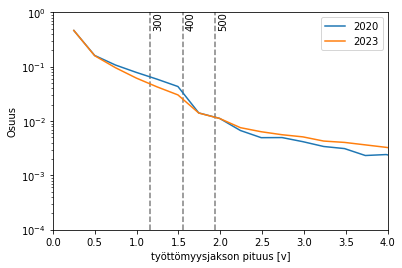

2023 keskikesto 1.6140791642668468 v 2020 keskikesto 0.8845436518570127 v
Skaalaamaton 2023 lkm 100702 v 2020 lkm 93295 v
Skaalaamaton 2023 työtpäiviä yht 162541.0 v 2020 työtpäiviä yht 82523.5 v


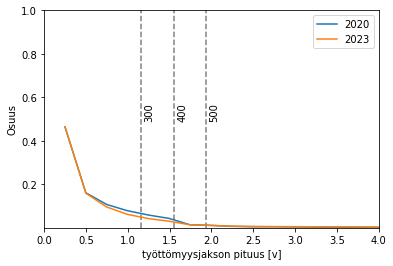

2023 keskikesto 1.6140791642668468 v 2020 keskikesto 0.8845436518570127 v
Skaalaamaton 2023 lkm 100702 v 2020 lkm 93295 v
Skaalaamaton 2023 työtpäiviä yht 162541.0 v 2020 työtpäiviä yht 82523.5 v


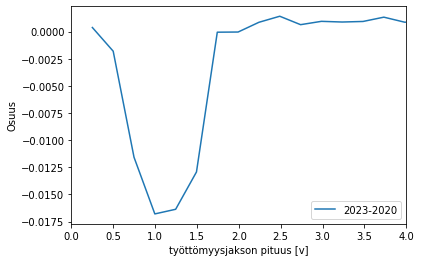

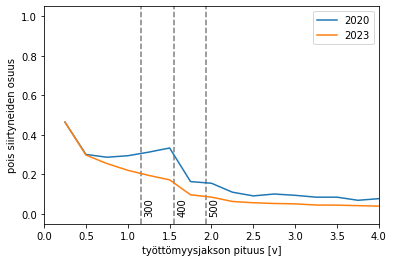

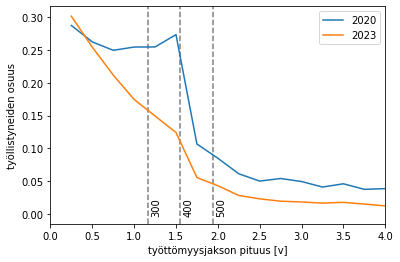

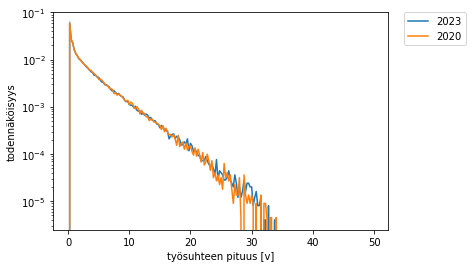

Jakauma ansiosidonnainen+tmtuki+putki, max age 54
2023 keskikesto 1.2105722970870534 v 2020 keskikesto 0.8427215740901968 v
Skaalaamaton 2023 lkm 83558 v 2020 lkm 80402 v
Skaalaamaton 2023 työtpäiviä yht 101153.0 v 2020 työtpäiviä yht 67756.5 v


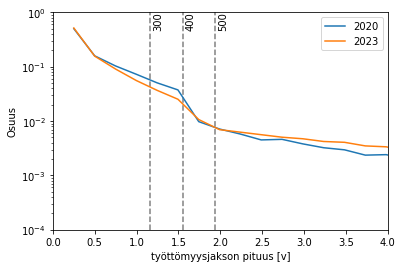

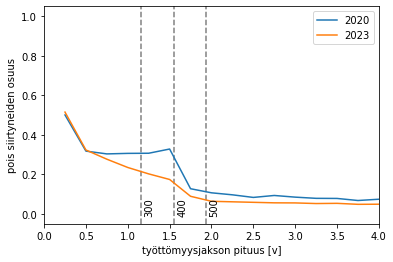

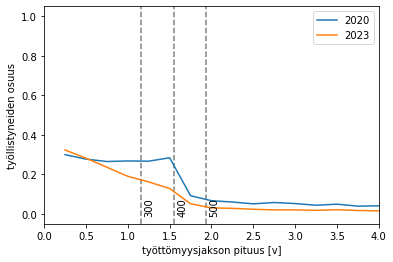

2020
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.59 |      0.29 |       0.12 |      0.00 |        0.00 |
| 30-39 |     0.55 |      0.29 |       0.17 |      0.00 |        0.00 |
| 40-49 |     0.53 |      0.29 |       0.18 |      0.00 |        0.00 |
| 50-59 |     0.53 |      0.29 |       0.17 |      0.00 |        0.00 |
| 60-65 |     0.29 |      0.21 |       0.17 |      0.14 |        0.20 |
+-------+----------+-----------+------------+-----------+-------------+
2023
+-------+----------+-----------+------------+-----------+-------------+
|       |   0-6 kk |   6-12 kk |   12-18 kk |   18-24kk |   yli 24 kk |
|-------+----------+-----------+------------+-----------+-------------|
| 20-29 |     0.52 |      0.33 |       0.15 |      0.00 |        0.00 |
| 30-39 |     0.49 |      0.32 |       0.19 |      0.0

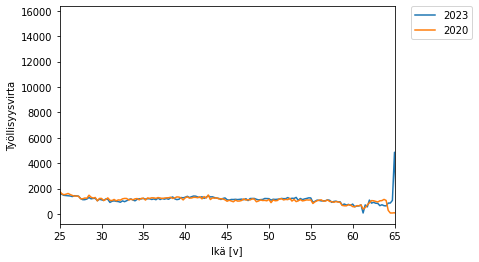

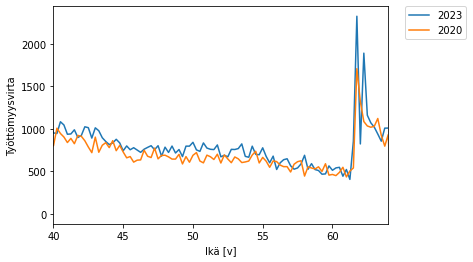

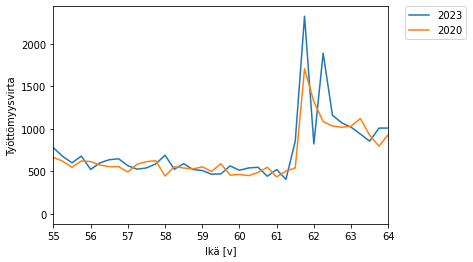

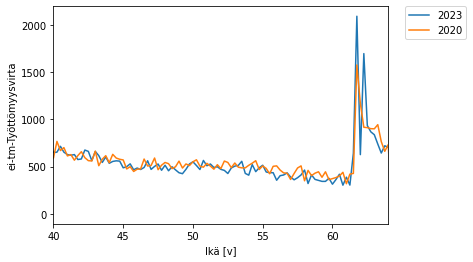

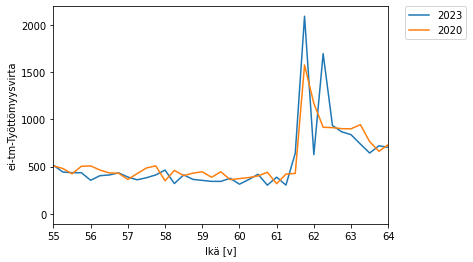

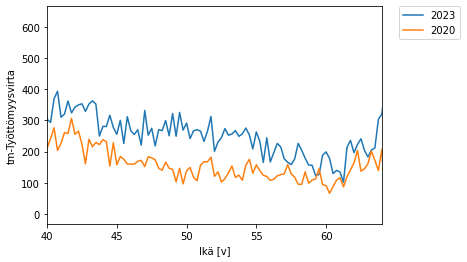

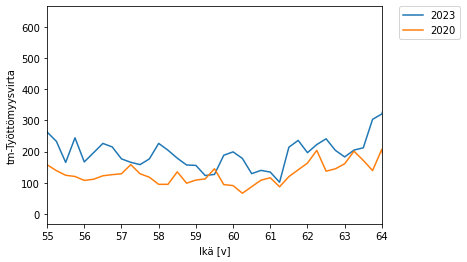

In [40]:
cc2020=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
              plotdebug=plotdebug,year=2020)
cc2020.load_sim(load=results2020)
cc2023.compare_with(cc2020,label1='2023',label2='2020',figname='vuosivertailu')
del cc2020
del cc2023

# IRR

Mortality included, not stopped
disability rate from year 2018
student year 2018
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.5
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_malli_res_mort_yesove version 5
Kaikki: aggregate irr tyel reduced -0.0306 % reaalisesti
Kaikki: aggregate irr tyel full 2.2278 % reaalisesti


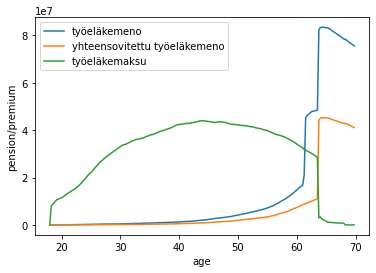

 (Naiset): aggregate irr tyel reduced 0.0414 % reaalisesti
 (Naiset): aggregate irr tyel full 2.5221 % reaalisesti


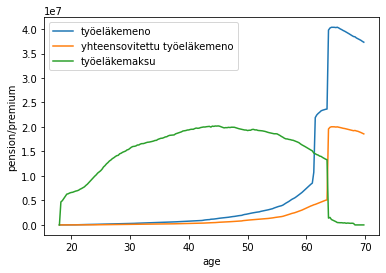

 (Miehet): aggregate irr tyel reduced -0.1326 % reaalisesti
 (Miehet): aggregate irr tyel full 1.9215 % reaalisesti


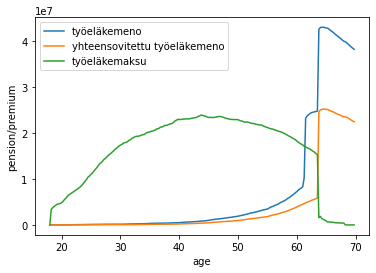


Tyel-irr huomioiden kansan- ja takuueläkkeen yhteensovitus


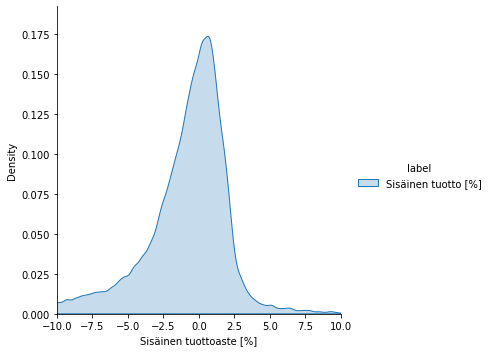

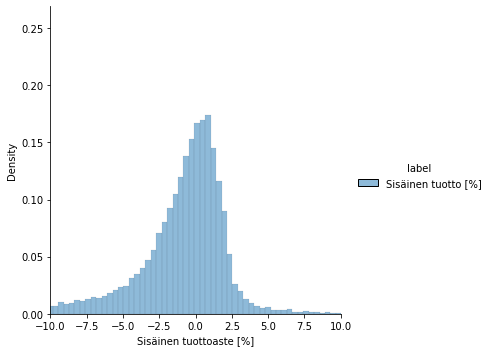

Kaikki havainnot ilman NaNeja:
- Keskimääräinen irr -11.533 % reaalisesti
- Mediaani irr -0.803 % reaalisesti
- Nans 2.515 %
Kaikki havainnot
Osuudet
- irr < -50% 10.34 %:lla
- irr < -10% 15.96 %
- irr < 0% 60.27 %:lla
- irr > 10% 0.95 %

Ilman NaNeja
Osuudet
- irr < -50% 10.61 %:lla
- irr < -10% 16.38 %
- irr < 0% 61.82 %:lla
- irr > 10% 0.98 %

Osuus mikään eläke ei lainkaan maksussa 6.96 %
Osuus työeläkettä ei lainkaan maksussa 8.21 %
Osuus työeläke ei lainkaan maksua maksettu 8.21 %
Osuus työeläke ei vastinetta maksulle 11.68 %
Osuus työeläke ei lainkaan maksua eikä maksettua eläkettä 1.60 %

Osuudet

65v osuus eläke ei maksussa, ei kuollut 0.01 %
65v osuus ei työeläkekarttumaa, ei kuollut 9.17 %
65v osuus kuolleet 10.49 % 
Lopussa osuus kuolleet 15.74 % 

Tyel-irr ILMAN kansan- ja takuueläkkeen yhteensovitusta


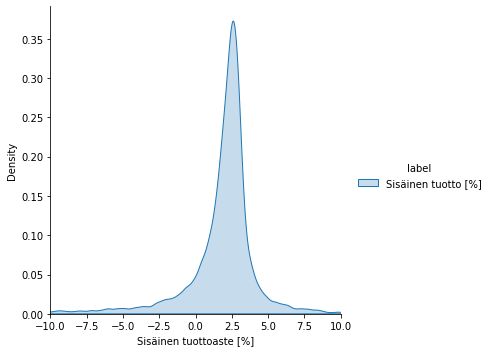

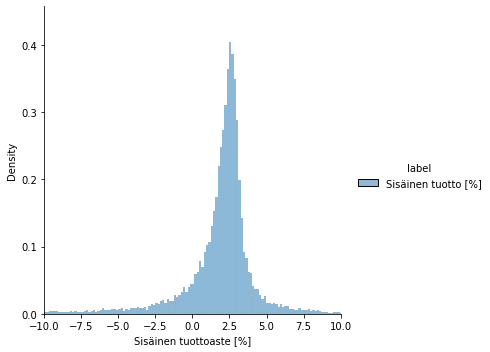

Kaikki havainnot ilman NaNeja:
- Keskimääräinen irr -4.046 % reaalisesti
- Mediaani irr 2.229 % reaalisesti
- Nans 2.59 %
Kaikki havainnot
Osuudet
- irr < -50% 6.93 %:lla
- irr < -10% 8.77 %
- irr < 0% 19.25 %:lla
- irr > 10% 2.65 %

Ilman NaNeja
Osuudet
- irr < -50% 7.12 %:lla
- irr < -10% 9.00 %
- irr < 0% 19.76 %:lla
- irr > 10% 2.72 %

Osuus mikään eläke ei lainkaan maksussa 6.96 %
Osuus työeläkettä ei lainkaan maksussa 8.21 %
Osuus työeläke ei lainkaan maksua maksettu 8.21 %
Osuus työeläke ei vastinetta maksulle 11.68 %
Osuus työeläke ei lainkaan maksua eikä maksettua eläkettä 1.60 %

Osuudet

65v osuus eläke ei maksussa, ei kuollut 0.01 %
65v osuus ei työeläkekarttumaa, ei kuollut 9.17 %
65v osuus kuolleet 10.49 % 
Lopussa osuus kuolleet 15.74 % 

Tyel-irr ILMAN kansan- ja takuueläkkeen yhteensovitusta (Naiset)


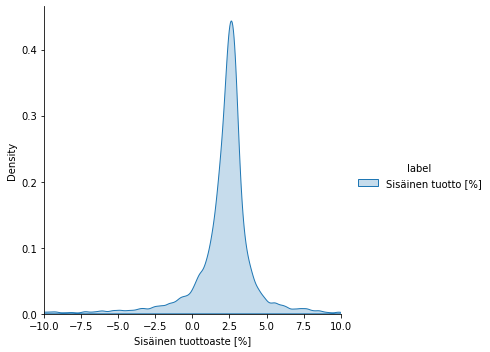

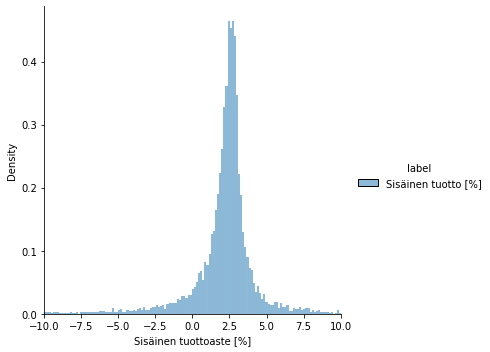

Kaikki havainnot ilman NaNeja:
- Keskimääräinen irr -1.895 % reaalisesti
- Mediaani irr 2.430 % reaalisesti
- Nans 2.59 %
Kaikki havainnot
Osuudet
- irr < -50% 6.93 %:lla
- irr < -10% 8.77 %
- irr < 0% 19.25 %:lla
- irr > 10% 2.65 %

Ilman NaNeja
Osuudet
- irr < -50% 4.95 %:lla
- irr < -10% 6.19 %
- irr < 0% 14.01 %:lla
- irr > 10% 2.28 %

Osuus mikään eläke ei lainkaan maksussa 6.96 %
Osuus työeläkettä ei lainkaan maksussa 8.21 %
Osuus työeläke ei lainkaan maksua maksettu 8.21 %
Osuus työeläke ei vastinetta maksulle 11.68 %
Osuus työeläke ei lainkaan maksua eikä maksettua eläkettä 1.60 %

Osuudet

65v osuus eläke ei maksussa, ei kuollut 0.01 %
65v osuus ei työeläkekarttumaa, ei kuollut 9.17 %
65v osuus kuolleet 10.49 % 
Lopussa osuus kuolleet 15.74 % 

Tyel-irr ILMAN kansan- ja takuueläkkeen yhteensovitusta (Miehet)


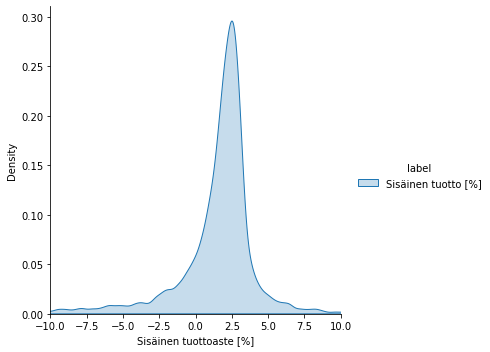

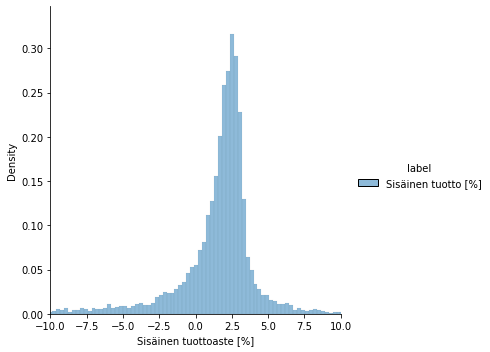

Kaikki havainnot ilman NaNeja:
- Keskimääräinen irr -6.246 % reaalisesti
- Mediaani irr 1.935 % reaalisesti
- Nans 2.59 %
Kaikki havainnot
Osuudet
- irr < -50% 6.93 %:lla
- irr < -10% 8.77 %
- irr < 0% 19.25 %:lla
- irr > 10% 2.65 %

Ilman NaNeja
Osuudet
- irr < -50% 9.34 %:lla
- irr < -10% 11.87 %
- irr < 0% 25.64 %:lla
- irr > 10% 3.16 %

Osuus mikään eläke ei lainkaan maksussa 6.96 %
Osuus työeläkettä ei lainkaan maksussa 8.21 %
Osuus työeläke ei lainkaan maksua maksettu 8.21 %
Osuus työeläke ei vastinetta maksulle 11.68 %
Osuus työeläke ei lainkaan maksua eikä maksettua eläkettä 1.60 %

Osuudet

65v osuus eläke ei maksussa, ei kuollut 0.01 %
65v osuus ei työeläkekarttumaa, ei kuollut 9.17 %
65v osuus kuolleet 10.49 % 
Lopussa osuus kuolleet 15.74 % 

Tyel-irr huomioiden kansan- ja takuueläkkeen yhteensovitus (Naiset)


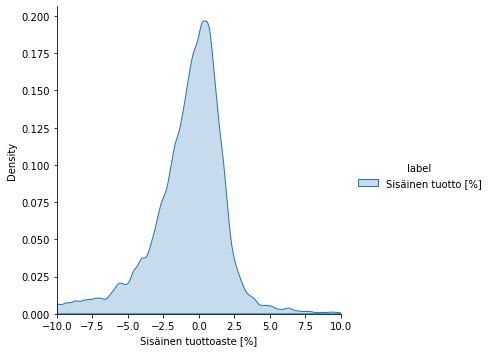

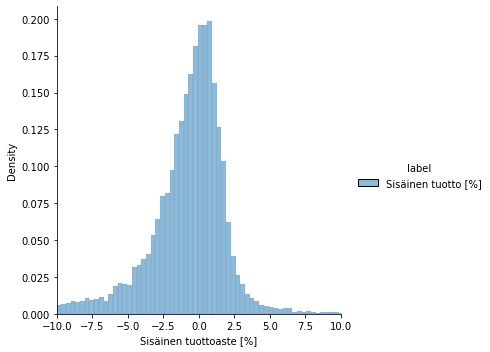

Kaikki havainnot ilman NaNeja:
- Keskimääräinen irr -7.479 % reaalisesti
- Mediaani irr -0.572 % reaalisesti
- Nans 2.515 %
Kaikki havainnot
Osuudet
- irr < -50% 10.34 %:lla
- irr < -10% 15.96 %
- irr < 0% 60.27 %:lla
- irr > 10% 0.95 %

Ilman NaNeja
Osuudet
- irr < -50% 6.79 %:lla
- irr < -10% 10.78 %
- irr < 0% 60.15 %:lla
- irr > 10% 1.11 %

Osuus mikään eläke ei lainkaan maksussa 6.96 %
Osuus työeläkettä ei lainkaan maksussa 8.21 %
Osuus työeläke ei lainkaan maksua maksettu 8.21 %
Osuus työeläke ei vastinetta maksulle 11.68 %
Osuus työeläke ei lainkaan maksua eikä maksettua eläkettä 1.60 %

Osuudet

65v osuus eläke ei maksussa, ei kuollut 0.01 %
65v osuus ei työeläkekarttumaa, ei kuollut 9.17 %
65v osuus kuolleet 10.49 % 
Lopussa osuus kuolleet 15.74 % 

Tyel-irr huomioiden kansan- ja takuueläkkeen yhteensovitus (Miehet)


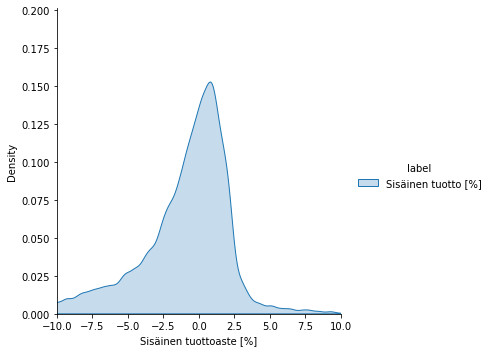

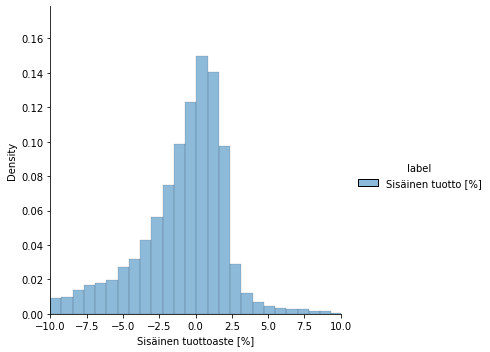

Kaikki havainnot ilman NaNeja:
- Keskimääräinen irr -15.693 % reaalisesti
- Mediaani irr -1.152 % reaalisesti
- Nans 2.515 %
Kaikki havainnot
Osuudet
- irr < -50% 10.34 %:lla
- irr < -10% 15.96 %
- irr < 0% 60.27 %:lla
- irr > 10% 0.95 %

Ilman NaNeja
Osuudet
- irr < -50% 14.53 %:lla
- irr < -10% 22.12 %
- irr < 0% 63.55 %:lla
- irr > 10% 0.84 %

Osuus mikään eläke ei lainkaan maksussa 6.96 %
Osuus työeläkettä ei lainkaan maksussa 8.21 %
Osuus työeläke ei lainkaan maksua maksettu 8.21 %
Osuus työeläke ei vastinetta maksulle 11.68 %
Osuus työeläke ei lainkaan maksua eikä maksettua eläkettä 1.60 %

Osuudet

65v osuus eläke ei maksussa, ei kuollut 0.01 %
65v osuus ei työeläkekarttumaa, ei kuollut 9.17 %
65v osuus kuolleet 10.49 % 
Lopussa osuus kuolleet 15.74 % 


In [41]:
cc1=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
              plotdebug=plotdebug)
cc1.load_sim(results2018)
cc1.plotstats.plot_irr(figname='kela')

In [42]:
#cc1=Lifecycle(env='unemployment-v2',minimal=False,mortality=mortality,perustulo=False,
#              randomness=randomness,pinkslip=pinkslip,plotdebug=plotdebug)
#cc1.env.test_comp_npv()

# Ulkoiset intensiteetit

In [43]:
cc1=Lifecycle(env=model,minimal=False,mortality=mortality,perustulo=False,
              plotdebug=plotdebug)
cc1.load_sim(results2018)
cc1.episodestats.get_muut(show=True,csv='muut2018.csv')
cc1.load_sim(results2019)
cc1.episodestats.get_muut(show=True,csv='muut2019.csv')
cc1.load_sim(results2020)
cc1.episodestats.get_muut(show=True,csv='muut2020.csv')
cc1.load_sim(results2021)
cc1.episodestats.get_muut(show=True,csv='muut2021.csv')
cc1.load_sim(results2022)
cc1.episodestats.get_muut(show=True,csv='muut2022.csv')
cc1.load_sim(results2023)
cc1.episodestats.get_muut(show=True,csv='muut2023.csv')

Mortality included, not stopped
disability rate from year 2018
student year 2018
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 63.5
max_retirementage 68
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_malli_res_mort_yesove version 5
muut_m=[0.4628314157078539,0.49874862348583443,0.6139278557114228,0.6355889724310777,0.6631209232313096,0.7146872803935348,0.7709777911767661,0.808005632102987,0.8278985507246377,0.8482223788901199,0.862472272635612,0.8687317122389264,0.8699868673603395,0.8848448084116874,0.8796924010927856,0.8805592138587782,0.88936213365784

muut_m=[0.42952885865759727,0.48843728100911005,0.5667935109152814,0.5897024942402084,0.6309667067789811,0.6976417461113898,0.7454289732770746,0.7894842666130492,0.8187122736418511,0.8261657770168194,0.8522440746343923,0.8602844749319076,0.8651458564651257,0.8710459828196059,0.8828291004755641,0.8854768419985811,0.8857780482856563,0.8877271343010862,0.8935975609756097,0.8976393976393976,0.9026278264412304,0.8984605974105413,0.9020008166598612,0.9045770331017573,0.9077049012585695,0.9171536962985748,0.908922697368421,0.9028135628156241,0.904368480842714,0.9049441456350849,0.8992634090673306,0.8968030823700927,0.890073145245559,0.8900073398343294,0.8823839107086449,0.8730309757902527,0.8684294361261549,0.8601130184454633,0.8495015542930646,0.8339618575584528,0.8186545336366591,0.7981451172940535,0.7754428429970294,0.7504721697589157,0.7255254580195571,0.7096186681844052,0.639225181598063,0.47171575502571295,0.42222749940631676,0.3779736746769714,0.3384558642734202,0.0,]
muut_n=[0.5449724

muut_m=[0.44244424442444247,0.5045550105115627,0.5785571142284569,0.5915747241725176,0.6349764079911655,0.6953768844221105,0.7518358314052912,0.7874974833903765,0.8151582342269704,0.8322906155398587,0.8510401939002222,0.8684928737491155,0.8746458923512748,0.8703403565640194,0.8827942816587245,0.8836005682971382,0.8828966077594962,0.8868557487038732,0.8940936863543788,0.8979404567699837,0.9,0.8946346448645887,0.9004501739308369,0.9061763802110007,0.9079339012624449,0.9128152341739578,0.9101981833195706,0.9040430152000827,0.9064636420136731,0.9042475854190466,0.8976279650436954,0.8973288814691152,0.8914249816773113,0.8853268866932941,0.8825393472060843,0.8788714467543487,0.8658991578722951,0.8610129564193169,0.8494669968773555,0.8293290043290044,0.8125068209101822,0.7964611495768765,0.7718694493783304,0.7457589034939894,0.7293744333635539,0.707163323782235,0.06767266395821242,0.0,0.0,0.0,0.0,0.0,]
muut_n=[0.5542325395237142,0.5721721721721722,0.5800961153384061,0.5958533653846154,0.63608

(array([[       nan],
        [0.43867547],
        [0.49814796],
        [0.58733974],
        [0.60212467],
        [0.64216227],
        [0.69419083],
        [0.74686087],
        [0.79814945],
        [0.82588117],
        [0.83464487],
        [0.85457483],
        [0.87388844],
        [0.88076456],
        [0.88565068],
        [0.88959789],
        [0.89240442],
        [0.89321965],
        [0.89622258],
        [0.89855662],
        [0.90311419],
        [0.90395193],
        [0.90770957],
        [0.90884034],
        [0.90563337],
        [0.91036673],
        [0.91411547],
        [0.91125296],
        [0.90329239],
        [0.90341262],
        [0.90352332],
        [0.89924172],
        [0.89679567],
        [0.88965445],
        [0.88833019],
        [0.88433228],
        [0.87555415],
        [0.87161229],
        [0.86440316],
        [0.85226541],
        [0.83923177],
        [0.82350386],
        [0.79962772],
        [0.78195489],
        [0.74742614],
        [0

# tarkkuus

In [44]:
for r in all_results:
    cc1=Lifecycle(env=model,silent=True)
    total,initial=cc1.render_reward(load=r)
    print(f'{r}: discounted reward {total} initial reward {initial}')
    del cc1

results/v5_malli_res_mort_yesove: discounted reward 13.478871985050107 initial reward 11.088790940307772
results/v5_perus_2019: discounted reward 13.536884127479976 initial reward 11.109304660339067
results/v5_perus_2020: discounted reward 13.544350451081105 initial reward 11.047527641571422
results/v5_perus_2021: discounted reward 13.57151679021991 initial reward 11.062337956384933
results/v5_perus_2022: discounted reward 13.523659779339413 initial reward 11.071354677734742
results/v5_perus_2023: discounted reward 13.438487695000061 initial reward 11.049693593417198


# palkkasummatesti

In [45]:
cc2023=Lifecycle(env=model,mortality=mortality,perustulo=False,include_putki=True,library=library,
                 plotdebug=plotdebug,year=2023,include_ove=include_ove,unemp_limit_reemp=unemp_limit_reemp,
                 silent=False,include_emtr=include_emtr)
cc2023.load_sim(results2018)

Mortality included, not stopped
disability rate from year 2023
student year 2023
Parameters of life cycle:
timestep 0.25
gamma 0.9793703613355593 (0.9200000000000003 per anno)
min_age 18
max_age 70
min_retirementage 64.75
max_retirementage 69
ansiopvraha_kesto300 300
ansiopvraha_kesto400 400
ansiopvraha_kesto500 500
ansiopvraha_toe 0.5
perustulo False
karenssi_kesto 0.25
mortality True
randomness True
include_putki True
include_pinkslip True
perustulo False
sigma_reduction True
plotdebug False
additional_tyel_premium 0.0
scale_tyel_accrual False
include_ove True
unemp_limit_reemp True
min_salary 17400

Loading results from results/v5_malli_res_mort_yesove version 5


In [46]:
15.6/2.1

7.428571428571428

In [47]:
24.64*25*12/0.7

10560.0